In [ ]:
# === Main Imports ===
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import json
from pathlib import Path
import os

# === Access project root from any notebook location ===
while not (Path.cwd() / "data").exists():
    os.chdir("..")
BASE_DIR = Path.cwd()

# === Useful directories ===
DATA_DIR = BASE_DIR / "data"
TRANSFORMED_DIR = DATA_DIR / "transformed_data"
MODIFIED_DIR = DATA_DIR / "modified_data"
MODELS_DIR = BASE_DIR / "models" / "Quantile" / "lightgbm_quantile"

# === Frequency to analyze ===
FREQ = "daily"
suffix = "withlags"

# === Load transformed training file ===
df = pd.read_csv(TRANSFORMED_DIR / f"train_{FREQ}_lightgbm_quantile_{suffix}.csv")
df_raw = pd.read_csv(MODIFIED_DIR / f"train_{FREQ}.csv")
df_raw["date"] = pd.to_datetime(df_raw["date"])
df["date"] = df_raw["date"]  # Add back date to transformed dataframe

# === Load metrics ===
with open(MODELS_DIR / f"metrics_{FREQ}_{suffix}.json") as f:
    metrics = pd.read_json(f)

# === Load predictions ===
preds_path = MODELS_DIR / f"preds_{FREQ}_rolling_{suffix}.csv"
df_preds = pd.read_csv(preds_path)
df_preds["date"] = pd.to_datetime(df_preds["date"])

# === Load true values for comparison ===
df_test_raw = pd.read_csv(MODIFIED_DIR / f"test_{FREQ}.csv")
df_test_raw["date"] = pd.to_datetime(df_test_raw["date"])

# === Merge predictions with ground truth ===
df_visu = pd.merge(
    df_preds,
    df_test_raw[["date", "insee_region", "conso_elec_mw", "conso_gaz_mw"]],
    on=["date", "insee_region"],
    how="left"
)

# === Quick preview ===
df_visu.head(10)


,date,insee_region,conso_elec_mw_q10,conso_elec_mw_q50,conso_elec_mw_q90,conso_gaz_mw_q10,conso_gaz_mw_q50,conso_gaz_mw_q90,conso_elec_mw,conso_gaz_mw
0,2022-01-23,32,295979.958555,307653.665599,322108.648764,226753.854626,289272.689030,295369.407433,306155.0,303728.0
1,2022-01-23,27,140509.837970,139806.911993,148361.657840,97324.759727,103907.496479,108711.752507,140415.0,103124.0
2,2022-01-23,24,129973.407697,136809.328726,147734.494121,72718.091359,77227.156874,82573.742176,138688.0,77697.0
3,2022-01-23,11,410296.213156,484783.644238,500331.032007,228103.930163,372964.686618,397293.759552,480374.0,406747.0
4,2022-01-23,52,180668.961777,192093.801998,201600.297135,99019.448741,109950.025371,118659.949641,189539.0,115611.0
5,2022-01-24,93,292388.997475,313801.125926,319735.212752,163816.724167,193959.691090,210080.863854,301679.0,179587.0
6,2022-01-24,84,401537.093683,491532.994721,501045.508983,226212.092174,278303.738610,292261.506939,502549.0,286309.0
7,2022-01-24,76,292224.834401,317984.169453,337920.165233,102468.604298,122789.184752,133191.038834,305049.0,114423.0
8,2022-01-24,75,310463.586204,361393.539043,367473.592659,139956.931450,171592.061231,191486.029053,354884.0,170134.0
9,2022-01-24,53,165683.235703,185799.219303,187181.668014,79841.698475,87919.210298,97479.077181,188379.0,107560.0


In [2]:
df_visu.shape

(9929, 10)

In [3]:
df.describe()

,conso_elec_mw,conso_gaz_mw,temperature_2m_max,temperature_2m_min,precipitation_sum,apparent_temperature_max,apparent_temperature_min,rain_sum,snowfall_sum,precipitation_hours,...,apparent_temp_mean,temp_range,wind_range,temp_radiation_interaction,sunrise_sunset_diff,radiation_et0_ratio,sunshine_ratio,sun_week_interaction,delta_temp,date
count,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,...,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,7943.000000,7931.000000,7943
mean,205470.528516,100454.897394,17.236523,9.228428,2.170590,15.446683,7.134546,2.128125,0.029743,4.162659,...,11.290614,8.008095,19.307038,211.093048,44551.952663,5.695806,0.648754,1.952748,-4.010364,2013-11-27 11:00:04.985521920
min,61409.000000,6564.000000,-4.200000,-9.300000,0.000000,-9.900000,-14.500000,0.000000,0.000000,0.000000,...,-11.200000,0.800000,2.500000,-54.943000,28680.000000,0.730755,0.000000,0.000000,-16.150000,2013-01-01 00:00:00
25%,126048.500000,40755.000000,11.700000,4.700000,0.000000,8.700000,1.300000,0.000000,0.000000,0.000000,...,5.250000,5.400000,14.300000,46.107750,34920.000000,4.680273,0.462531,0.460201,-5.400000,2013-06-15 00:00:00
50%,191308.000000,78566.000000,17.300000,9.500000,0.200000,15.400000,7.000000,0.200000,0.000000,1.000000,...,11.100000,7.400000,18.300000,165.170000,45780.000000,5.432666,0.778510,1.737225,-3.900000,2013-11-27 00:00:00
75%,265224.500000,127300.000000,22.600000,13.900000,2.400000,22.000000,13.000000,2.300000,0.000000,7.000000,...,17.350000,10.300000,23.100000,334.951500,53640.000000,6.459812,0.892861,3.226668,-2.500000,2014-05-12 00:00:00
max,614942.000000,586366.000000,38.700000,24.600000,61.900000,40.800000,26.500000,61.900000,9.730000,24.000000,...,31.950000,20.900000,56.300000,804.327000,59340.000000,15.457689,0.930763,5.583459,4.400000,2014-10-24 00:00:00
std,95433.456878,83921.449585,7.457933,6.043770,4.437357,8.947532,7.462690,4.401956,0.298132,5.488201,...,8.016886,3.458362,7.269201,186.125265,9567.129794,1.730393,0.294311,1.663654,2.364583,NaN


In [ ]:
#  Extract temporal features
df_visu["month"] = df_visu["date"].dt.month
df_visu["weekday"] = df_visu["date"].dt.weekday
df_visu["dayofyear"] = df_visu["date"].dt.dayofyear

# Add season information
df_visu["season"] = pd.cut(
    df_visu["month"],
    bins=[0, 3, 6, 9, 12],
    labels=["winter", "spring", "summer", "autumn"],
    include_lowest=True
)

# Preview the added features
df_visu[["date", "month", "weekday", "season"]].head()


,date,month,weekday,season
0,2022-01-23,1,6,hiver
1,2022-01-23,1,6,hiver
2,2022-01-23,1,6,hiver
3,2022-01-23,1,6,hiver
4,2022-01-23,1,6,hiver


C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\2283901193.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=rmse_df, x="Quantile", y="rmse", palette="viridis")


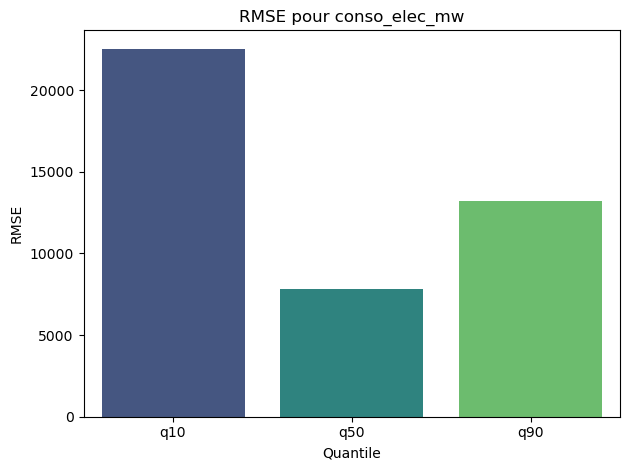

C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\2283901193.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=rmse_df, x="Quantile", y="rmse", palette="viridis")


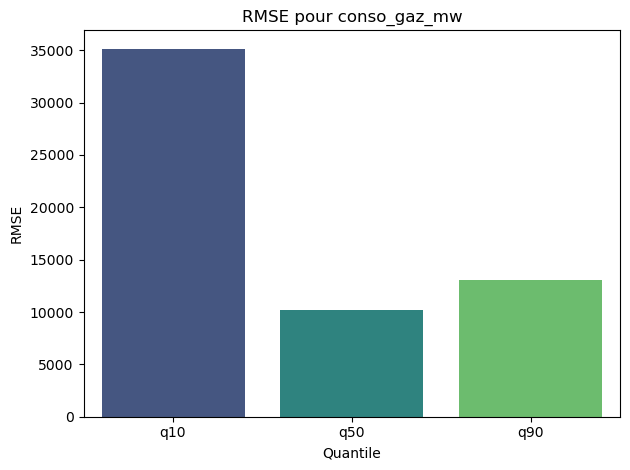

In [ ]:
# Display RMSE barplots by quantile for each target
for target in metrics.columns:
    # Extract RMSE values
    subdict = metrics[target].to_dict()
    rmse_df = pd.DataFrame.from_dict(subdict, orient="index")
    rmse_df["Quantile"] = rmse_df.index

    # Plot
    sns.barplot(data=rmse_df, x="Quantile", y="rmse", palette="viridis")
    plt.title(f"RMSE for {target}")
    plt.ylabel("RMSE")
    plt.xlabel("Quantile")
    plt.tight_layout()
    plt.show()


C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\1421036083.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=season_df, x="season", y="mae", palette="pastel")


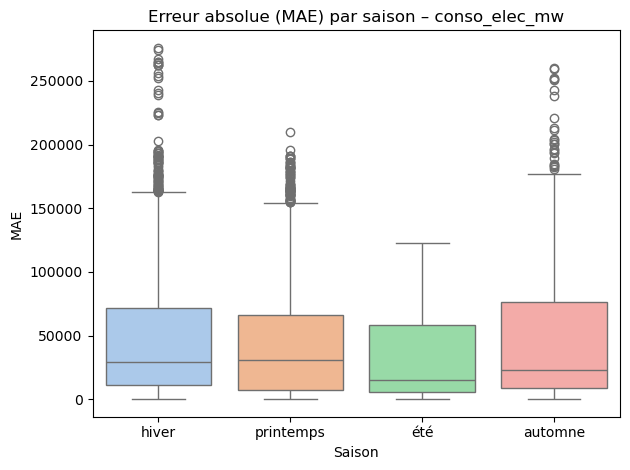

C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\1421036083.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=season_df, x="season", y="mae", palette="pastel")


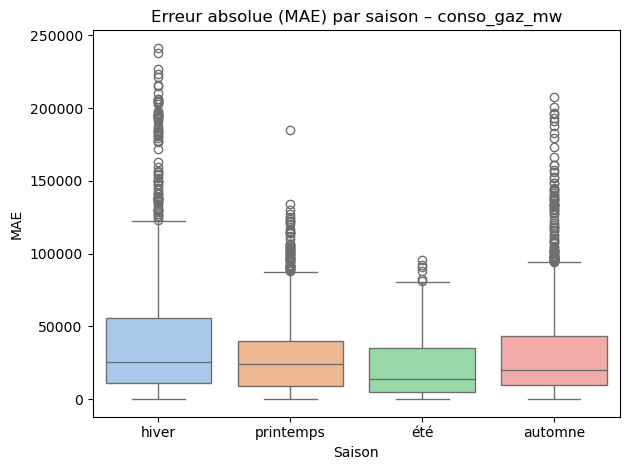

In [ ]:
from data_processing.transformation import transform_lightgbm_quantile

# Load and transform test data
df_raw = pd.read_csv(MODIFIED_DIR / f"test_{FREQ}.csv")
df_raw["date"] = pd.to_datetime(df_raw["date"])
df = transform_lightgbm_quantile(df_raw.copy(), frequency=FREQ, save=False, lags=True)
df["date"] = df_raw["date"]  # to preserve the date

# Add temporal features
df["month"] = df["date"].dt.month
df["season"] = pd.cut(df["month"],
                      bins=[0, 3, 6, 9, 12],
                      labels=["winter", "spring", "summer", "autumn"],
                      include_lowest=True)

# Compute MAE for q50 predictions by season
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    true_vals = df[target].values
    pred_vals = df_visu[f"{target}_q50"].values

    if len(true_vals) != len(pred_vals):
        print(f"Error: mismatched lengths for {target} — true: {len(true_vals)}, pred: {len(pred_vals)}")
        continue

    mae = np.abs(true_vals - pred_vals)
    season_df = pd.DataFrame({"season": df["season"], "mae": mae})

    sns.boxplot(data=season_df, x="season", y="mae", palette="pastel")
    plt.title(f"Mean Absolute Error (MAE) by season – {target}")
    plt.ylabel("MAE")
    plt.xlabel("Season")
    plt.tight_layout()
    plt.show()


In [ ]:
import matplotlib.pyplot as plt

def plot_predictions_split(df, y_true, preds_dict, target, step=10):
    """
    Display 4 subplots:
    - Quantile 10
    - Quantile 50 (median)
    - Quantile 90
    - Prediction interval (q10 to q90) + ground truth
    """

    dates = df["date"].iloc[::step]
    true_values = y_true.iloc[::step]
    q10 = preds_dict["q10"].iloc[::step]
    q50 = preds_dict["q50"].iloc[::step]
    q90 = preds_dict["q90"].iloc[::step]

    fig, axs = plt.subplots(2, 2, figsize=(15, 10))
    fig.suptitle(f"Quantile predictions – {target}", fontsize=16)

    # Soft color for ground truth
    true_color = "#444444"

    axs[0, 0].plot(dates, q10, label="q10", color="blue", alpha=0.6)
    axs[0, 0].plot(dates, true_values, label="Ground truth", linestyle="--", color=true_color, linewidth=1, alpha=0.8)
    axs[0, 0].set_title("Quantile 10")
    axs[0, 0].legend()
    axs[0, 0].grid(alpha=0.3)

    axs[0, 1].plot(dates, q50, label="q50", color="orange", alpha=0.6)
    axs[0, 1].plot(dates, true_values, label="Ground truth", linestyle="--", color=true_color, linewidth=1, alpha=0.8)
    axs[0, 1].set_title("Quantile 50 (median)")
    axs[0, 1].legend()
    axs[0, 1].grid(alpha=0.3)

    axs[1, 0].plot(dates, q90, label="q90", color="green", alpha=0.6)
    axs[1, 0].plot(dates, true_values, label="Ground truth", linestyle="--", color=true_color, linewidth=1, alpha=0.8)
    axs[1, 0].set_title("Quantile 90")
    axs[1, 0].legend()
    axs[1, 0].grid(alpha=0.3)

    axs[1, 1].fill_between(dates, q10, q90, color="gray", alpha=0.3, label="Interval q10–q90")
    axs[1, 1].plot(dates, q50, label="q50", color="orange", linewidth=1.5)
    axs[1, 1].plot(dates, true_values, label="Ground truth", linestyle="--", color=true_color, linewidth=1, alpha=0.8)
    axs[1, 1].set_title("Prediction interval (q10–q90)")
    axs[1, 1].legend()
    axs[1, 1].grid(alpha=0.3)

    for ax in axs.flat:
        ax.set_xlabel("Date")
        ax.set_ylabel("Value")

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


📍 Région 32 – conso_elec_mw


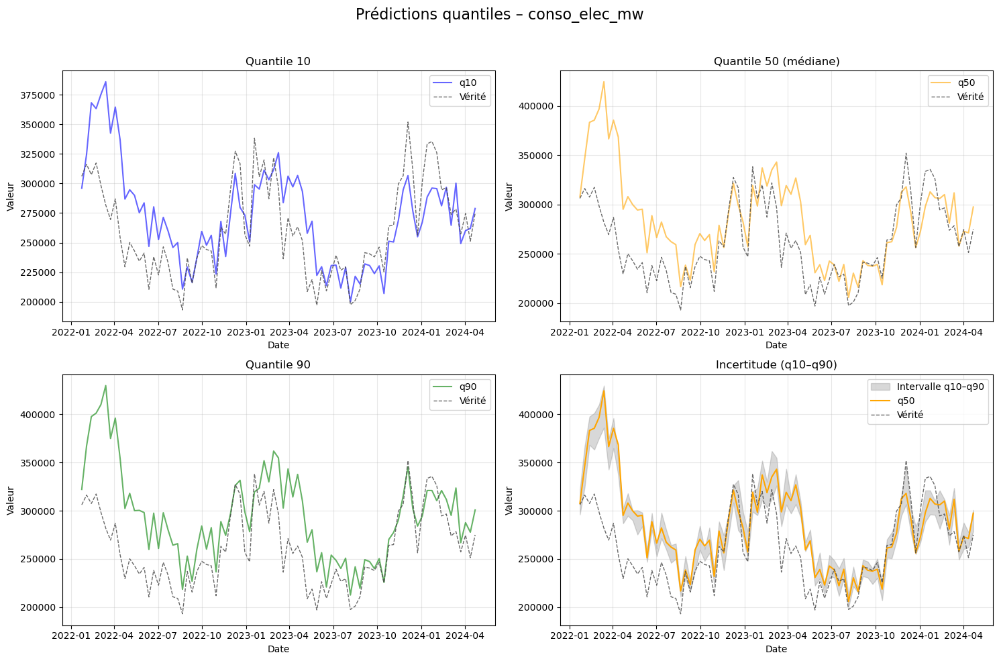

📍 Région 27 – conso_elec_mw


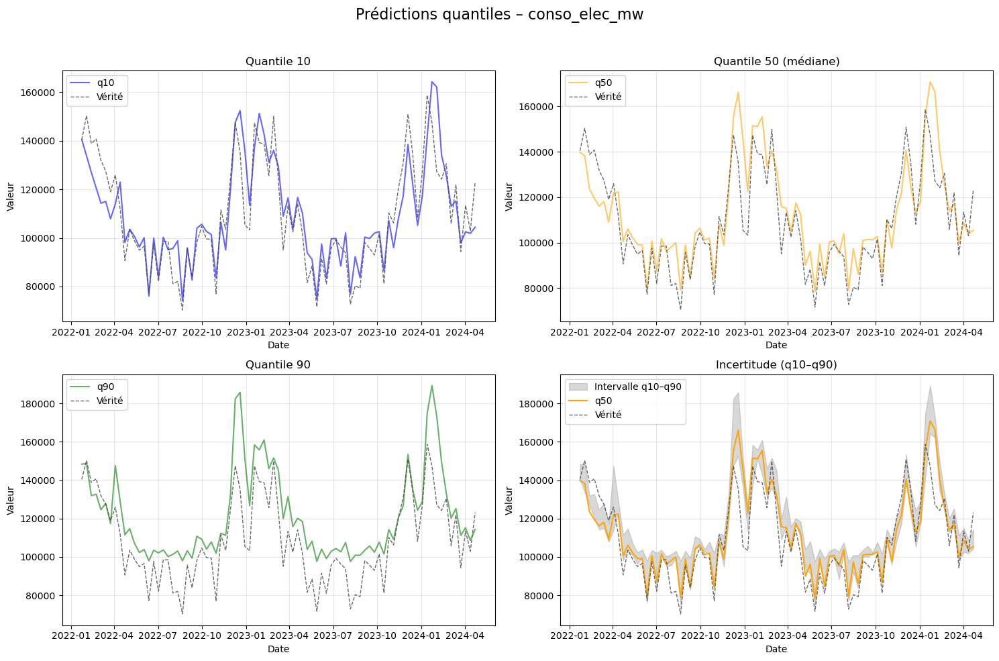

📍 Région 24 – conso_elec_mw


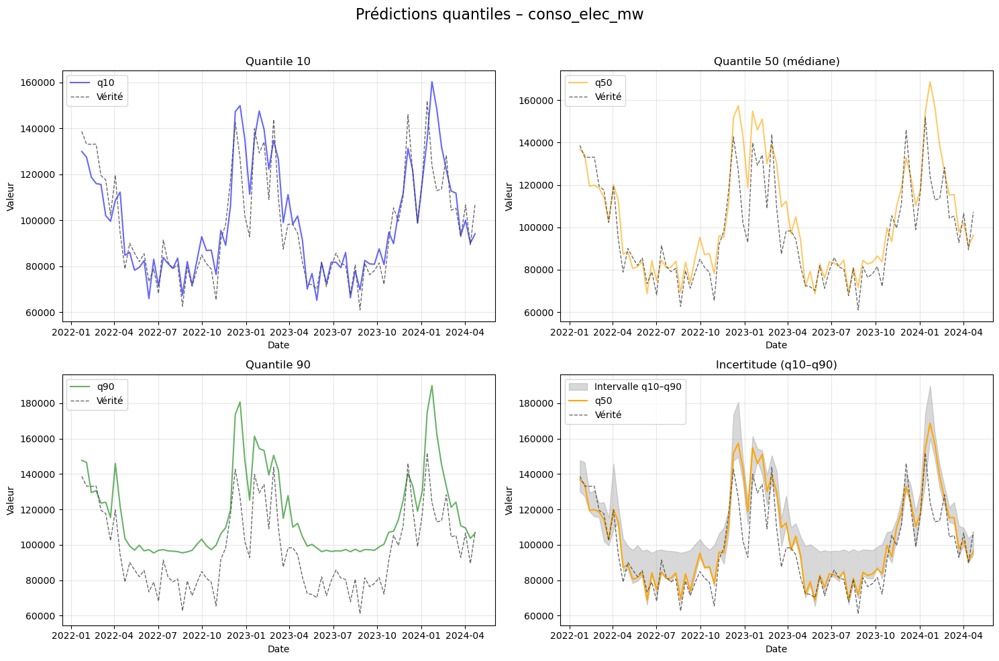

📍 Région 11 – conso_elec_mw


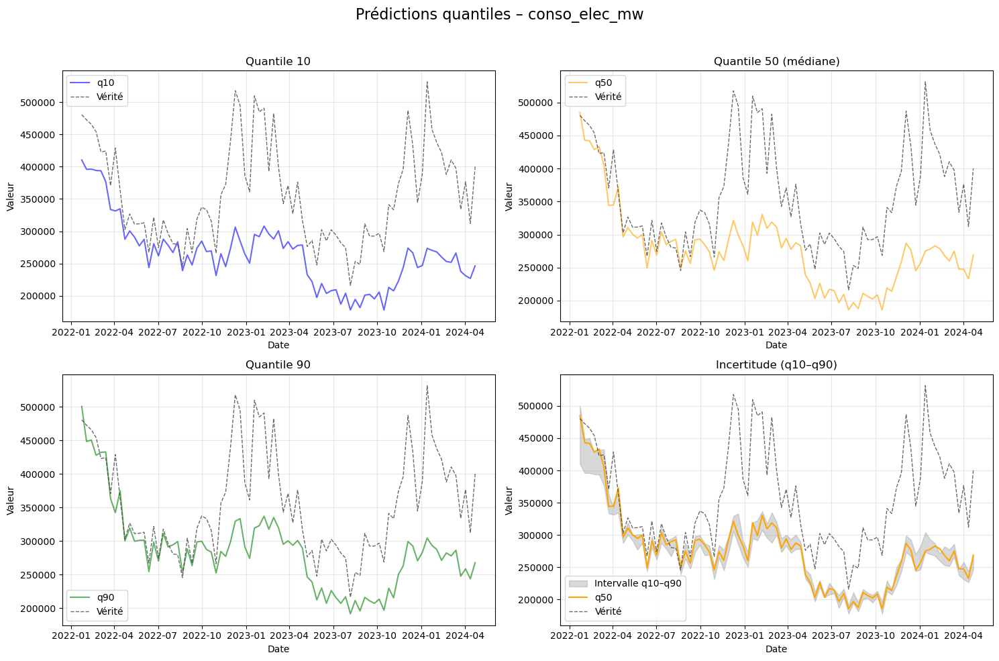

📍 Région 52 – conso_elec_mw


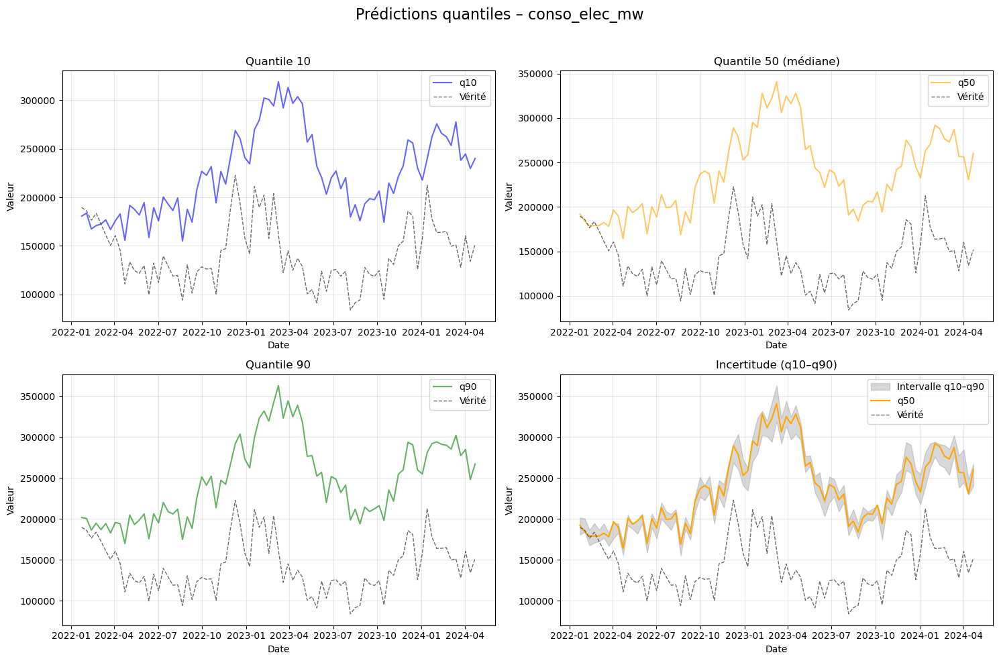

📍 Région 93 – conso_elec_mw


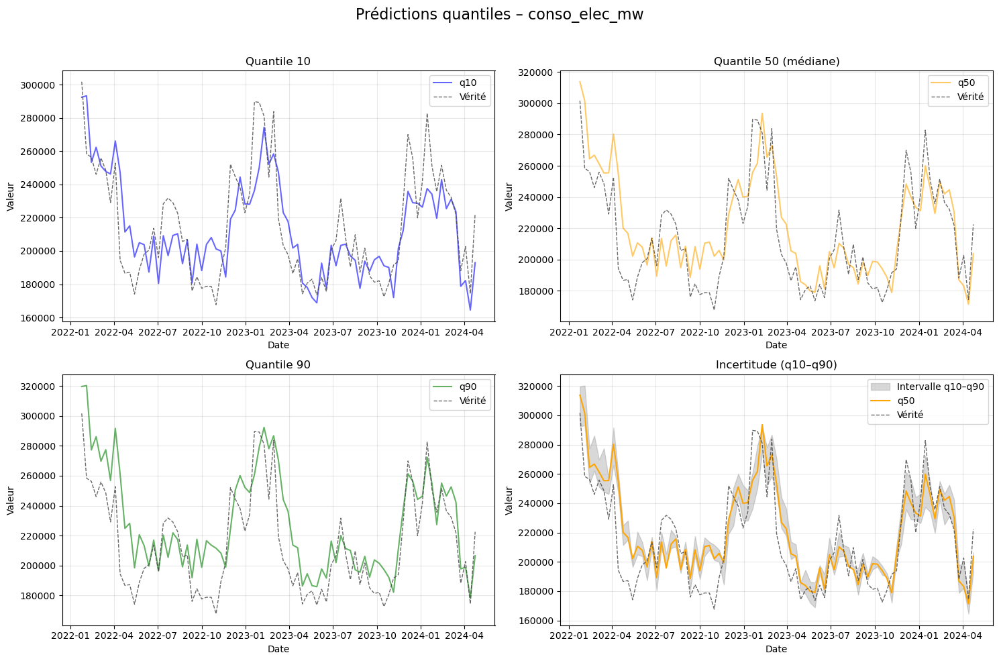

📍 Région 84 – conso_elec_mw


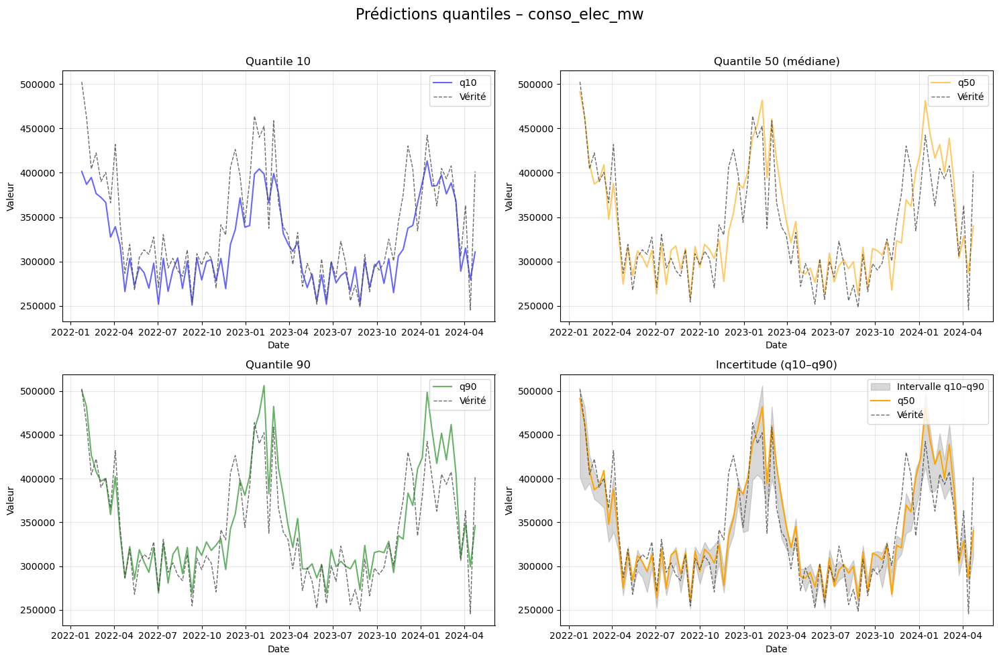

📍 Région 76 – conso_elec_mw


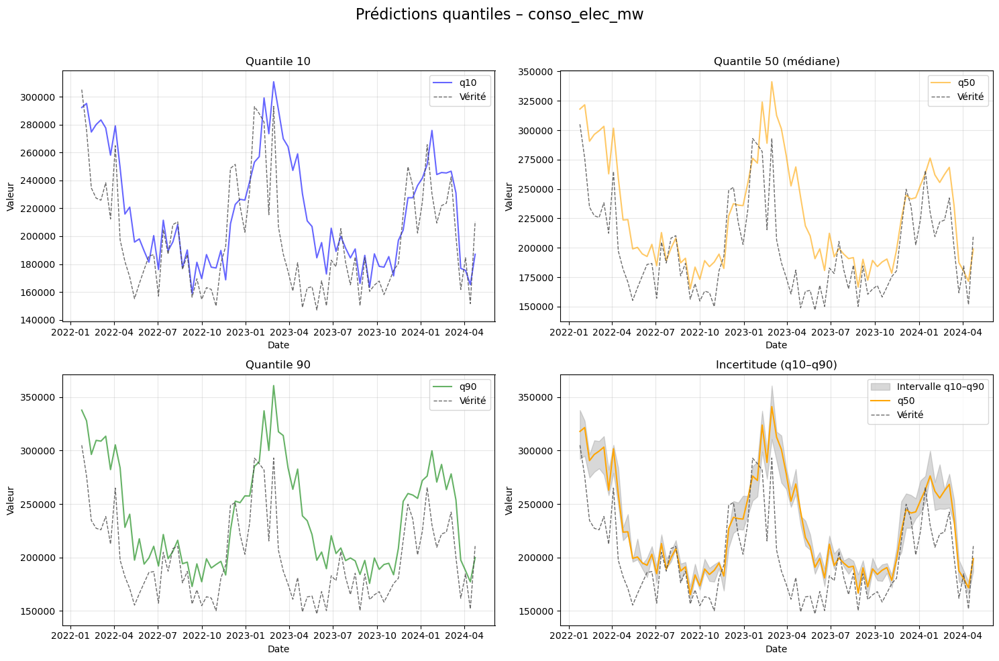

📍 Région 75 – conso_elec_mw


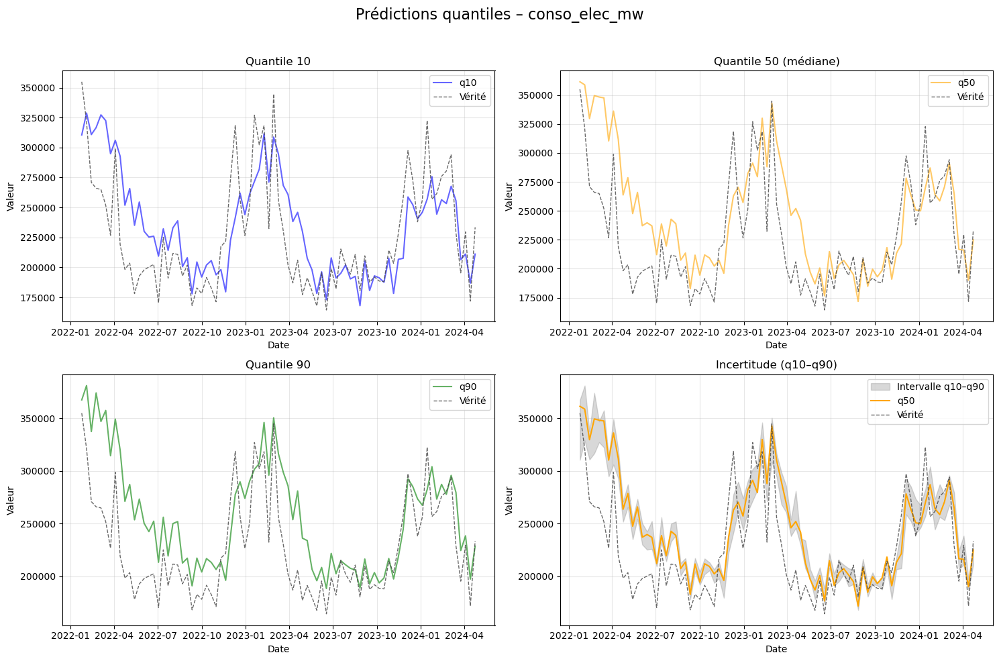

📍 Région 53 – conso_elec_mw


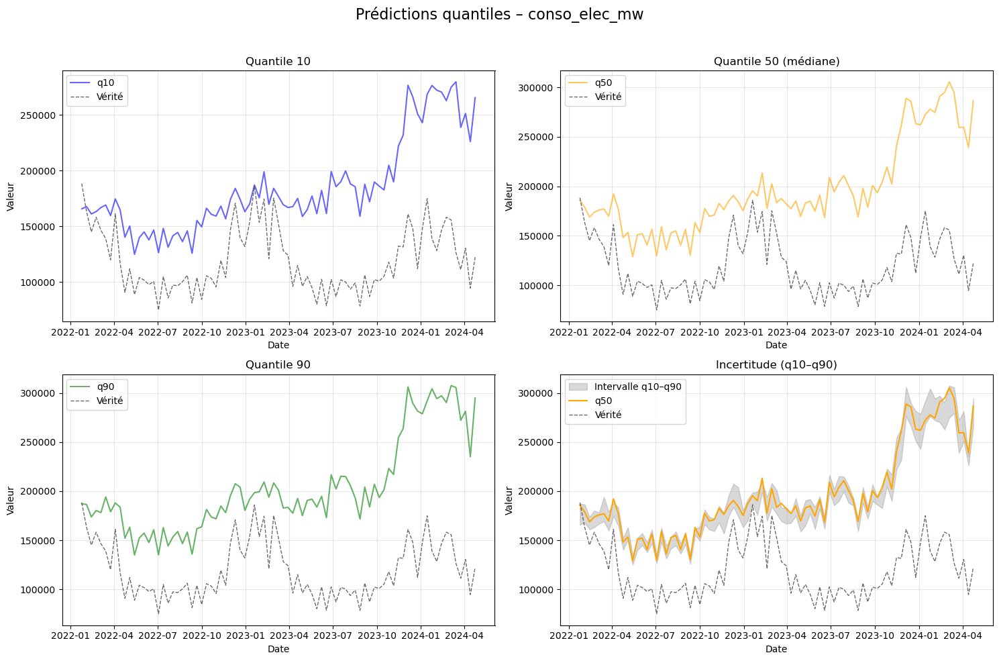

📍 Région 28 – conso_elec_mw


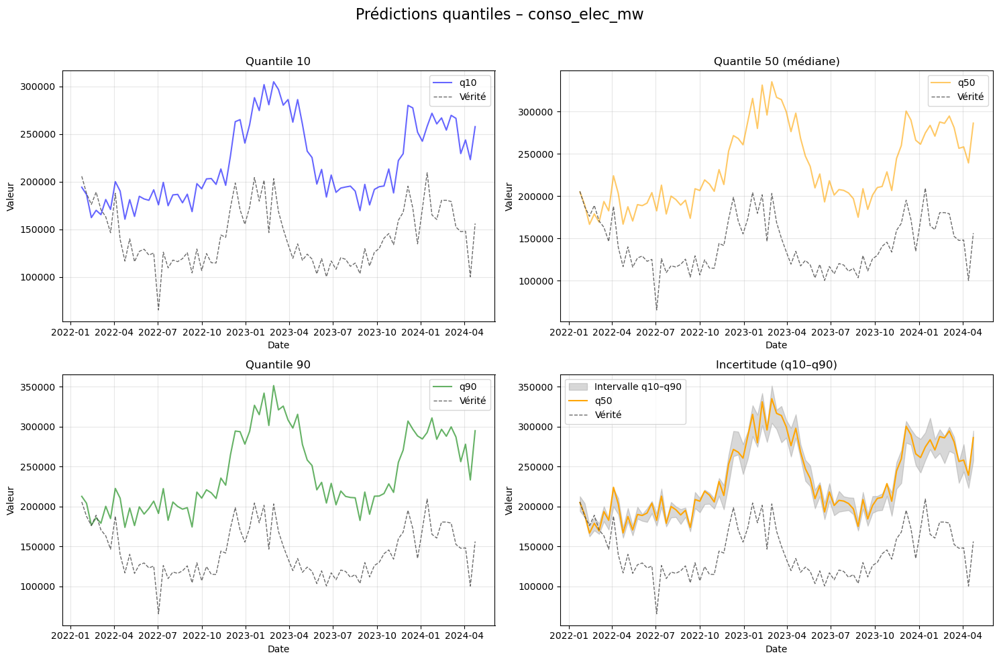

📍 Région 44 – conso_elec_mw


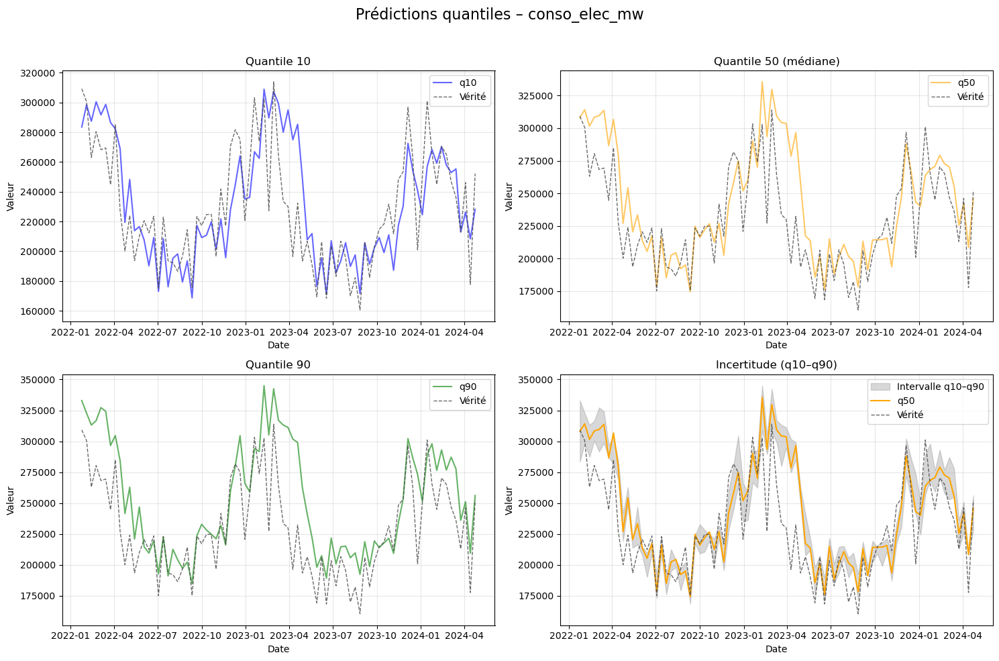

📍 Région 32 – conso_gaz_mw


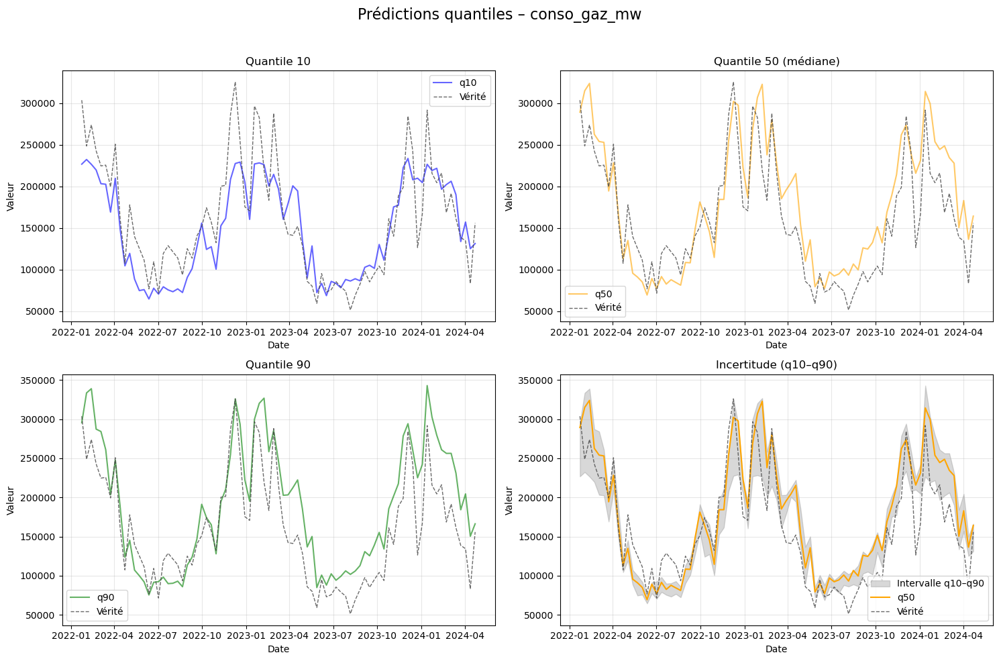

📍 Région 27 – conso_gaz_mw


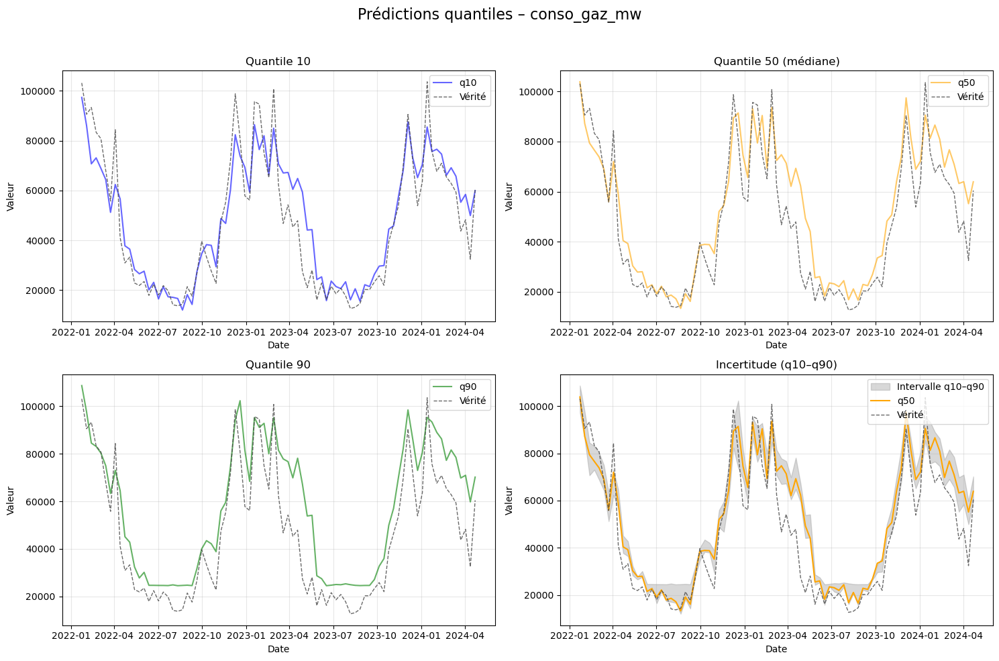

📍 Région 24 – conso_gaz_mw


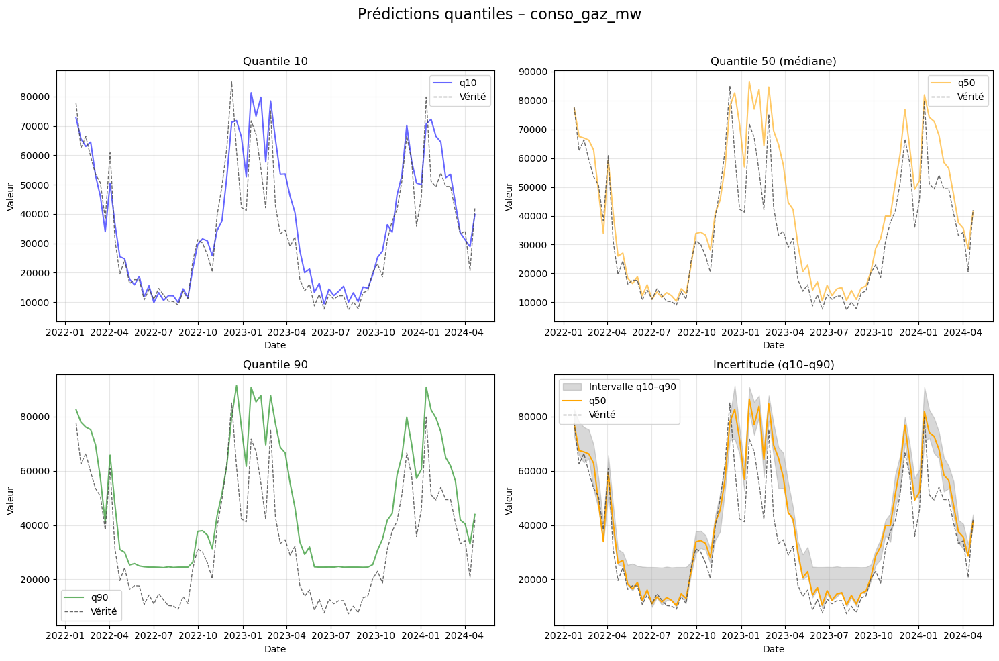

📍 Région 11 – conso_gaz_mw


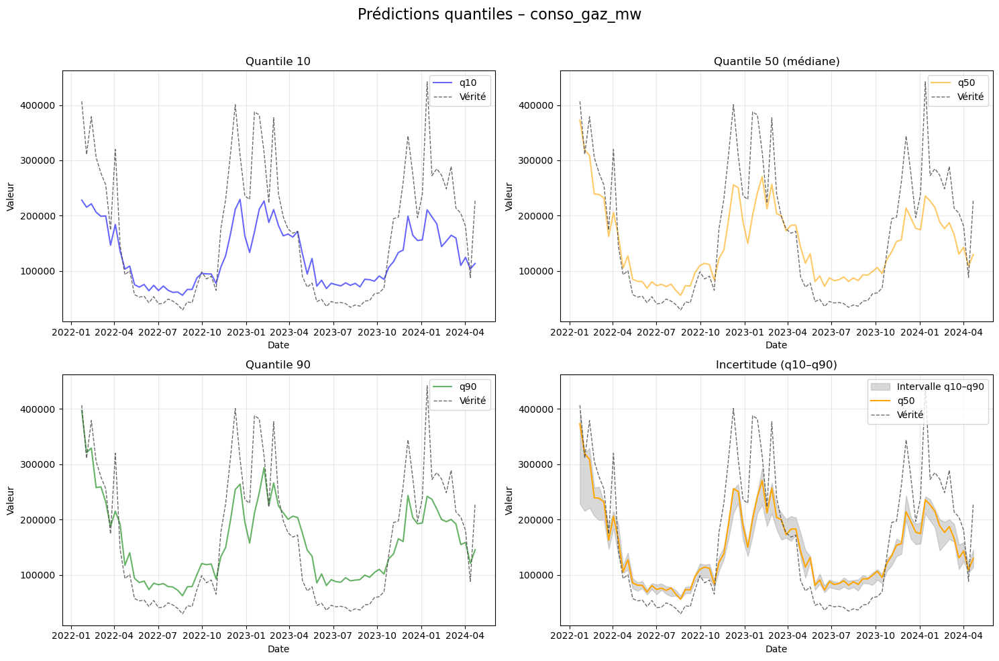

📍 Région 52 – conso_gaz_mw


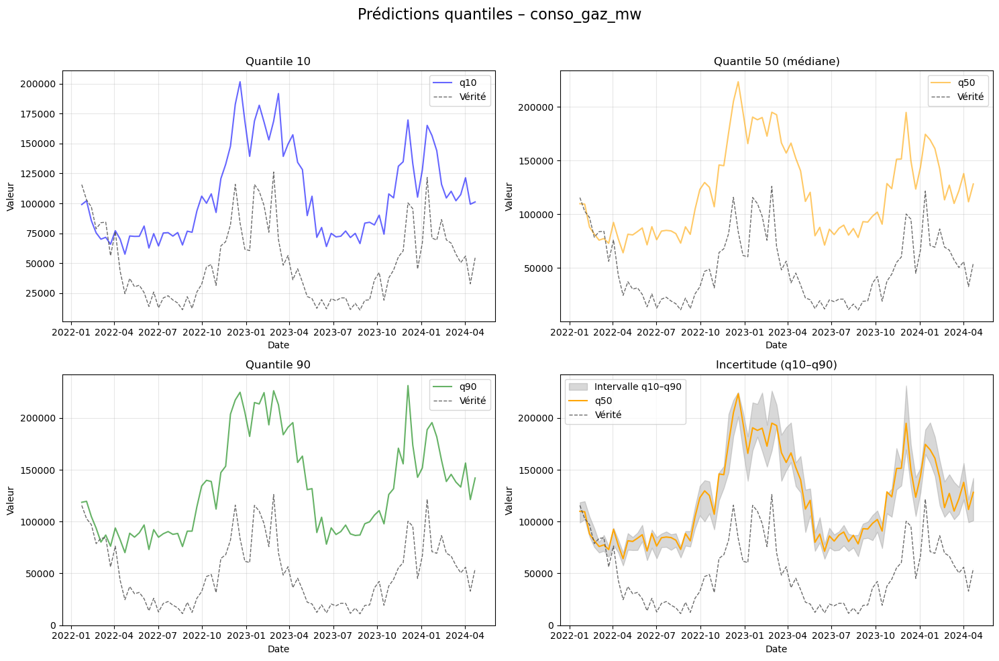

📍 Région 93 – conso_gaz_mw


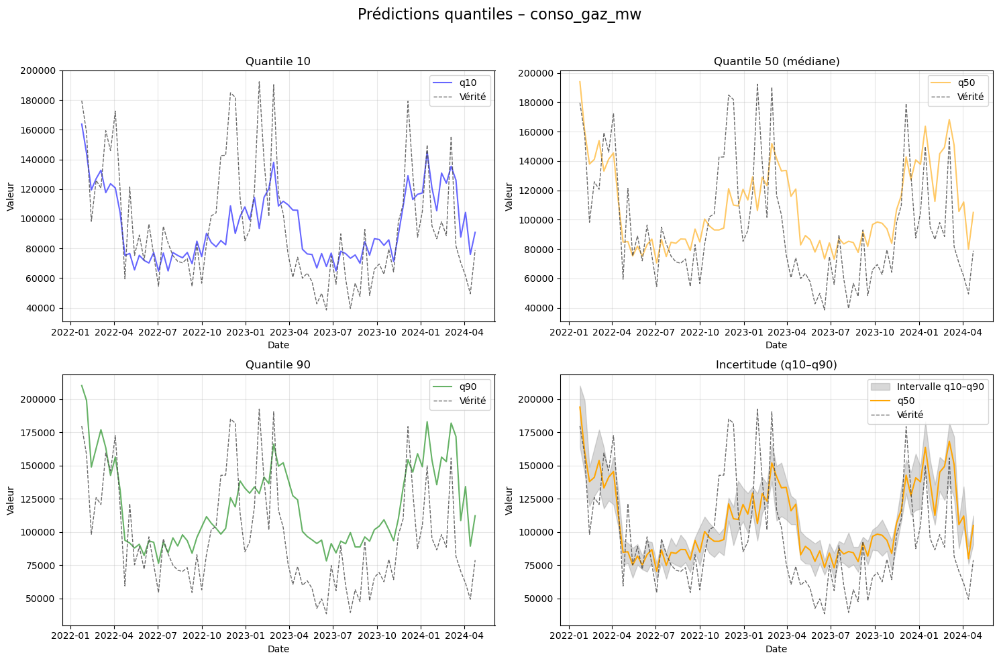

📍 Région 84 – conso_gaz_mw


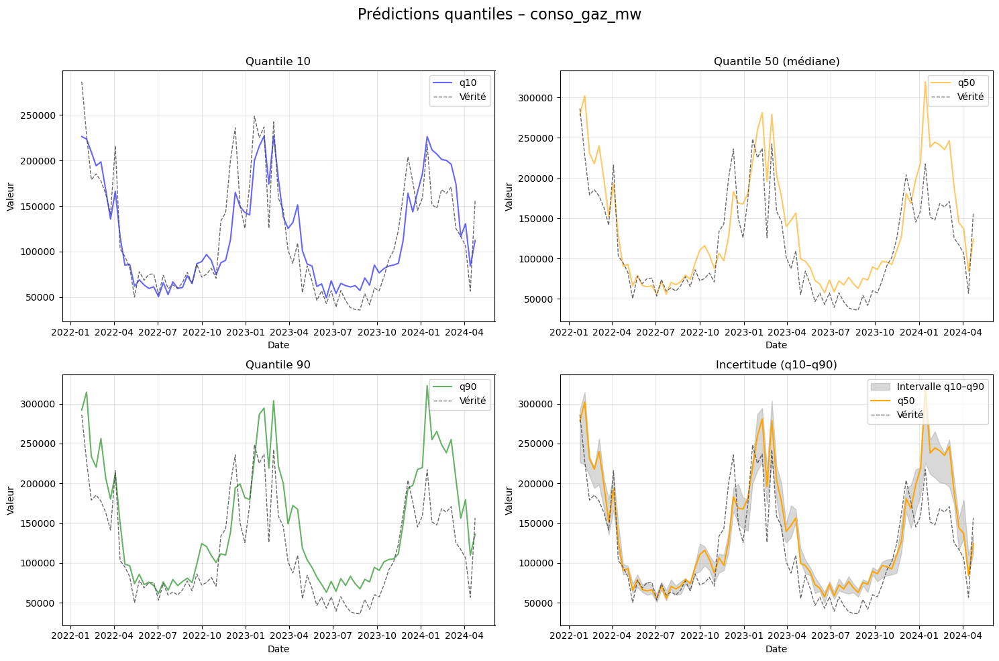

📍 Région 76 – conso_gaz_mw


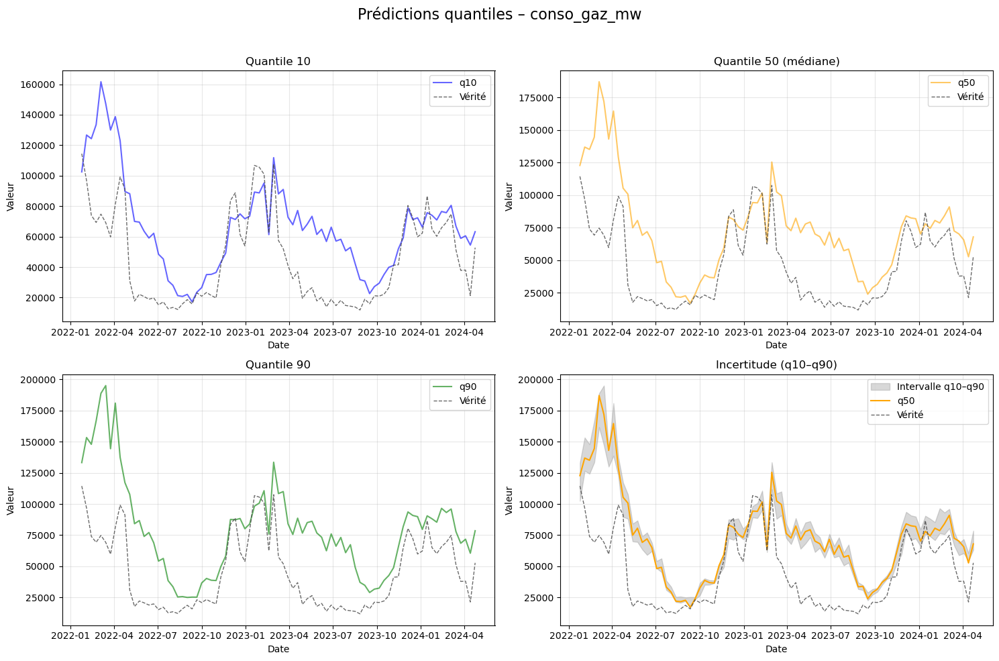

📍 Région 75 – conso_gaz_mw


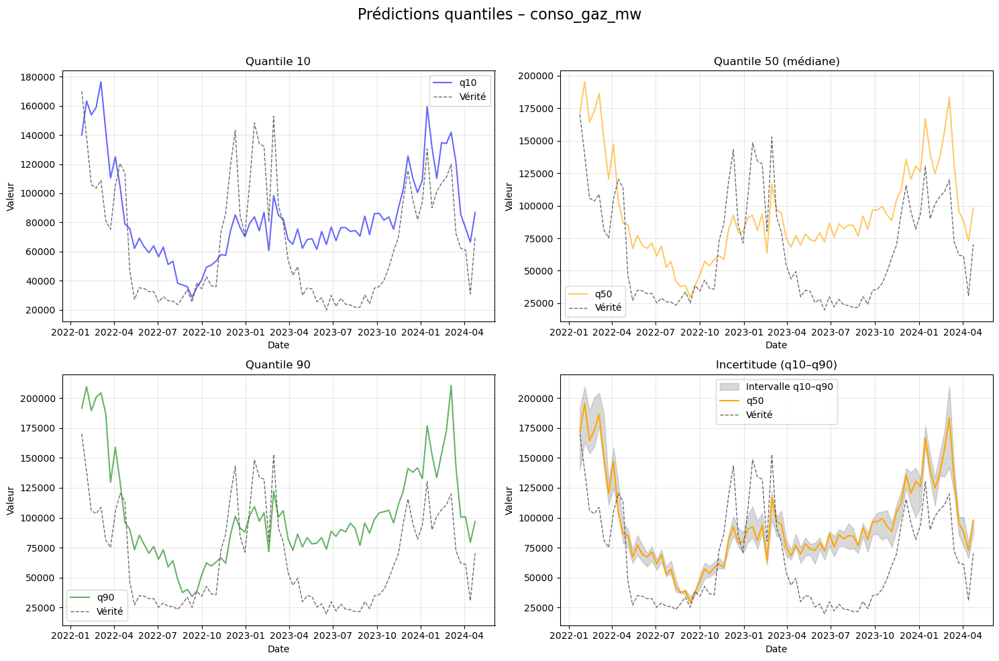

📍 Région 53 – conso_gaz_mw


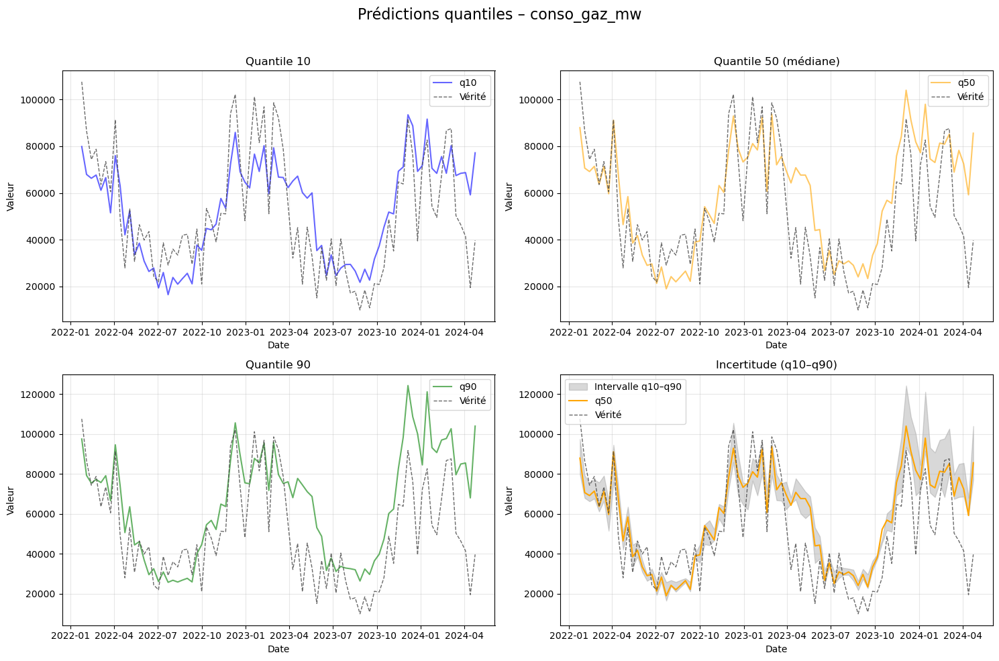

📍 Région 28 – conso_gaz_mw


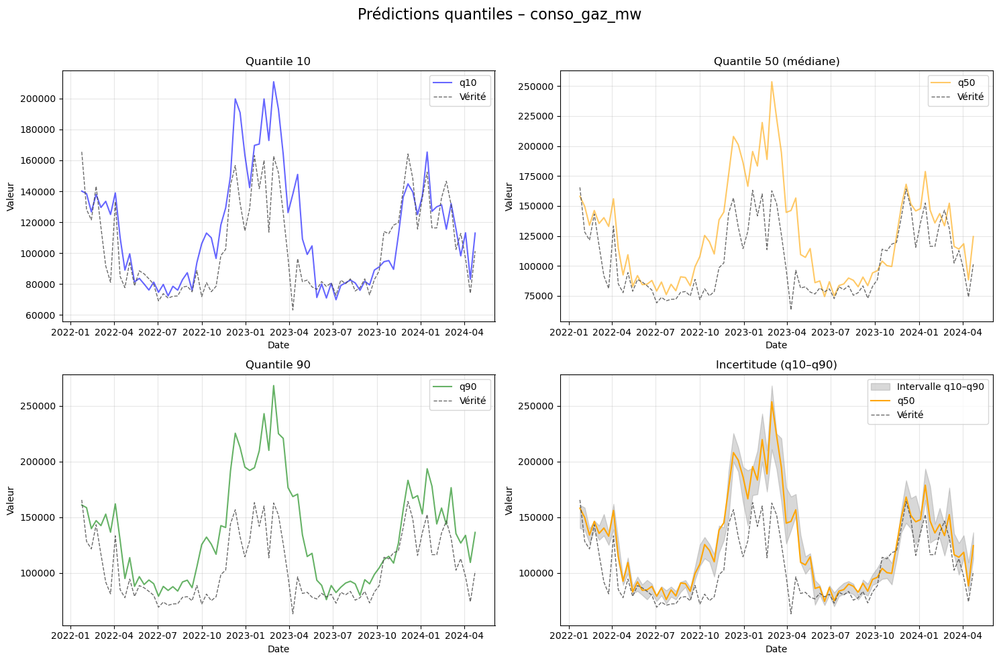

📍 Région 44 – conso_gaz_mw


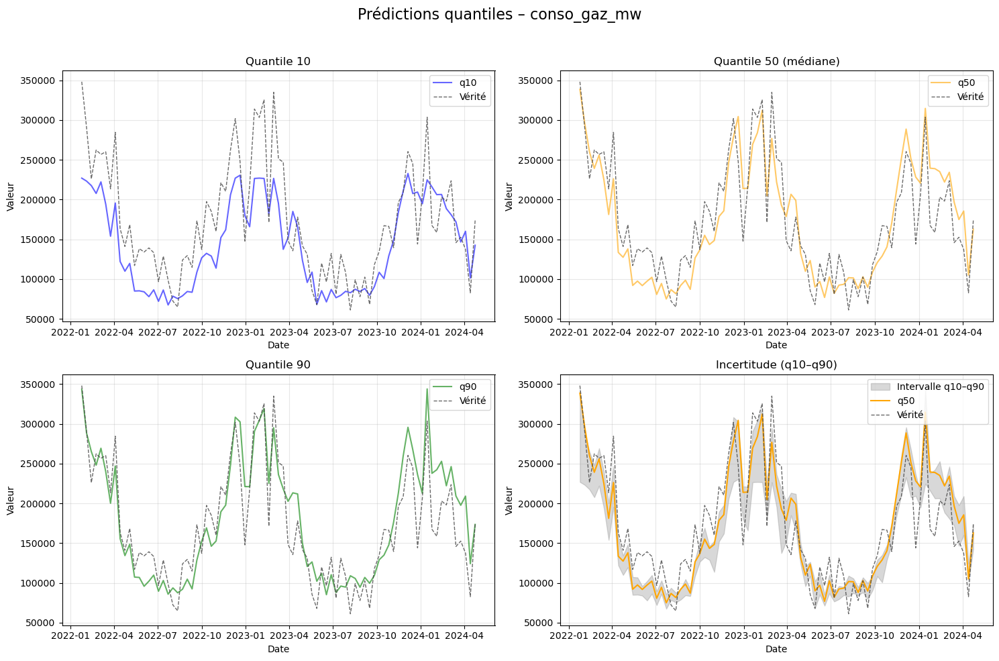

In [ ]:
targets = ["conso_elec_mw", "conso_gaz_mw"]

for target in targets:
    for region in df_visu["insee_region"].unique():
        df_region = df_visu[df_visu["insee_region"] == region].copy()

        y_true = df_region[target]
        preds_region = {
            "q10": df_region[f"{target}_q10"],
            "q50": df_region[f"{target}_q50"],
            "q90": df_region[f"{target}_q90"]
        }

        print(f"Region {region} – {target}")
        plot_predictions_split(df_region, y_true, preds_region, target, step=10)


In [ ]:
from sklearn.metrics import mean_absolute_percentage_error

#  MAPE entre la vérité et la prédiction médiane (q50)
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target].values
        y_pred = df_visu[f"{target}_q50"].values

        mape = mean_absolute_percentage_error(y_true, y_pred)
        print(f" MAPE pour {target} (quantile 50): {mape:.2%}")
    except KeyError as e:
        print(f" Colonne manquante : {e}")


📈 MAPE pour conso_elec_mw (quantile 50): 25.60%
📈 MAPE pour conso_gaz_mw (quantile 50): 57.14%


In [ ]:
#  Analyse de la couverture de l’intervalle [q10–q90]
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target].values
        lower = df_visu[f"{target}_q10"].values
        upper = df_visu[f"{target}_q90"].values

        coverage = np.mean((y_true >= lower) & (y_true <= upper))
        print(f" Couverture (q10–q90) pour {target} : {coverage:.2%}")
    except KeyError as e:
        print(f" Colonne manquante : {e}")


🛡️ Couverture (q10–q90) pour conso_elec_mw : 21.84%
🛡️ Couverture (q10–q90) pour conso_gaz_mw : 21.07%


C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\3804008542.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=weekday_df, x="weekday", y="mae", palette="Set2")


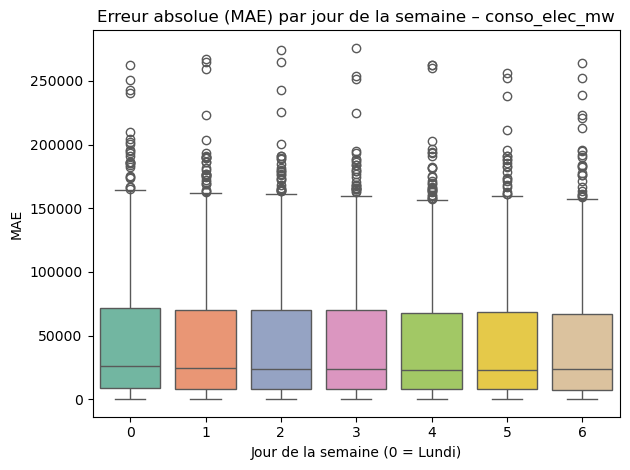

C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\3804008542.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=weekday_df, x="weekday", y="mae", palette="Set2")


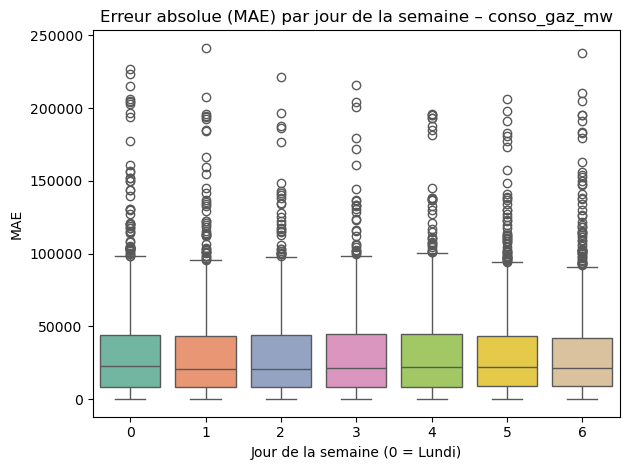

In [ ]:
#  Ajout de l'information weekday si elle n'est pas déjà là
if "weekday" not in df_visu.columns:
    df_visu["weekday"] = pd.to_datetime(df_visu["date"]).dt.weekday

#  MAE par jour de la semaine
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target].values
        y_pred = df_visu[f"{target}_q50"].values
        mae = np.abs(y_true - y_pred)

        weekday_df = pd.DataFrame({
            "weekday": df_visu["weekday"],
            "mae": mae
        })

        sns.boxplot(data=weekday_df, x="weekday", y="mae", palette="Set2")
        plt.title(f"Erreur absolue (MAE) par jour de la semaine – {target}")
        plt.xlabel("Jour de la semaine (0 = Lundi)")
        plt.ylabel("MAE")
        plt.tight_layout()
        plt.show()
    except KeyError as e:
        print(f" Colonne manquante : {e}")


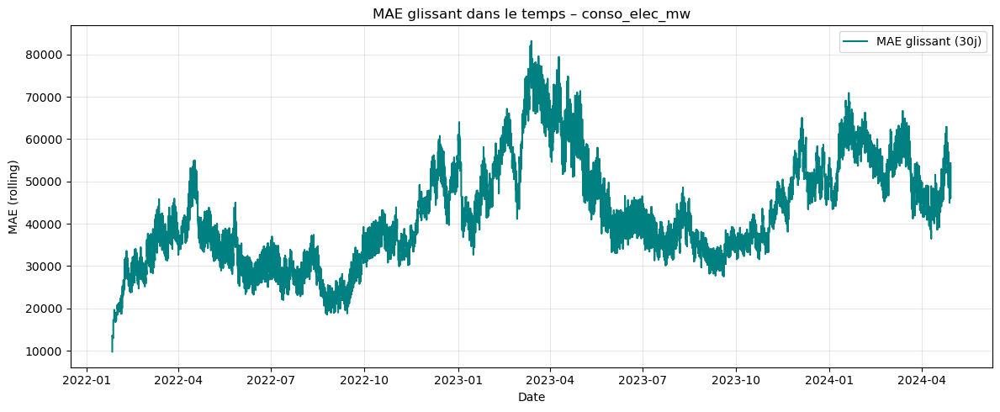

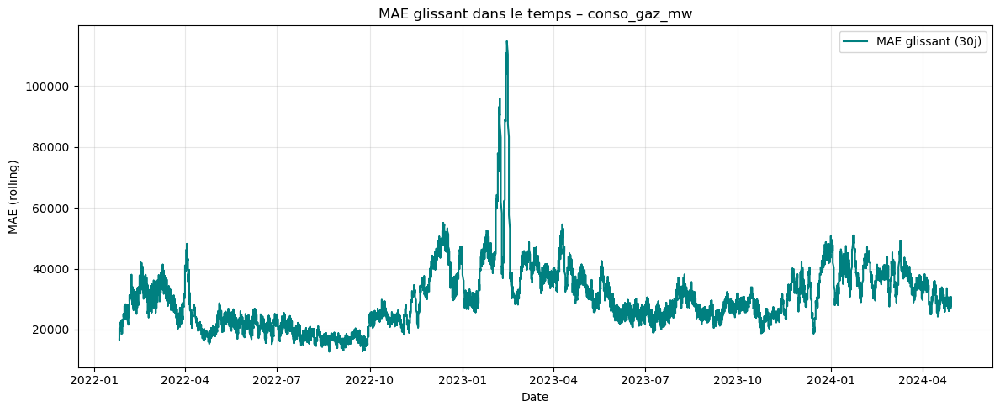

In [ ]:
#  MAE glissant sur 30 jours pour chaque target
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target]
        y_pred = df_visu[f"{target}_q50"]
        abs_error = np.abs(y_true - y_pred)

        # Moyenne glissante
        rolling_mae = abs_error.rolling(window=30).mean()

        plt.figure(figsize=(12, 5))
        plt.plot(df_visu["date"], rolling_mae, label="MAE glissant (30j)", color="teal")
        plt.title(f"MAE glissant dans le temps – {target}")
        plt.xlabel("Date")
        plt.ylabel("MAE (rolling)")
        plt.grid(alpha=0.3)
        plt.legend()
        plt.tight_layout()
        plt.show()
    except KeyError as e:
        print(f" Donnée manquante : {e}")


📈 Couverture globale (q10–q90) pour conso_elec_mw : 21.84%


C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\3771112073.py:17: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  season_coverage = df_cov.groupby("season")["inside"].mean()


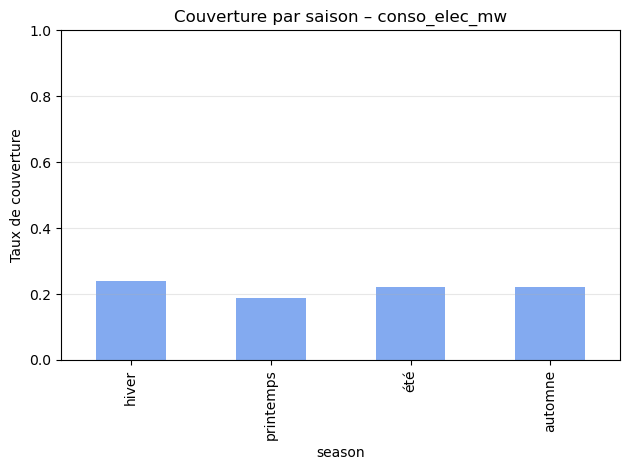

📈 Couverture globale (q10–q90) pour conso_gaz_mw : 21.07%


C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\3771112073.py:17: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  season_coverage = df_cov.groupby("season")["inside"].mean()


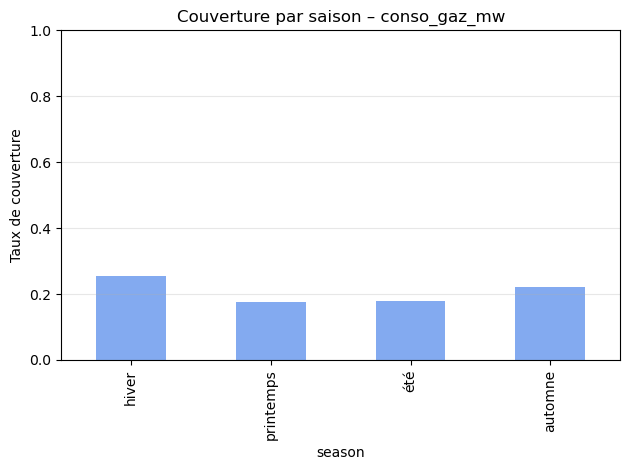

In [ ]:
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        q10 = df_visu[f"{target}_q10"]
        q90 = df_visu[f"{target}_q90"]
        y_true = df_visu[target]

        #  Calcul couverture
        inside_interval = (y_true >= q10) & (y_true <= q90)
        coverage = inside_interval.mean()
        print(f" Couverture globale (q10–q90) pour {target} : {coverage:.2%}")

        #  Couverture par saison
        df_cov = pd.DataFrame({
            "season": df["season"],  # Toujours issue du df transformé
            "inside": inside_interval
        })
        season_coverage = df_cov.groupby("season")["inside"].mean()

        #  Affichage
        season_coverage.plot(kind="bar", color="cornflowerblue", alpha=0.8)
        plt.title(f"Couverture par saison – {target}")
        plt.ylabel("Taux de couverture")
        plt.ylim(0, 1)
        plt.grid(axis="y", alpha=0.3)
        plt.tight_layout()
        plt.show()
    except KeyError as e:
        print(f" Donnée manquante pour {target} : {e}")



📏 Largeur moyenne de l’intervalle (q90 - q10) pour conso_elec_mw : 20595.66


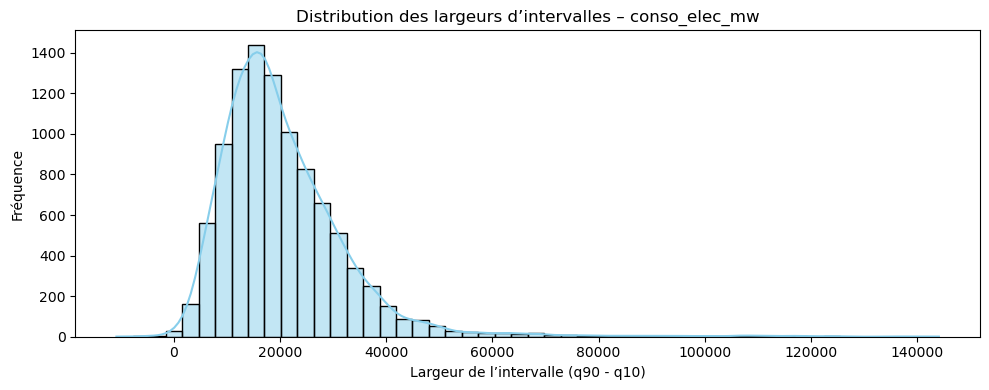

C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\3708793675.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=width_df, x="season", y="width", palette="coolwarm")


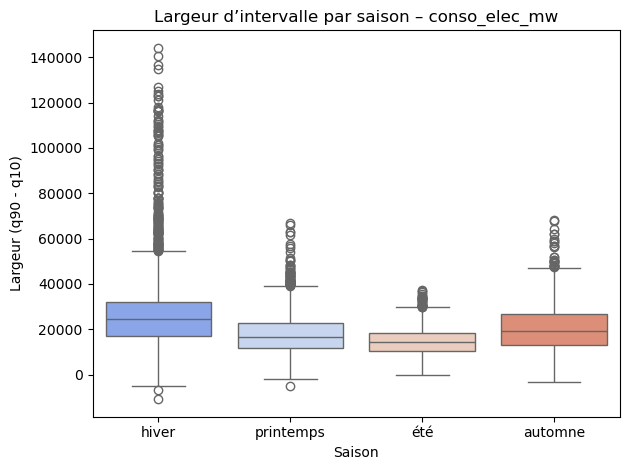


📏 Largeur moyenne de l’intervalle (q90 - q10) pour conso_gaz_mw : 23198.24


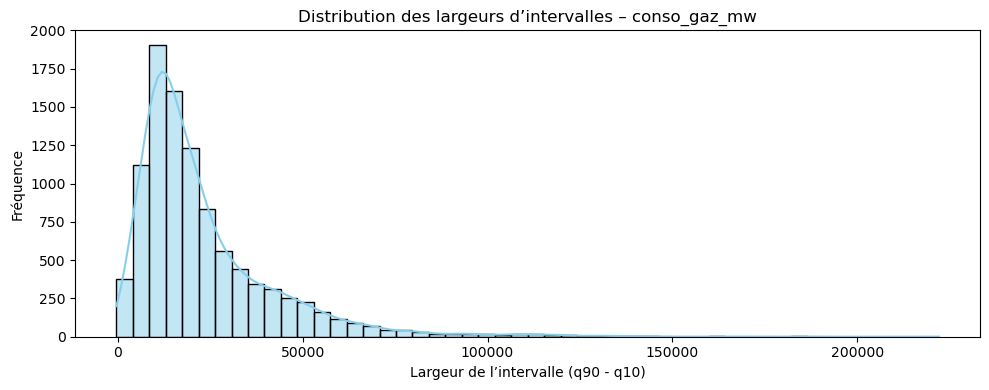

C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\3708793675.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=width_df, x="season", y="width", palette="coolwarm")


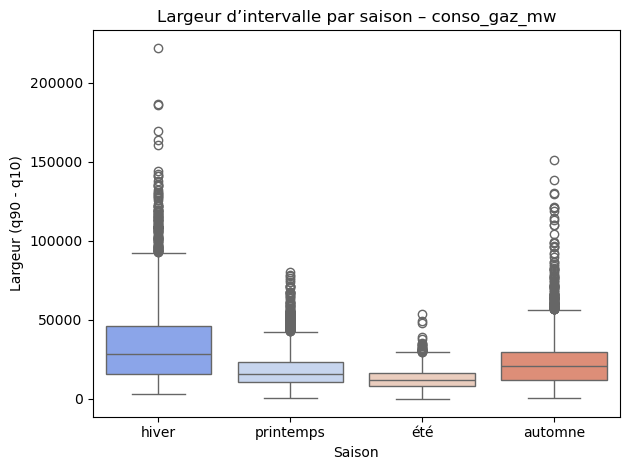

In [ ]:
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        q10 = df_visu[f"{target}_q10"]
        q90 = df_visu[f"{target}_q90"]
        interval_width = q90 - q10

        print(f"\n📏 Largeur moyenne de l’intervalle (q90 - q10) pour {target} : {interval_width.mean():.2f}")

        #  Histogramme
        plt.figure(figsize=(10, 4))
        sns.histplot(interval_width, bins=50, kde=True, color="skyblue")
        plt.title(f"Distribution des largeurs d’intervalles – {target}")
        plt.xlabel("Largeur de l’intervalle (q90 - q10)")
        plt.ylabel("Fréquence")
        plt.tight_layout()
        plt.show()

        #  Boxplot par saison
        width_df = pd.DataFrame({
            "width": interval_width,
            "season": df["season"]  # saison issue de la transformation
        })
        sns.boxplot(data=width_df, x="season", y="width", palette="coolwarm")
        plt.title(f"Largeur d’intervalle par saison – {target}")
        plt.xlabel("Saison")
        plt.ylabel("Largeur (q90 - q10)")
        plt.tight_layout()
        plt.show()

    except KeyError as e:
        print(f" Donnée manquante pour {target} : {e}")



📉 Résidus – conso_elec_mw
   Moyenne des résidus : -23200.82
   Écart-type : 56730.01


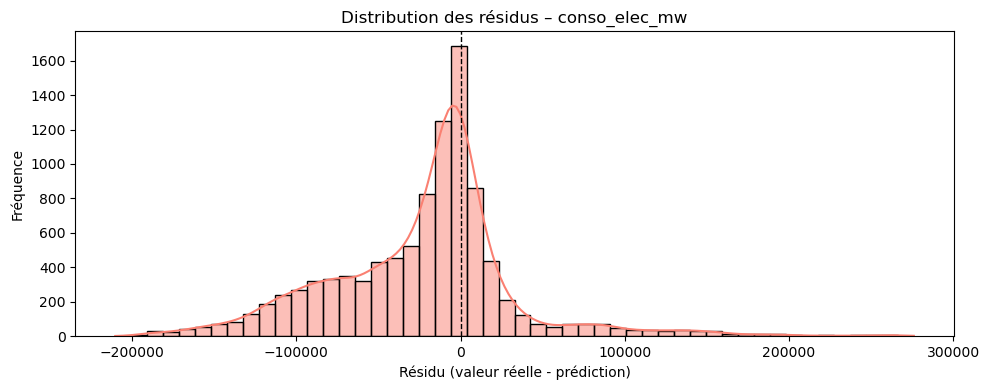

C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\3904865470.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=resid_df, x="season", y="residual", palette="Set2")


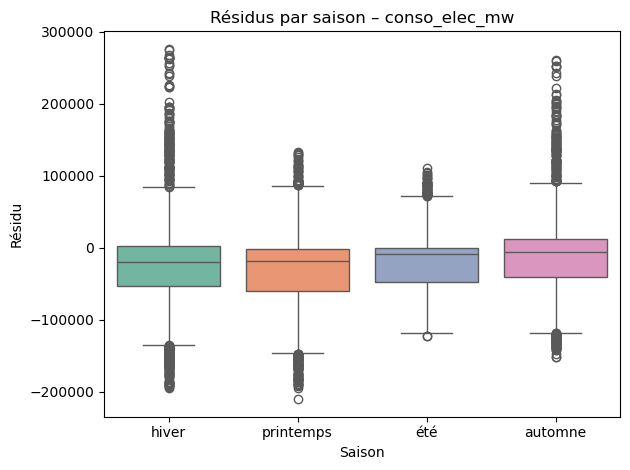


📉 Résidus – conso_gaz_mw
   Moyenne des résidus : -16942.30
   Écart-type : 38699.53


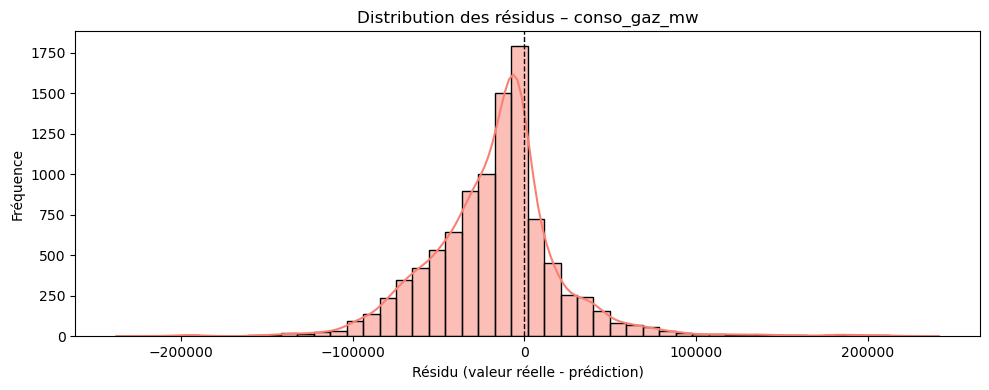

C:\Users\arnov\AppData\Local\Temp\ipykernel_9564\3904865470.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=resid_df, x="season", y="residual", palette="Set2")


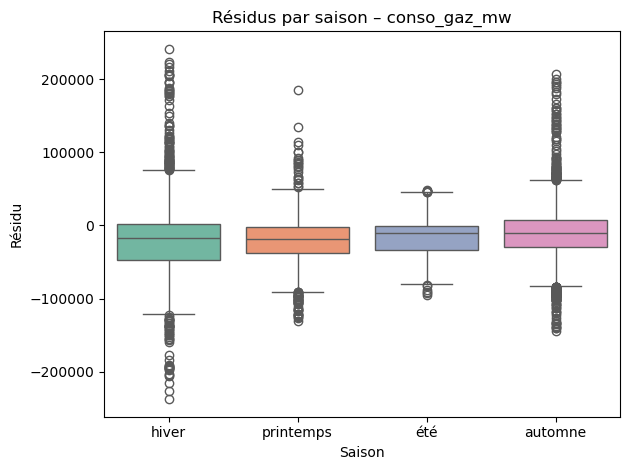

In [ ]:
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    try:
        y_true = df_visu[target]
        y_pred = df_visu[f"{target}_q50"]
        residuals = y_true - y_pred

        print(f"\n Résidus – {target}")
        print(f"   Moyenne des résidus : {residuals.mean():.2f}")
        print(f"   Écart-type : {residuals.std():.2f}")

        #  Distribution des résidus
        plt.figure(figsize=(10, 4))
        sns.histplot(residuals, bins=50, kde=True, color="salmon")
        plt.title(f"Distribution des résidus – {target}")
        plt.xlabel("Résidu (valeur réelle - prédiction)")
        plt.ylabel("Fréquence")
        plt.axvline(0, color="black", linestyle="--", linewidth=1)
        plt.tight_layout()
        plt.show()

        #  Boxplot des résidus par saison
        resid_df = pd.DataFrame({
            "residual": residuals,
            "season": df["season"]  # Info temporelle ajoutée pendant transformation
        })
        sns.boxplot(data=resid_df, x="season", y="residual", palette="Set2")
        plt.title(f"Résidus par saison – {target}")
        plt.xlabel("Saison")
        plt.ylabel("Résidu")
        plt.tight_layout()
        plt.show()

    except KeyError as e:
        print(f" Donnée manquante pour {target} : {e}")


Interprétation :
Les résidus moyens négatifs indiquent que le modèle sous-estime systématiquement les consommations réelles.

L'écart-type élevé des résidus (surtout pour le gaz) montre une grande variabilité dans l’erreur → probablement dû à des pics de consommation mal anticipés.


🔥 Top 5 erreurs – conso_elec_mw – Région 32
          date  conso_elec_mw            q50         erreur
604 2022-03-14       281872.0  424374.119168  142502.119168
587 2022-03-13       256620.0  390347.088651  133727.088651
935 2022-04-11       270843.0  398932.392398  128089.392398
948 2022-04-12       257229.0  382008.278418  124779.278418
924 2022-04-10       257799.0  381731.789836  123932.789836


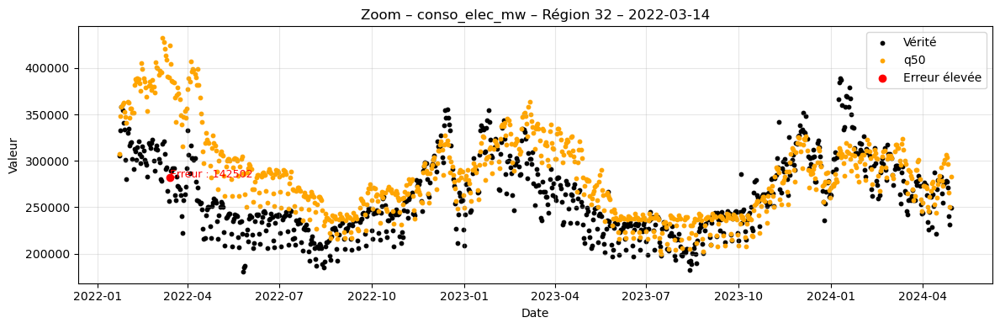

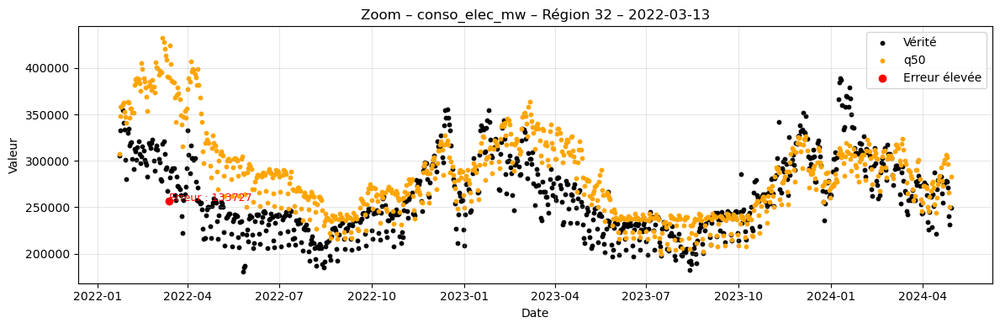

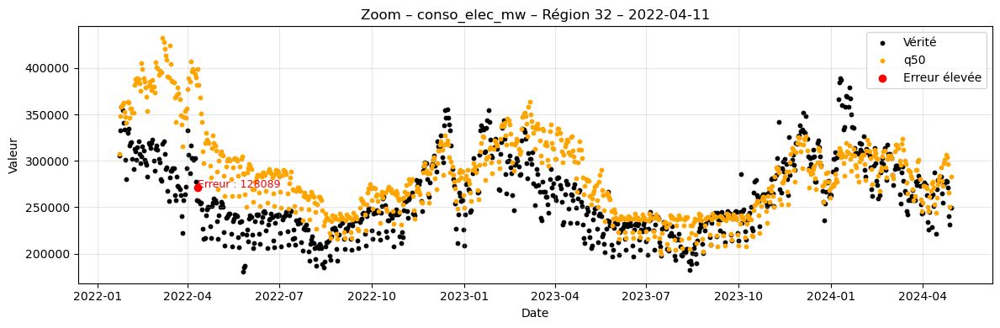

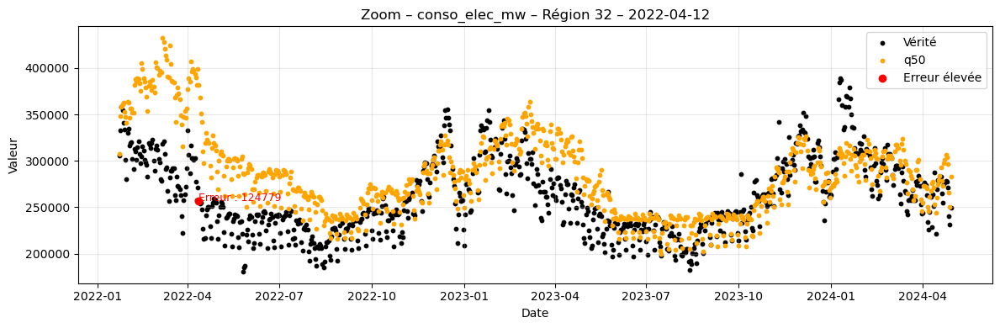

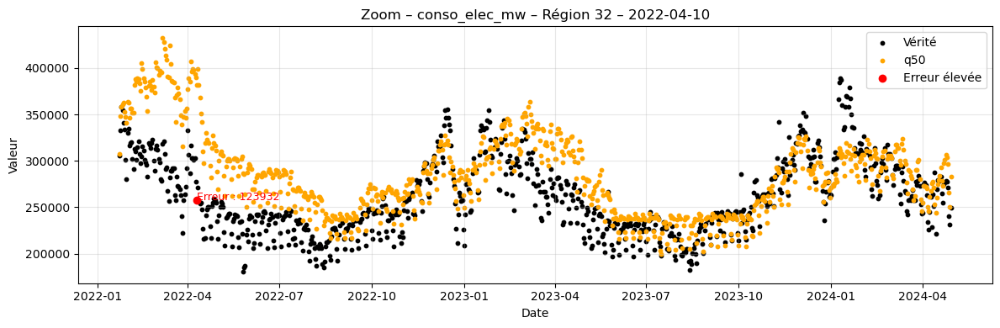


🔥 Top 5 erreurs – conso_elec_mw – Région 27
           date  conso_elec_mw            q50        erreur
4045 2022-12-26        98061.0  143769.096763  45708.096763
4057 2022-12-27       104694.0  147882.590784  43188.590784
4118 2023-01-01        85377.0  127332.408386  41955.408386
4106 2022-12-31        91771.0  132566.353939  40795.353939
4081 2022-12-29       105429.0  144983.190150  39554.190150


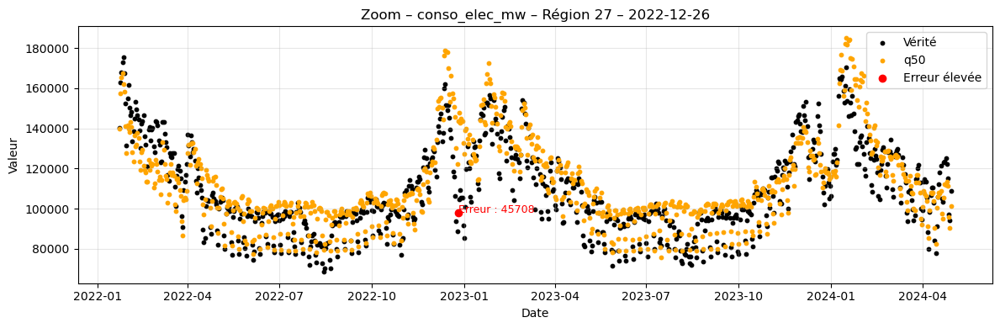

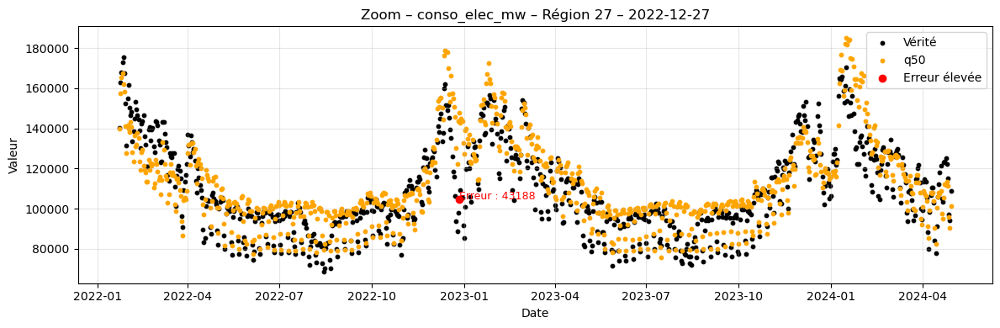

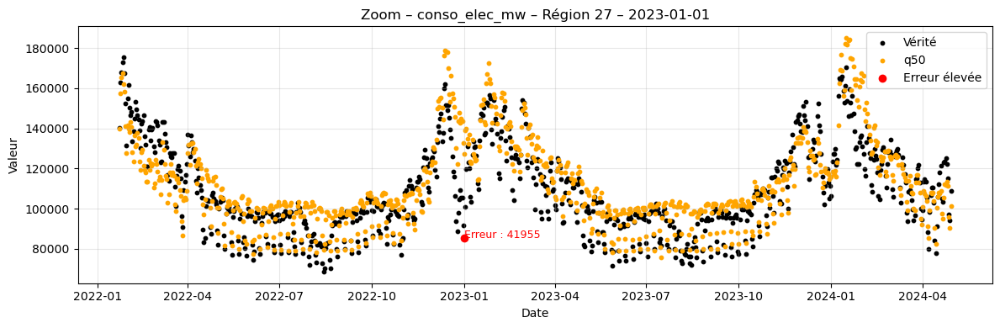

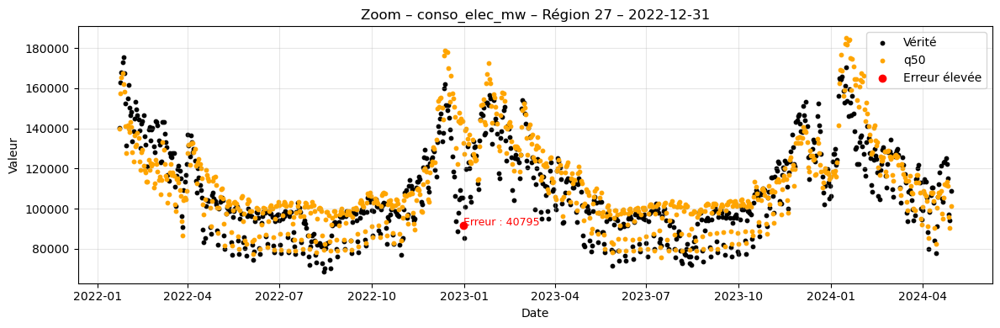

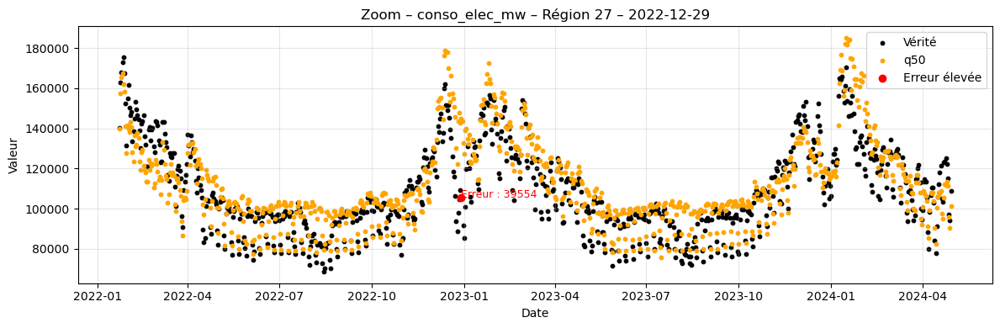


🔥 Top 5 erreurs – conso_elec_mw – Région 24
           date  conso_elec_mw            q50        erreur
8787 2024-01-25       107787.0  160488.404966  52701.404966
4046 2022-12-26        93640.0  146273.616375  52633.616375
8798 2024-01-26       109381.0  159983.546155  50602.546155
8775 2024-01-24       112971.0  163134.155715  50163.155715
4119 2023-01-01        78794.0  125624.128908  46830.128908


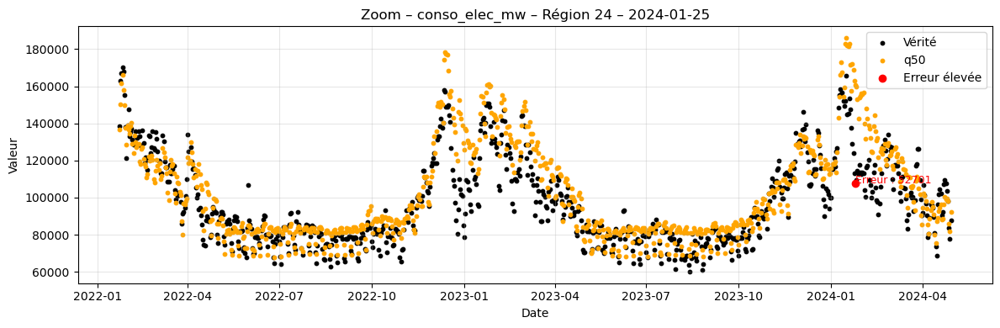

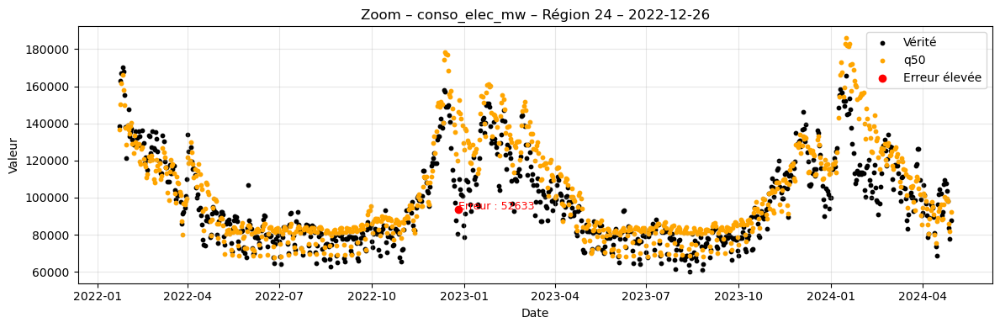

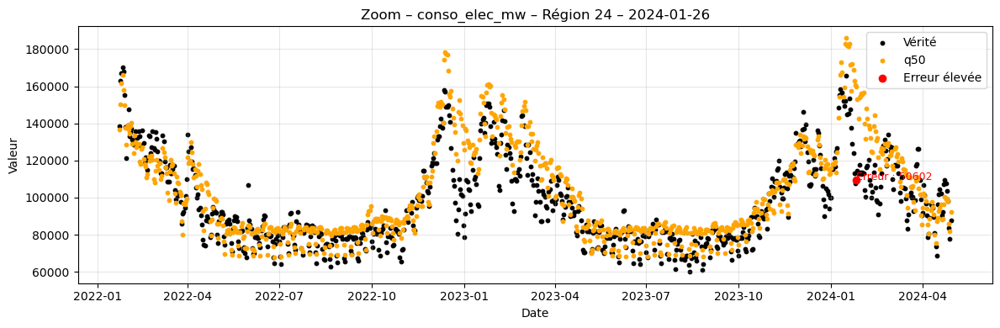

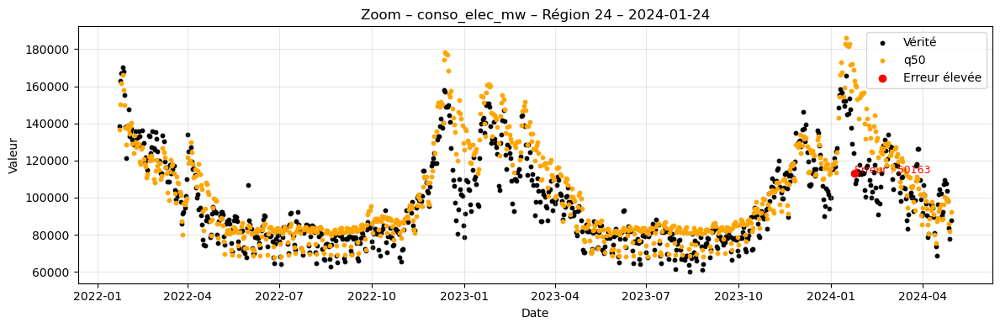

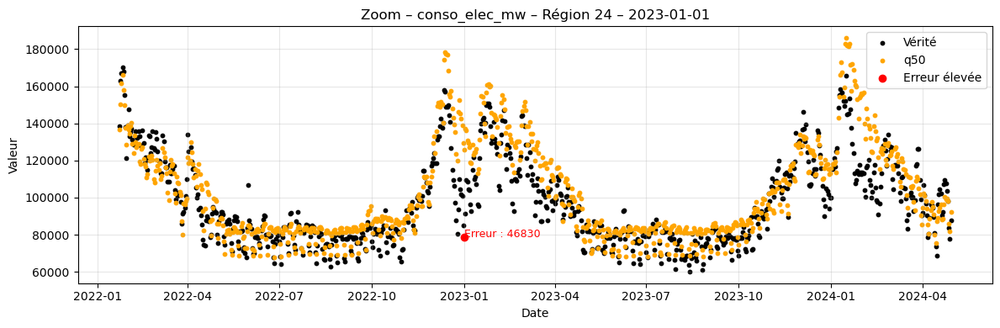


🔥 Top 5 erreurs – conso_elec_mw – Région 11
           date  conso_elec_mw            q50         erreur
8620 2024-01-11       568611.0  292656.487778  275954.512222
8608 2024-01-10       575541.0  301236.719047  274304.280953
8680 2024-01-16       570463.0  302894.576467  267568.423533
8691 2024-01-17       561235.0  296029.459432  265205.540568
8596 2024-01-09       572320.0  307231.046244  265088.953756


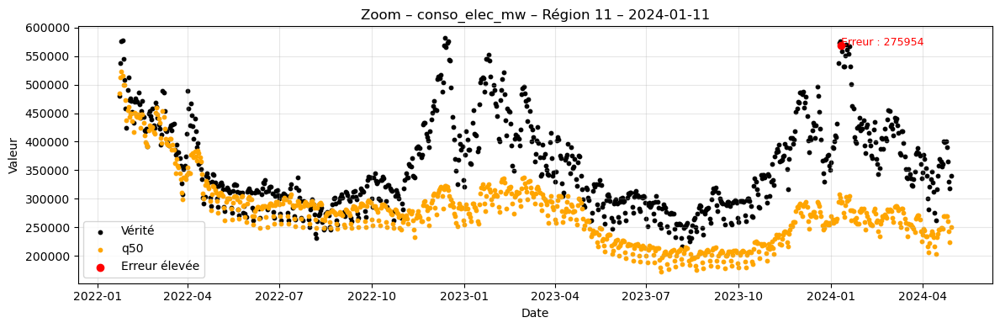

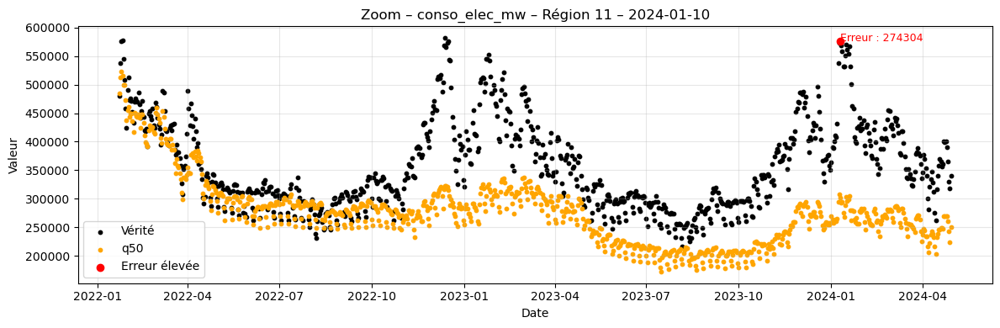

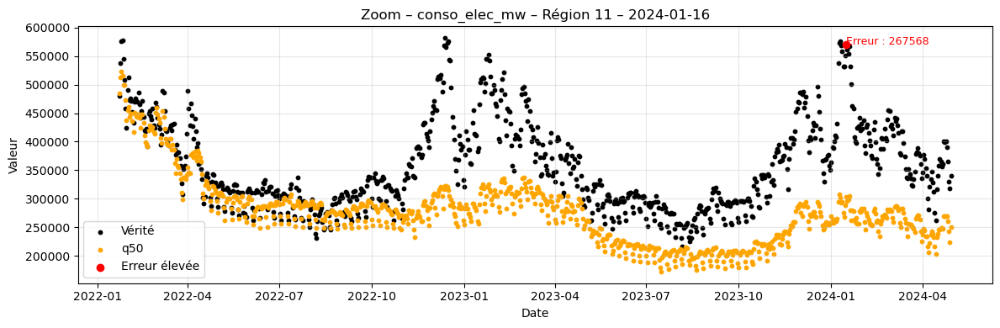

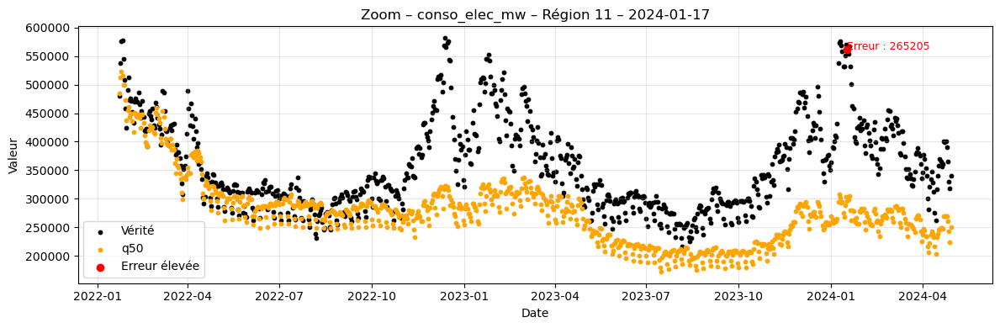

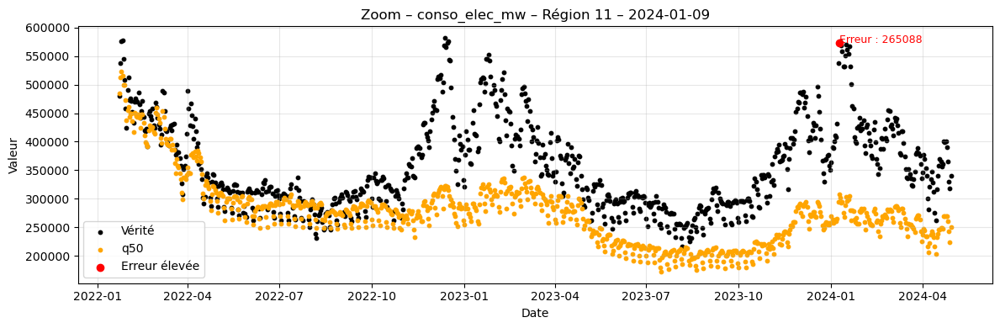


🔥 Top 5 erreurs – conso_elec_mw – Région 52
           date  conso_elec_mw            q50         erreur
5302 2023-04-10       111015.0  321273.203030  210258.203030
5289 2023-04-09       109430.0  304780.968417  195350.968417
5008 2023-03-16       152947.0  347912.315751  194965.315751
5050 2023-03-20       148018.0  341266.077453  193248.077453
4960 2023-03-12       126114.0  317564.621685  191450.621685


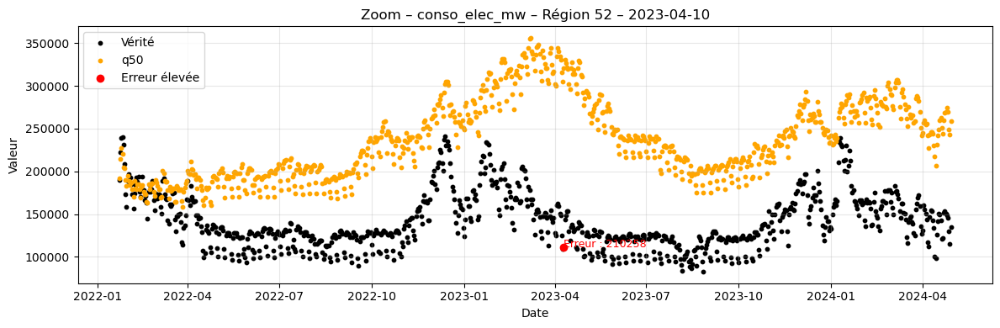

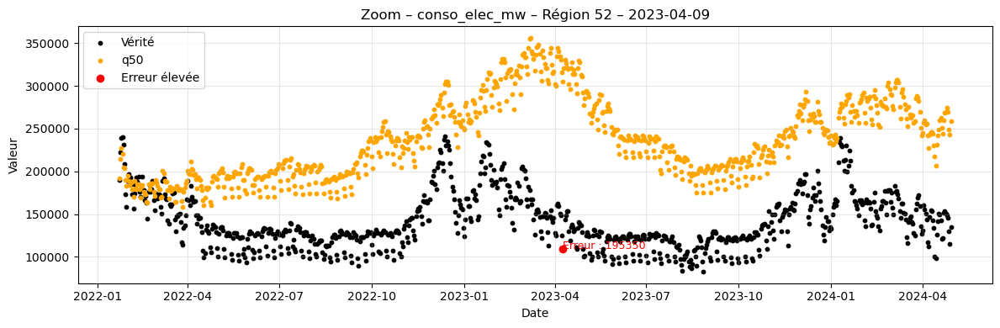

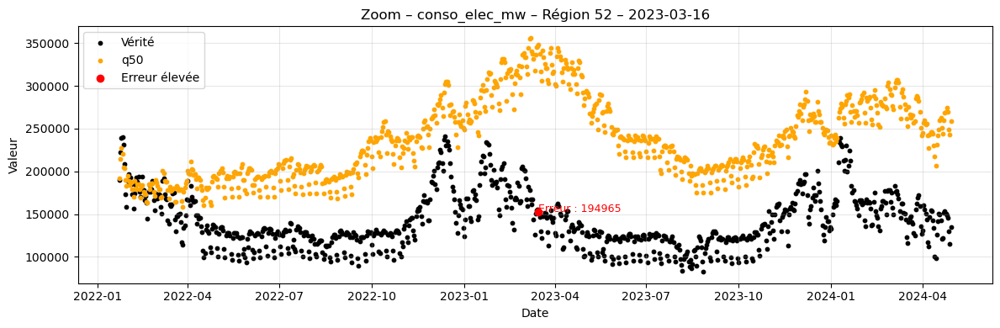

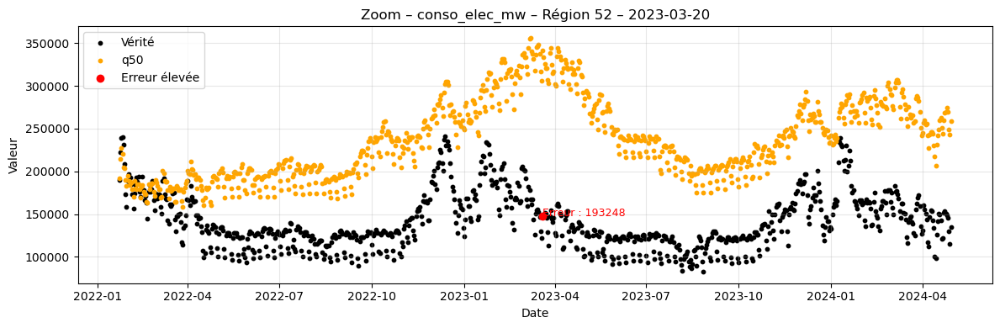

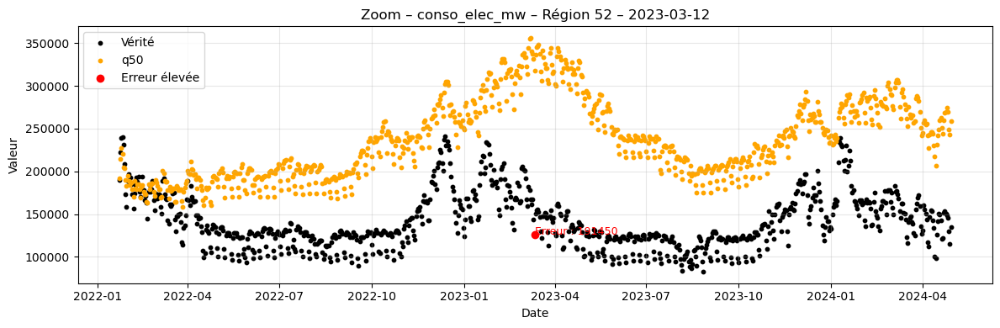


🔥 Top 5 erreurs – conso_elec_mw – Région 93
           date  conso_elec_mw            q50        erreur
992  2022-04-16       174688.0  243228.691551  68540.691551
977  2022-04-15       187396.0  253439.967762  66043.967762
965  2022-04-14       194372.0  255135.991185  60763.991185
1001 2022-04-17       168121.0  226985.323438  58864.323438
1013 2022-04-18       171945.0  228093.475727  56148.475727


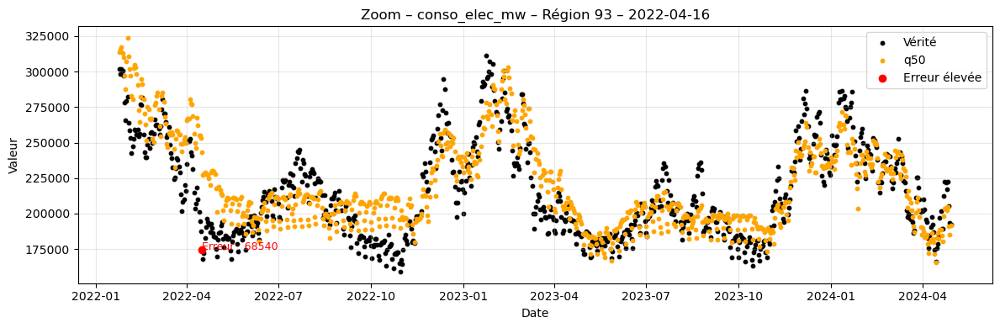

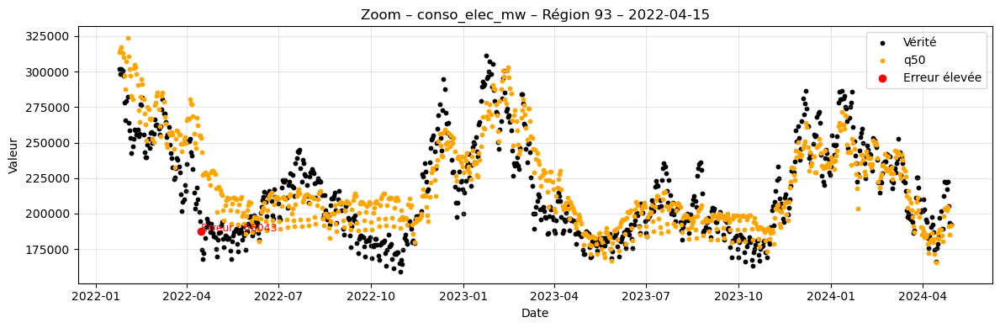

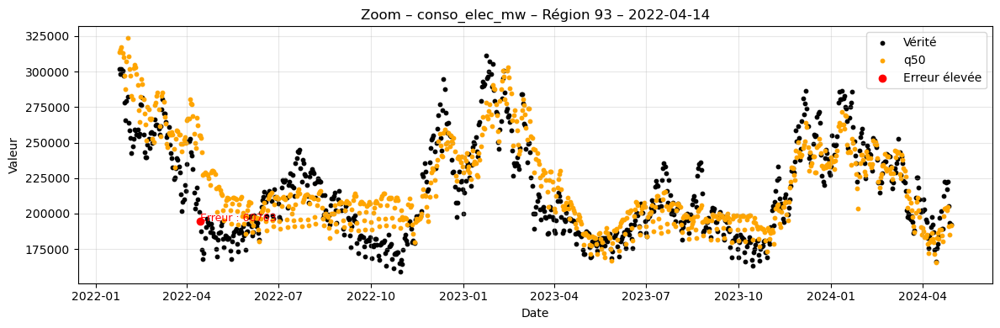

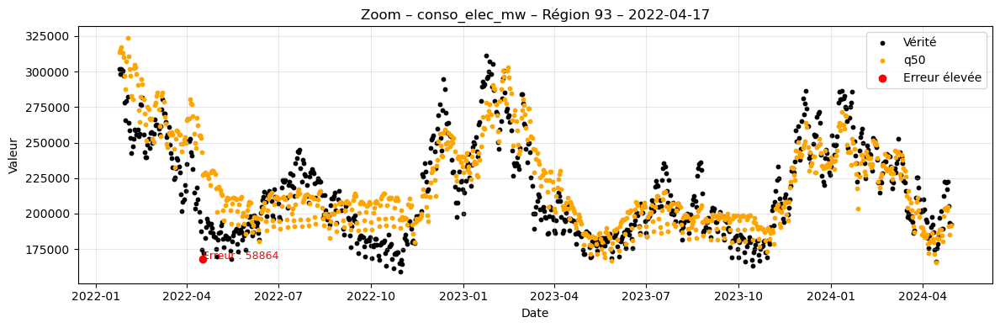

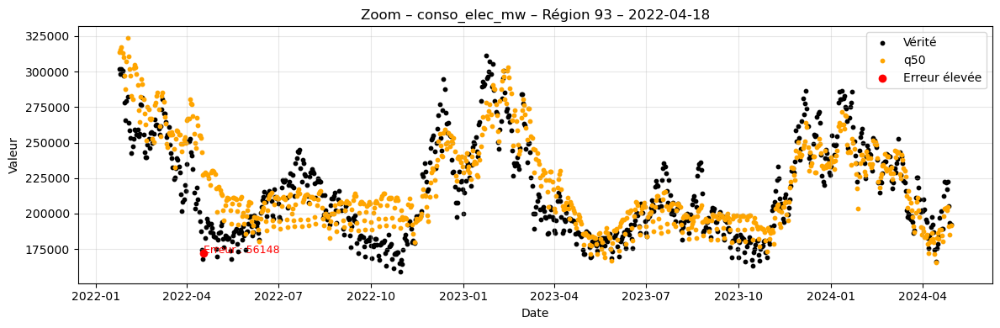


🔥 Top 5 erreurs – conso_elec_mw – Région 84
           date  conso_elec_mw            q50        erreur
3870 2022-12-12       492381.0  392951.145857  99429.854143
3813 2022-12-07       454481.0  356598.266211  97882.733789
3822 2022-12-08       453996.0  362000.886459  91995.113541
3858 2022-12-11       438344.0  348039.975891  90304.024109
3882 2022-12-13       490778.0  400510.905492  90267.094508


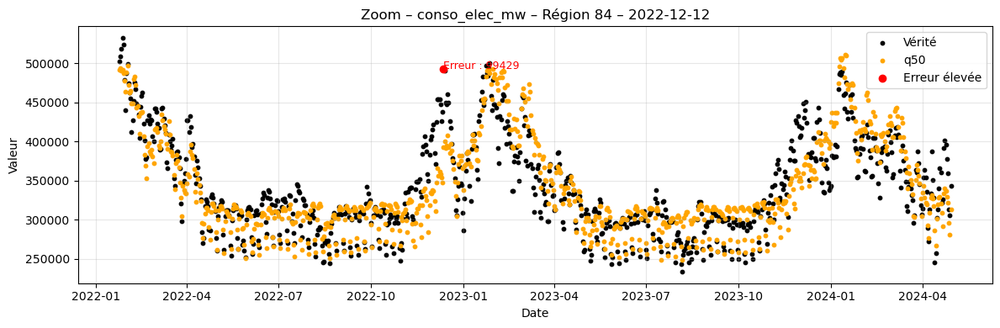

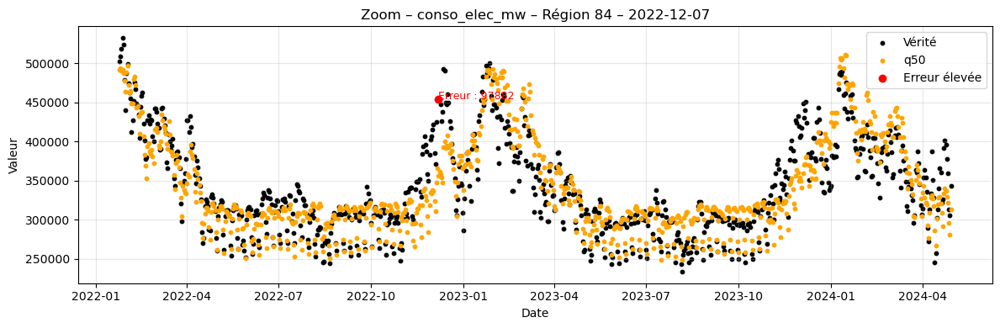

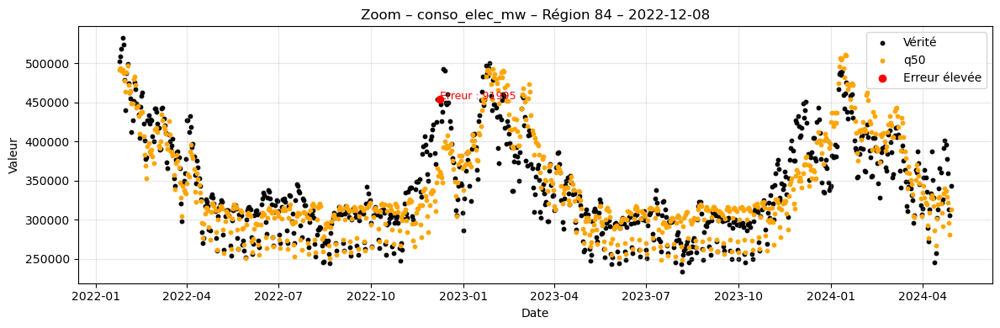

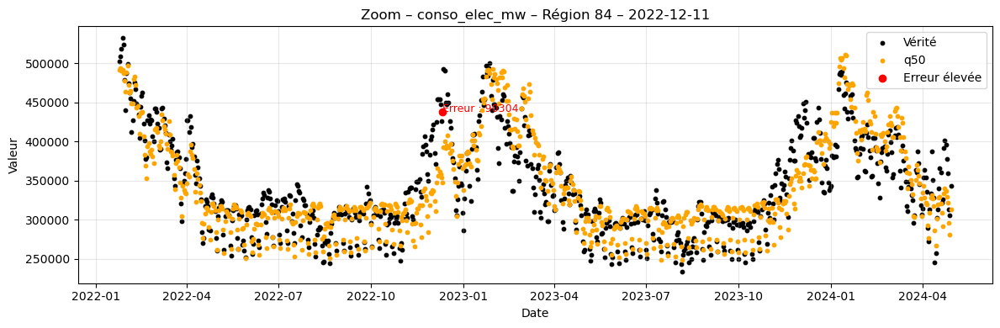

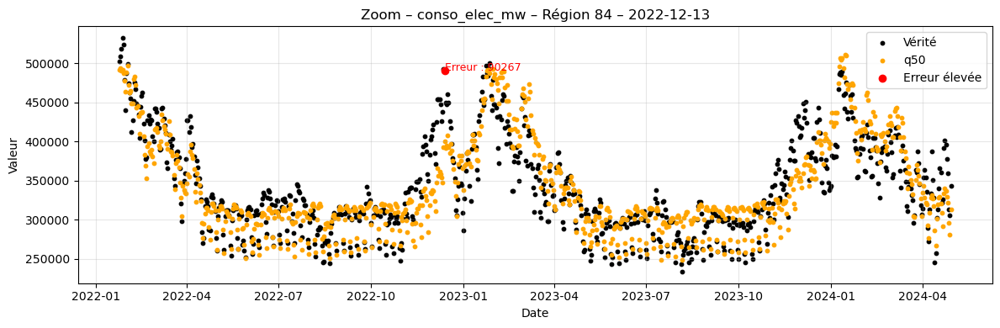


🔥 Top 5 erreurs – conso_elec_mw – Région 76
           date  conso_elec_mw            q50         erreur
4962 2023-03-13       178740.0  298536.447206  119796.447206
5083 2023-03-23       179331.0  296372.534105  117041.534105
4975 2023-03-14       196471.0  311517.099364  115046.099364
4987 2023-03-15       196340.0  310755.944912  114415.944912
5047 2023-03-20       187190.0  301150.854308  113960.854308


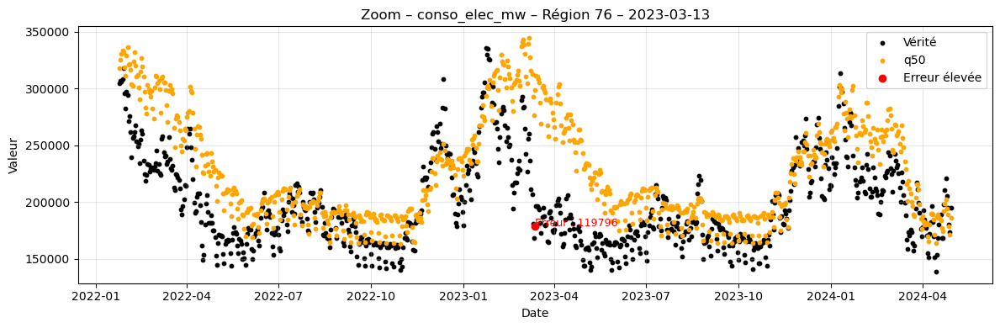

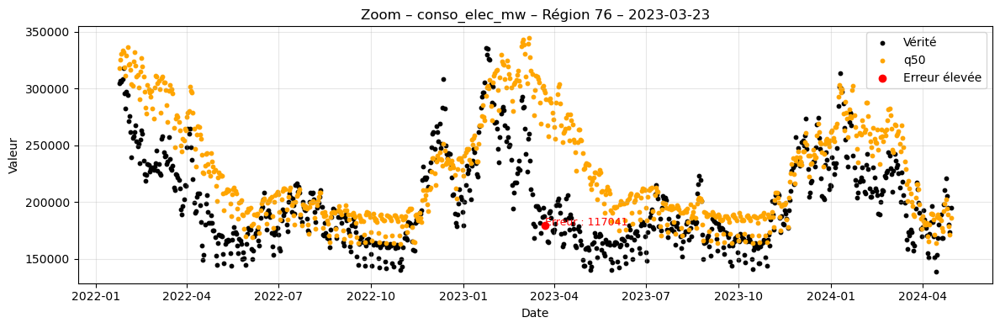

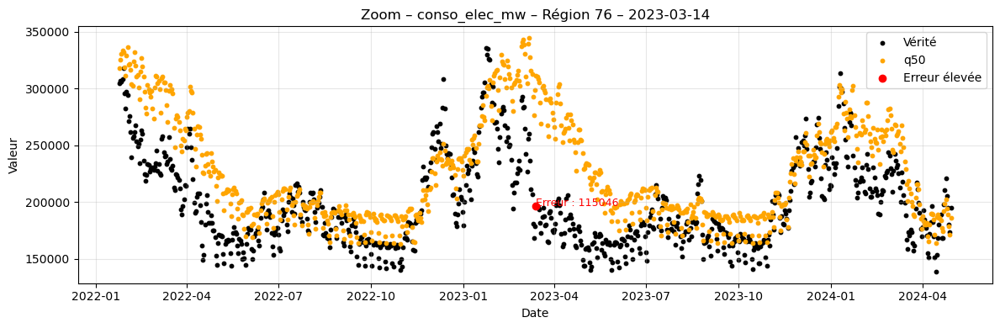

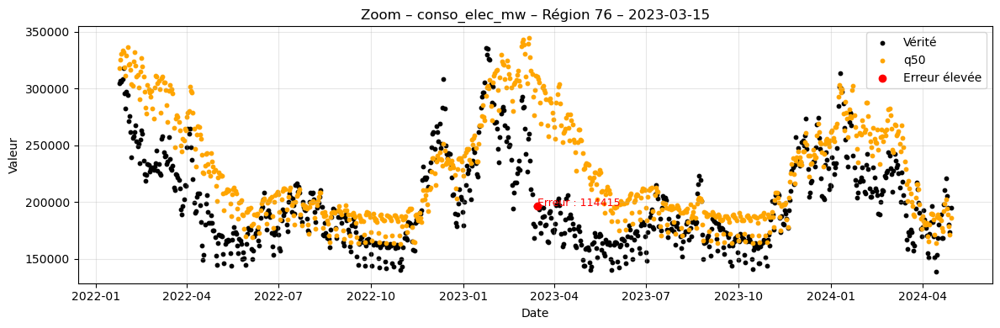

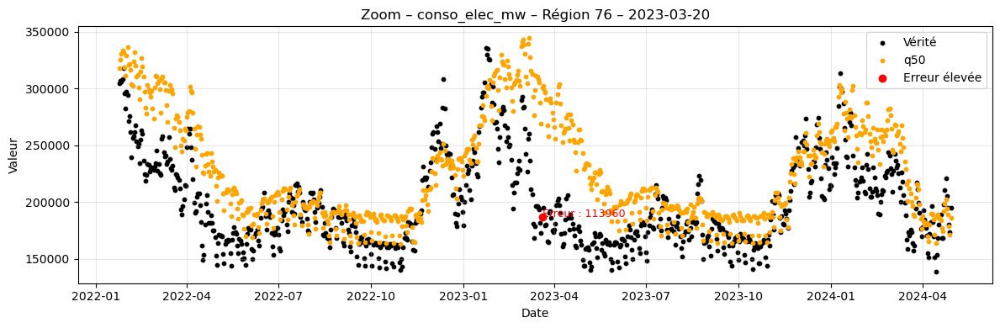


🔥 Top 5 erreurs – conso_elec_mw – Région 75
          date  conso_elec_mw            q50         erreur
571 2022-03-12       244808.0  363663.133070  118855.133070
536 2022-03-09       272170.0  382311.241663  110141.241663
547 2022-03-10       261682.0  370548.176579  108866.176579
560 2022-03-11       264978.0  372444.242984  107466.242984
524 2022-03-08       292193.0  399088.763814  106895.763814


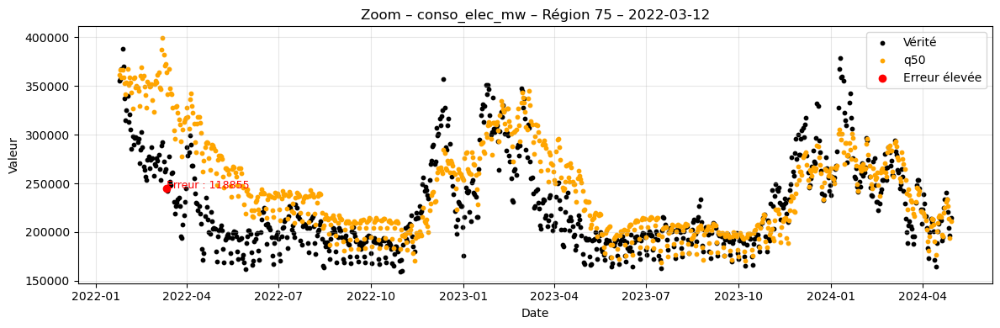

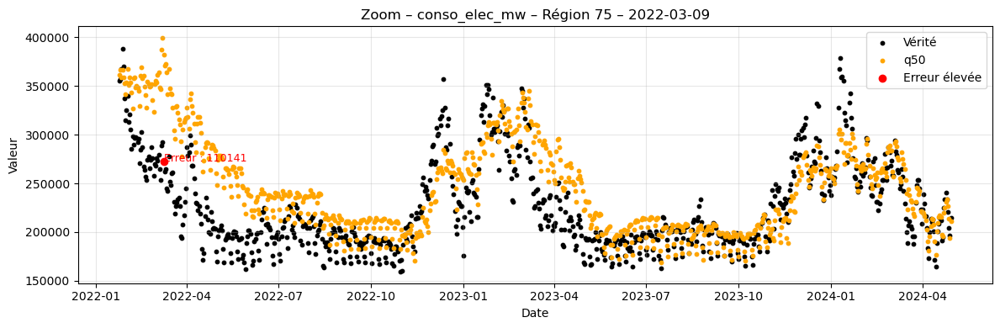

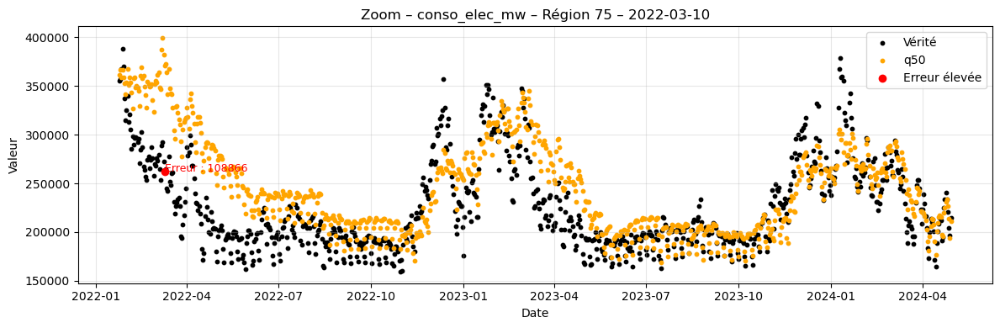

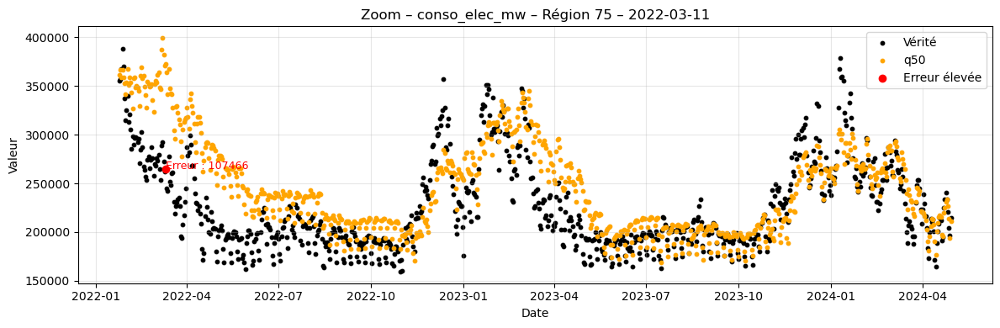

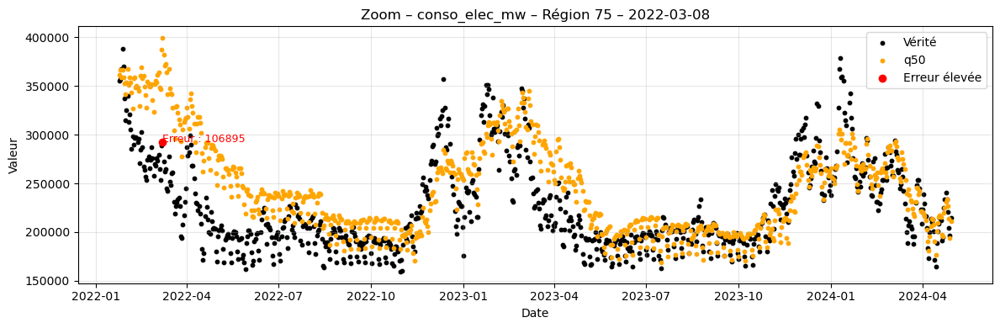


🔥 Top 5 erreurs – conso_elec_mw – Région 53
           date  conso_elec_mw            q50         erreur
9343 2024-03-12       136614.0  311037.598185  174423.598185
9357 2024-03-13       126729.0  299291.936318  172562.936318
9365 2024-03-14       126511.0  294637.869835  168126.869835
9381 2024-03-15       121117.0  287420.595064  166303.595064
9417 2024-03-18       118455.0  283924.472807  165469.472807


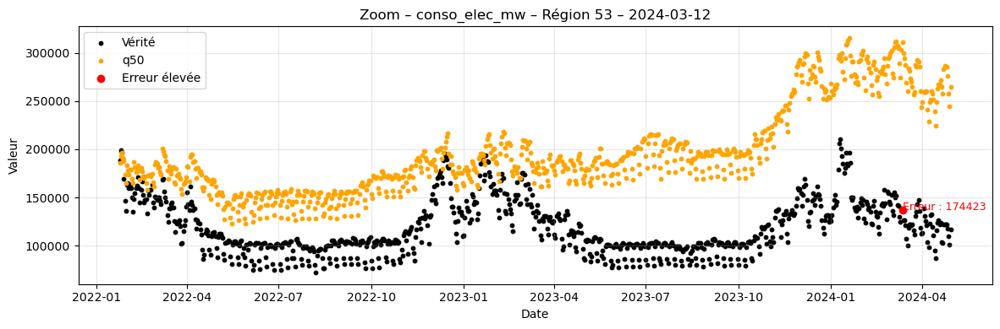

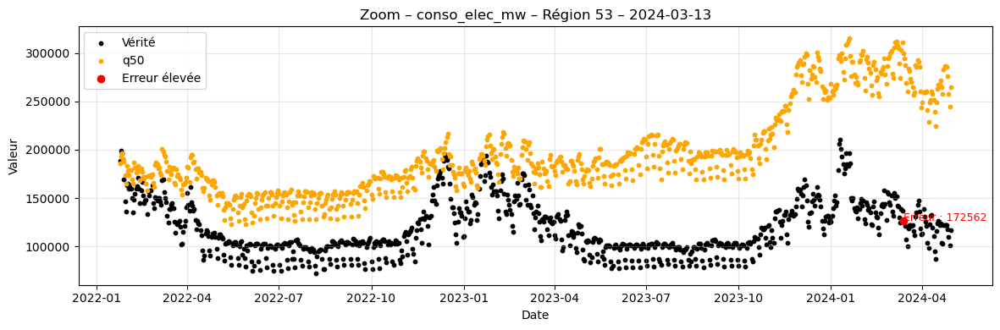

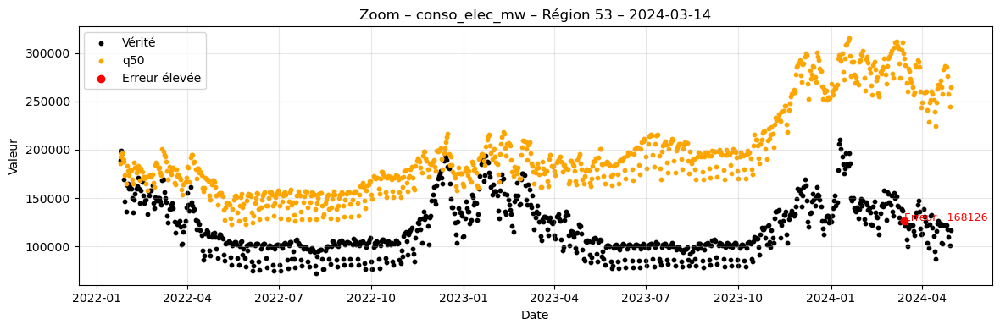

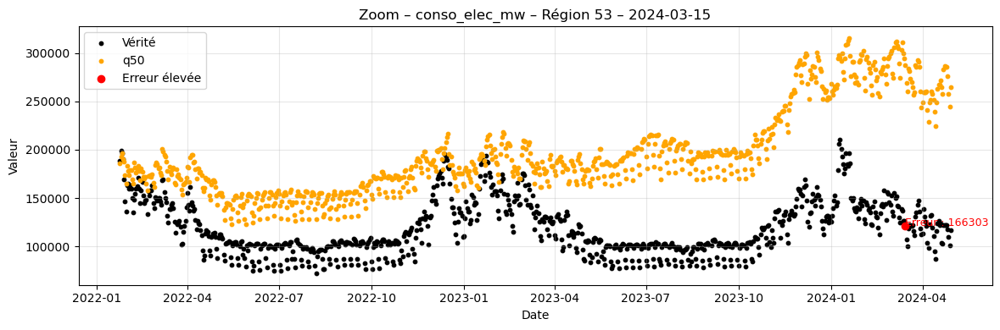

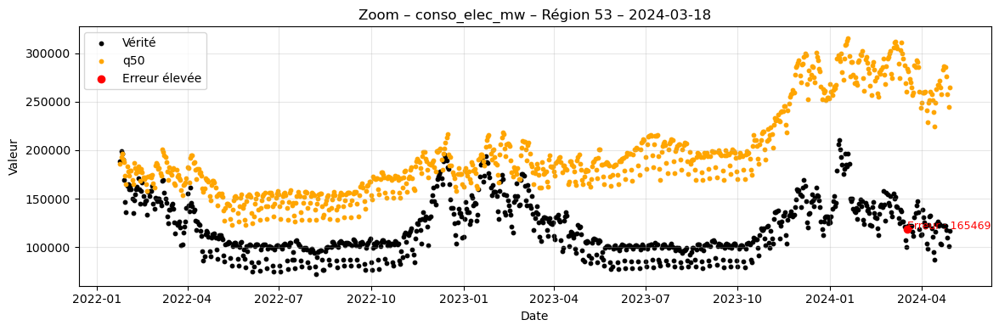


🔥 Top 5 erreurs – conso_elec_mw – Région 28
           date  conso_elec_mw            q50         erreur
4969 2023-03-13       139634.0  325403.020747  185769.020747
5256 2023-04-06       143834.0  322761.471407  178927.471407
4981 2023-03-14       154399.0  331251.770324  176852.770324
5064 2023-03-21       144474.0  320633.675480  176159.675480
5271 2023-04-07       142470.0  317311.792804  174841.792804


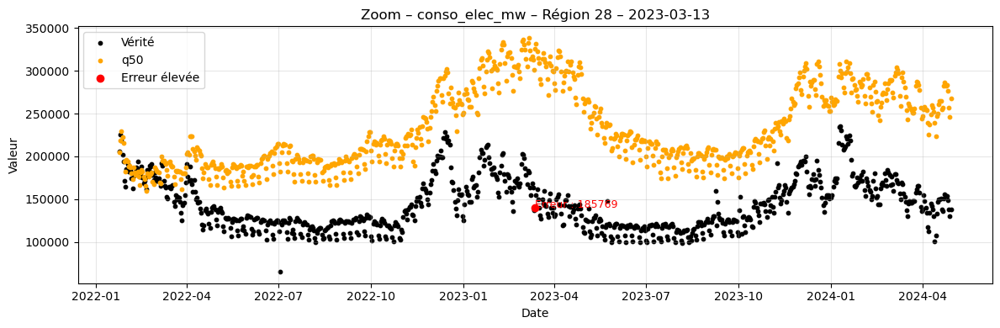

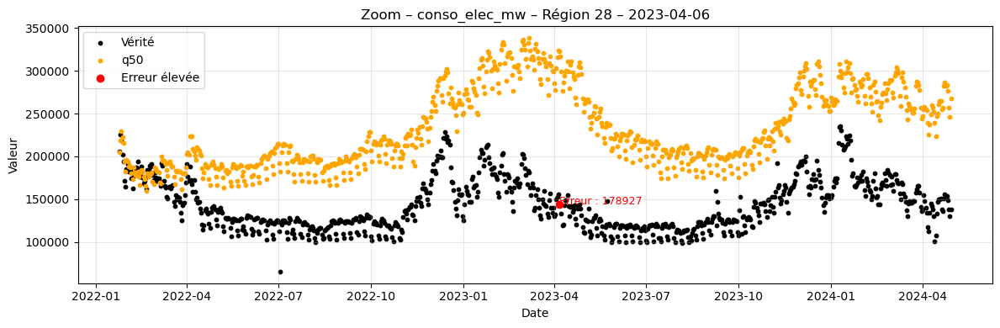

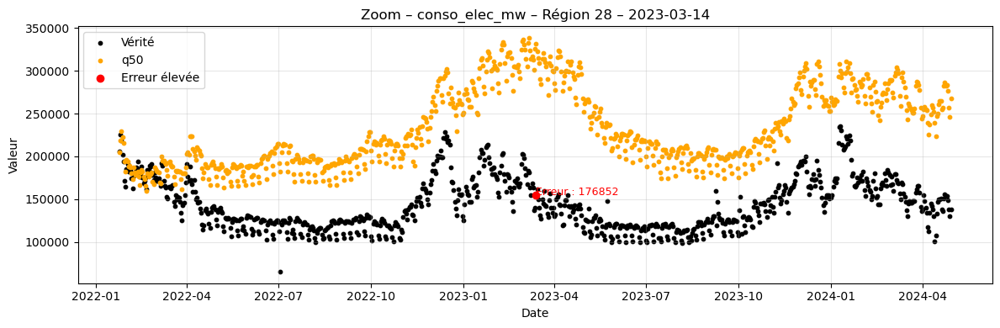

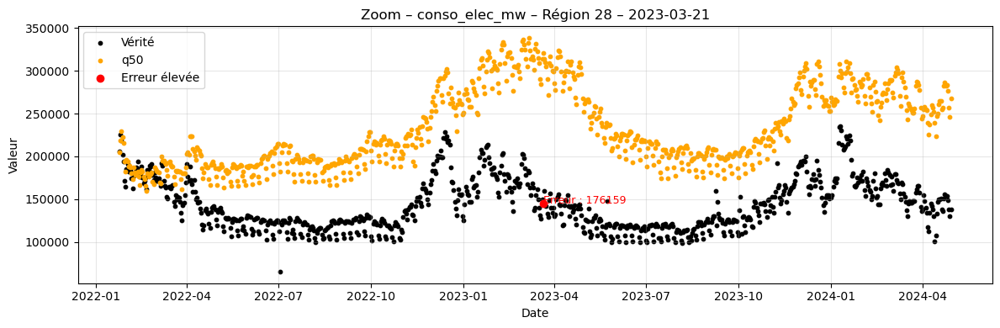

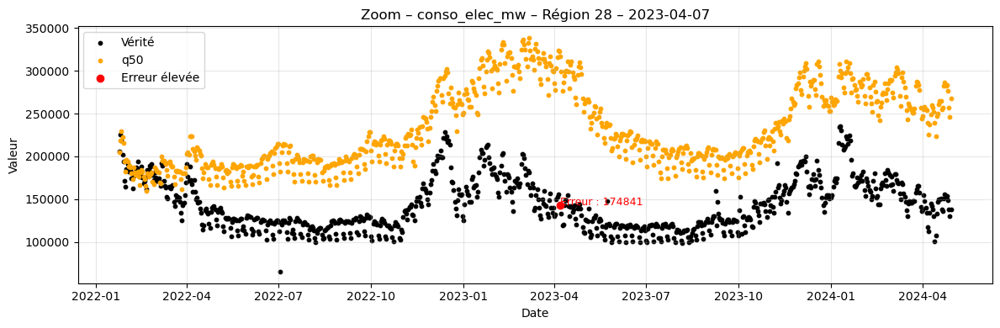


🔥 Top 5 erreurs – conso_elec_mw – Région 44
           date  conso_elec_mw            q50        erreur
5303 2023-04-10       190659.0  287236.140505  96577.140505
5270 2023-04-07       233107.0  320846.565374  87739.565374
5284 2023-04-08       215782.0  301787.427124  86005.427124
5296 2023-04-09       196430.0  278508.415221  82078.415221
5032 2023-03-18       208376.0  285755.725279  77379.725279


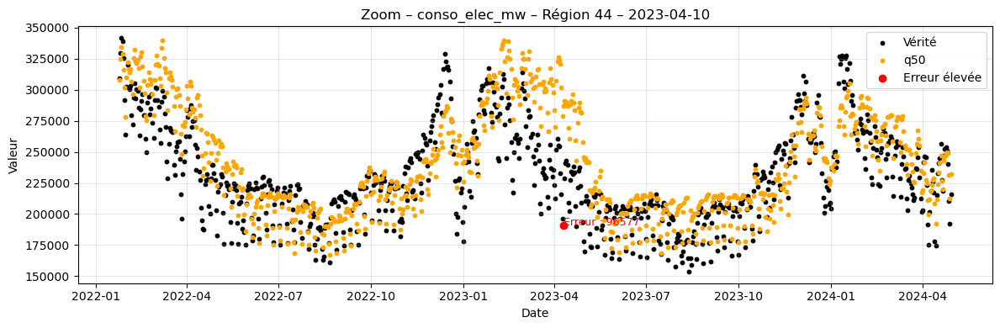

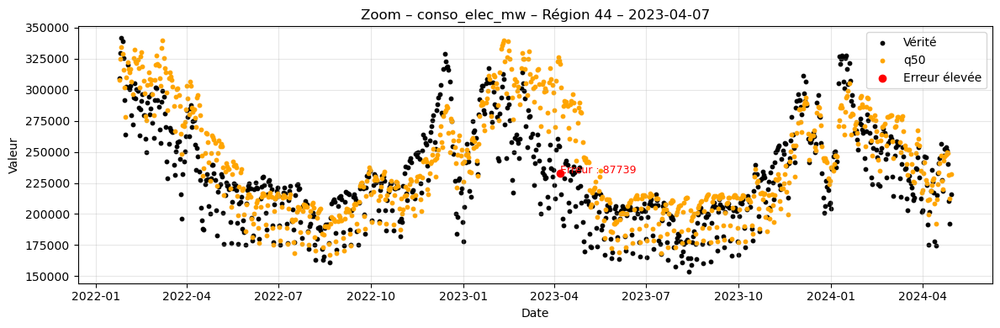

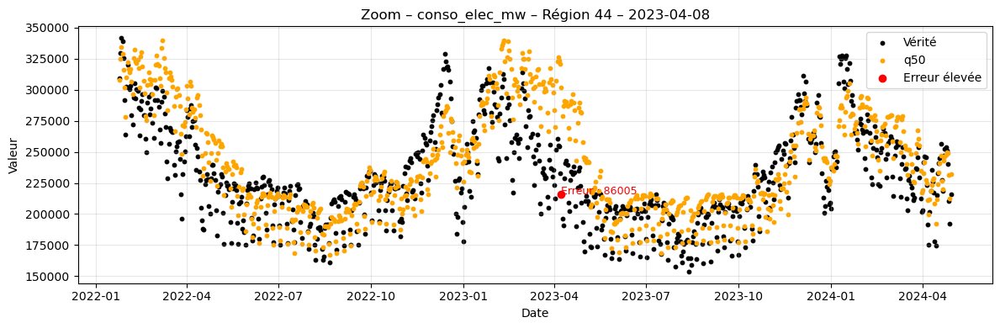

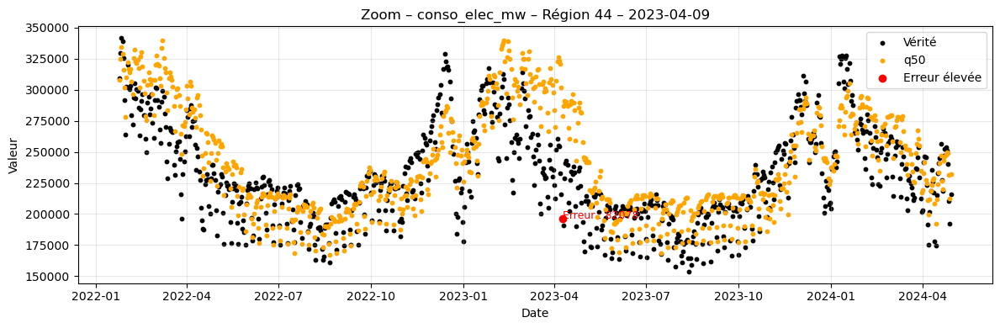

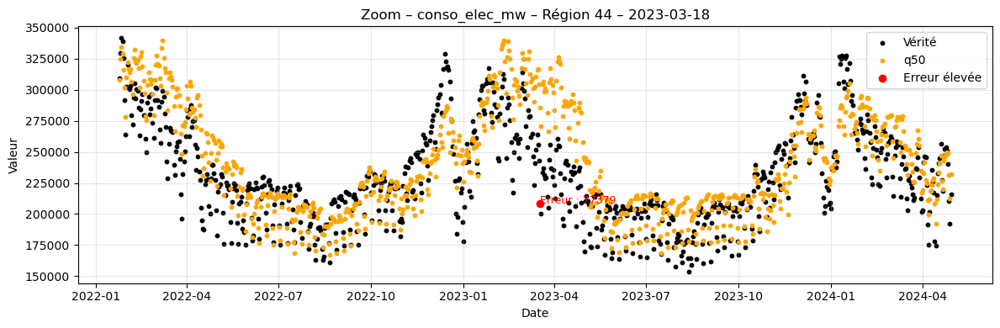


🔥 Top 5 erreurs – conso_gaz_mw – Région 32
           date  conso_gaz_mw            q50         erreur
4548 2023-02-06       96211.0  311379.237644  215168.237644
4632 2023-02-13      105304.0  308341.422762  203037.422762
4512 2023-02-03      110366.0  305971.459386  195605.459386
4536 2023-02-05       95747.0  291290.798405  195543.798405
4644 2023-02-14      112635.0  305426.646809  192791.646809


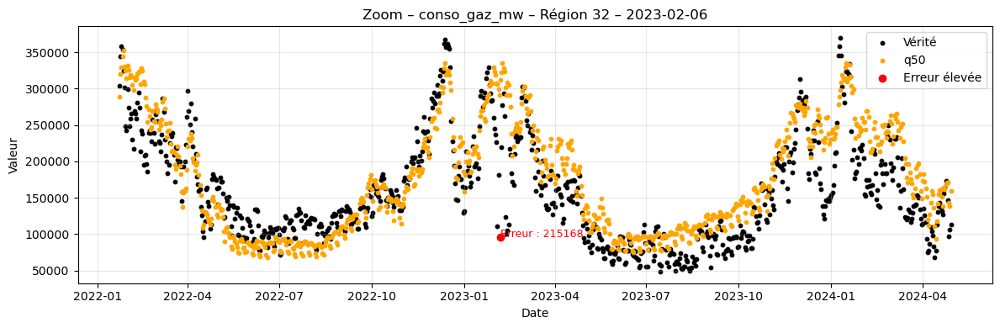

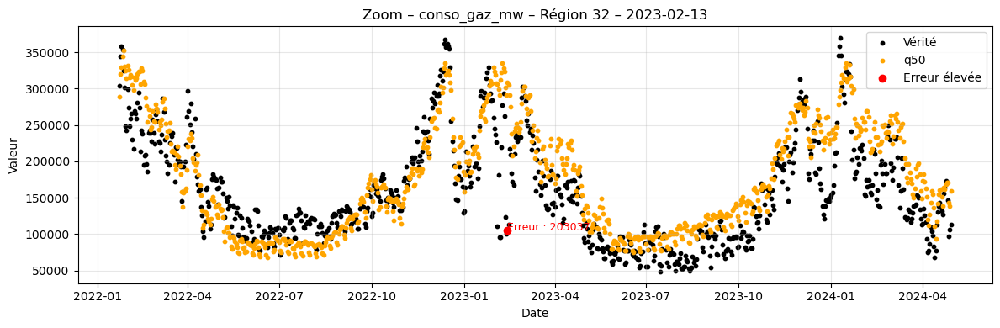

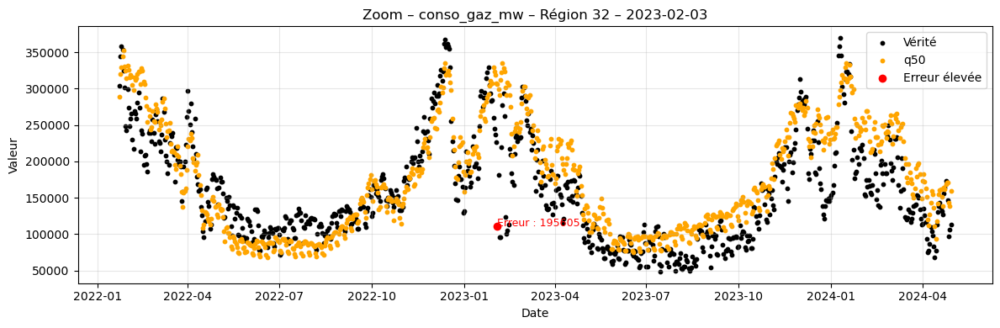

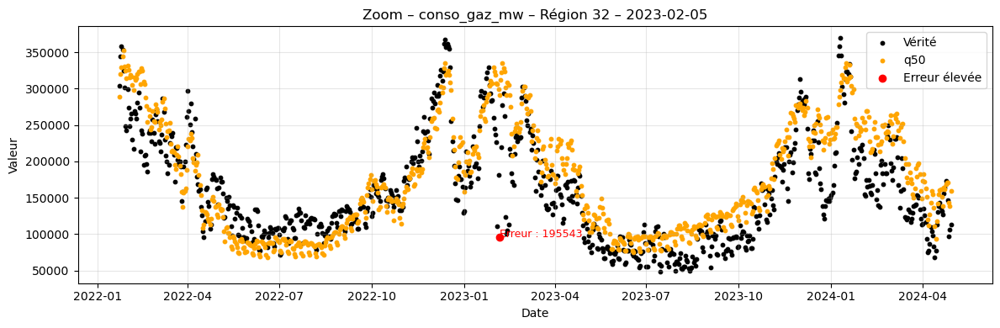

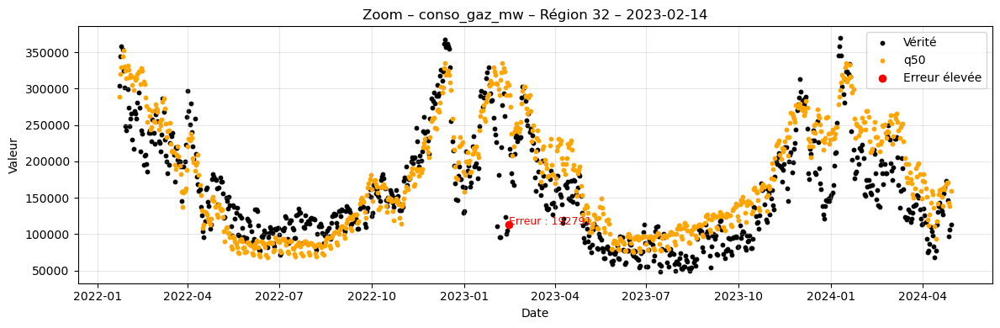


🔥 Top 5 erreurs – conso_gaz_mw – Région 27
           date  conso_gaz_mw           q50        erreur
4550 2023-02-06       15743.0  83938.225862  68195.225862
4646 2023-02-14       15901.0  82715.523041  66814.523041
4634 2023-02-13       16687.0  82865.240514  66178.240514
4622 2023-02-12       13334.0  76592.707719  63258.707719
4538 2023-02-05       25383.0  73554.629207  48171.629207


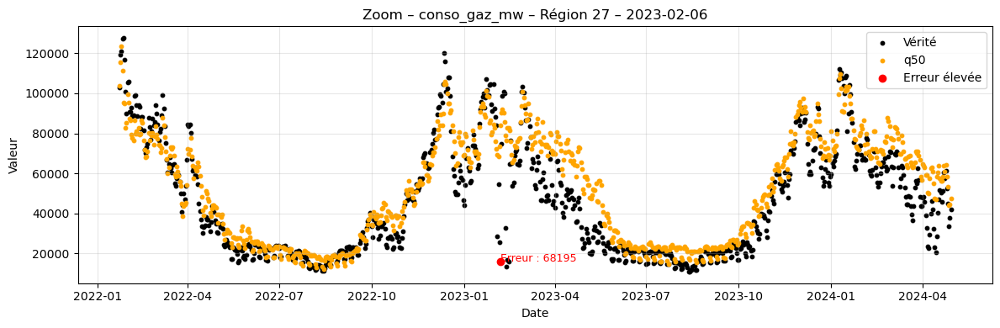

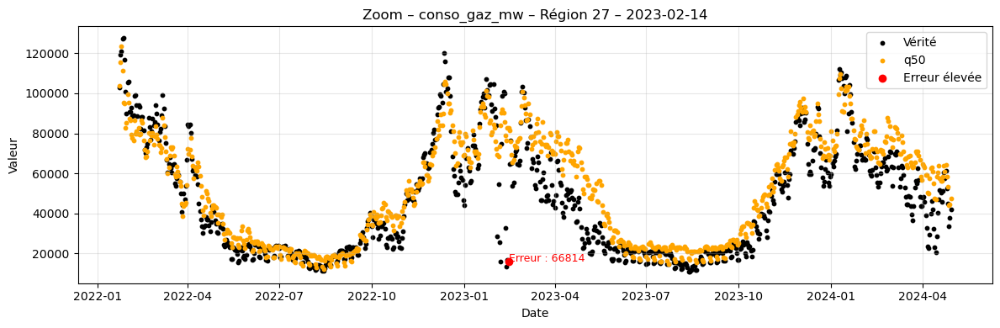

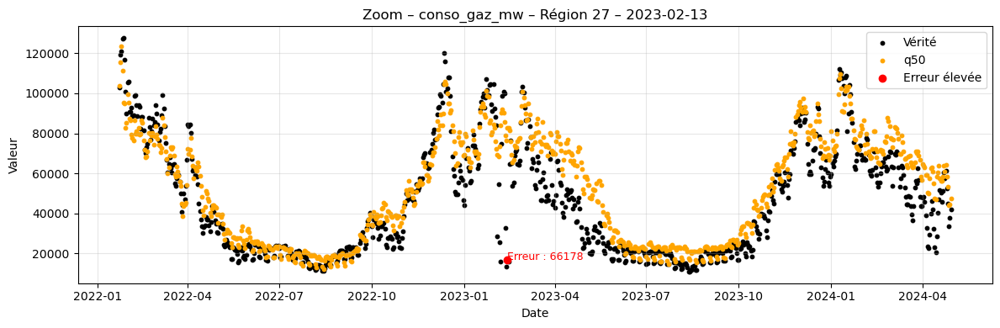

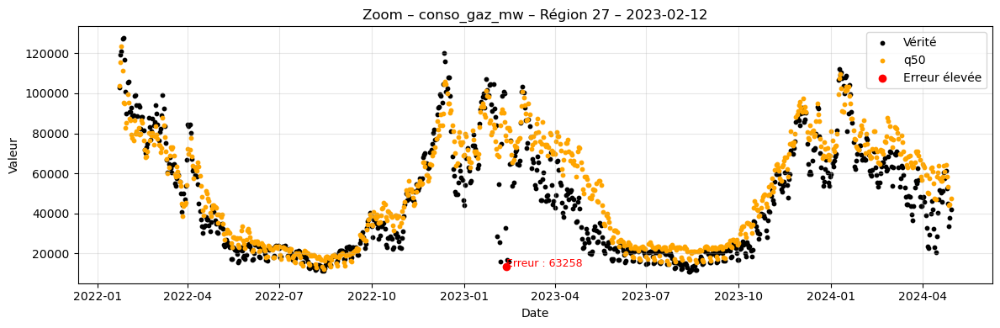

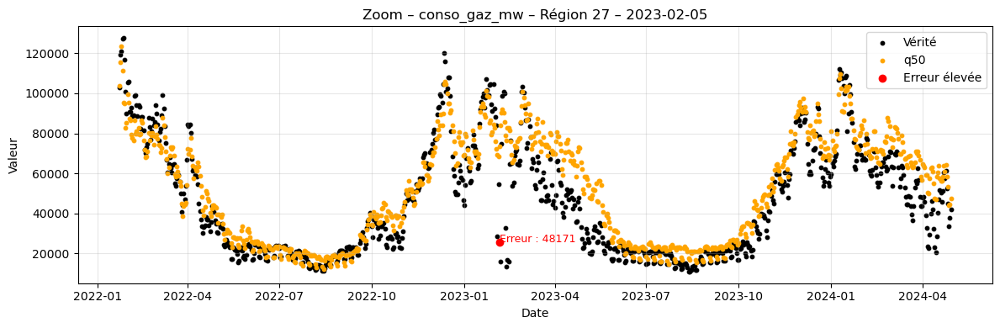


🔥 Top 5 erreurs – conso_gaz_mw – Région 24
           date  conso_gaz_mw           q50        erreur
4551 2023-02-06        5646.0  78750.450425  73104.450425
4635 2023-02-13        5810.0  75171.031509  69361.031509
4623 2023-02-12        5106.0  70524.683972  65418.683972
4647 2023-02-14        6495.0  71873.752969  65378.752969
4611 2023-02-11       19366.0  73419.264787  54053.264787


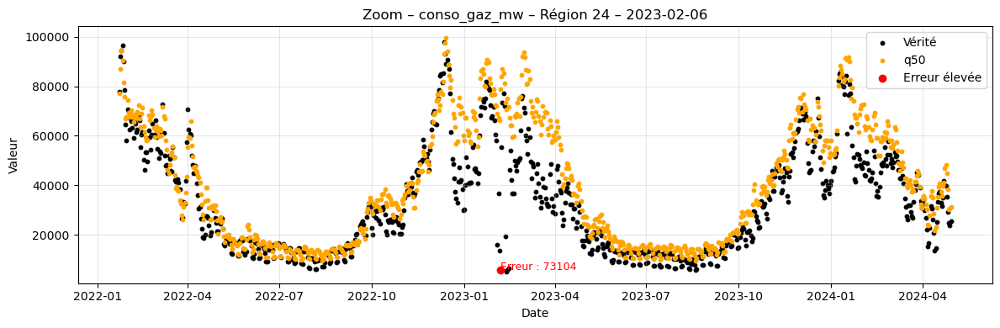

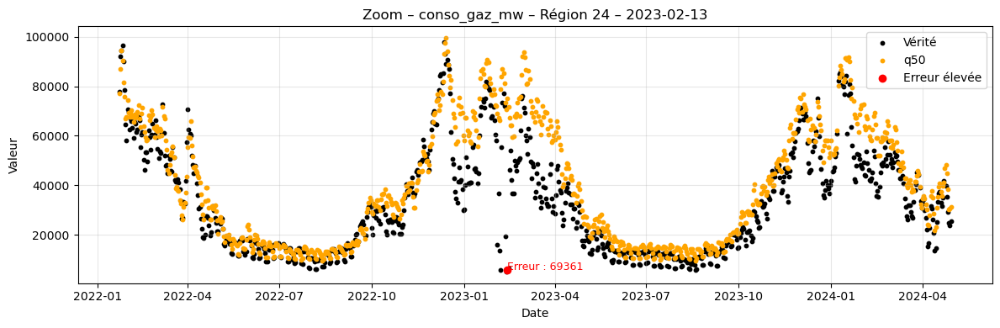

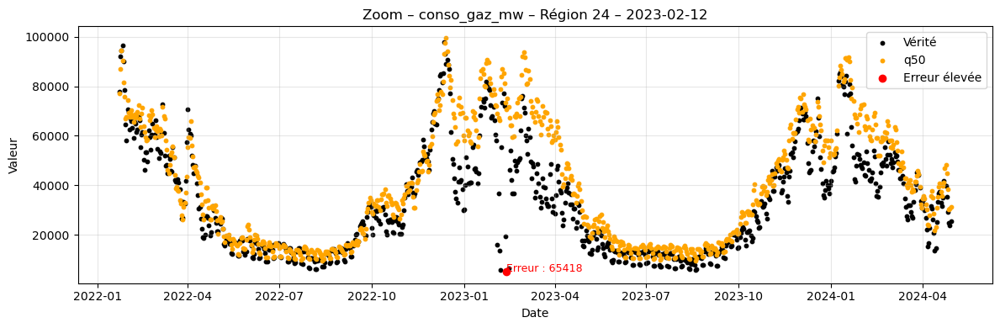

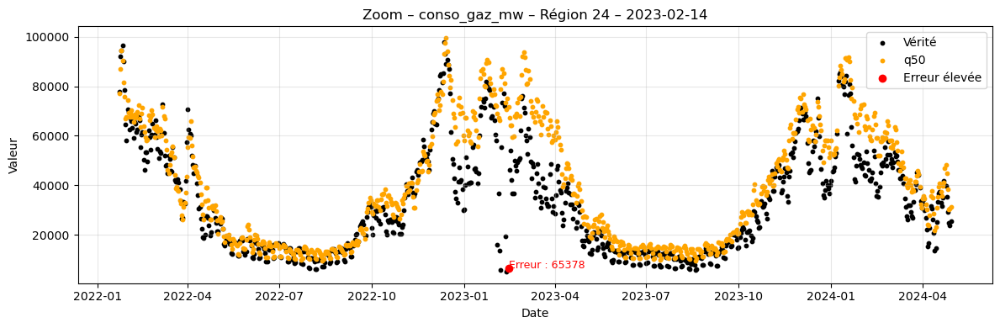

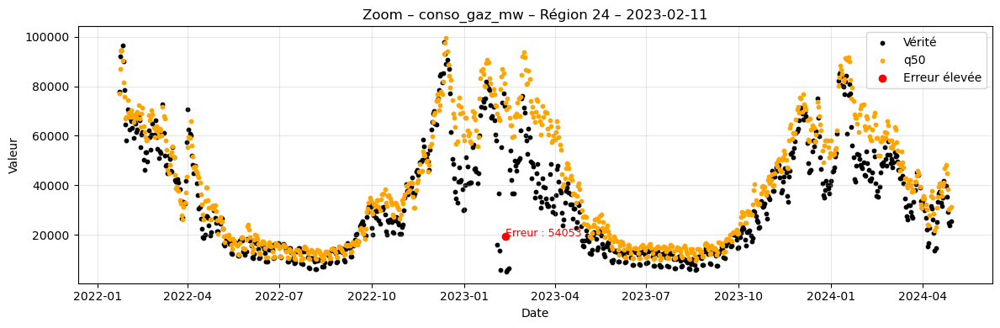


🔥 Top 5 erreurs – conso_gaz_mw – Région 11
           date  conso_gaz_mw            q50         erreur
8596 2024-01-09      479088.0  237669.749811  241418.250189
8583 2024-01-08      454333.0  230851.279705  223481.720295
8608 2024-01-10      469853.0  248531.164895  221321.835105
8620 2024-01-11      462080.0  246031.644699  216048.355301
4371 2023-01-22      415724.0  204993.526948  210730.473052


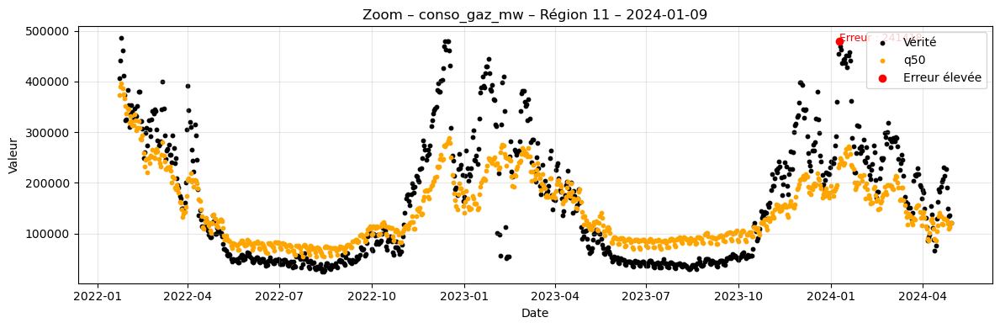

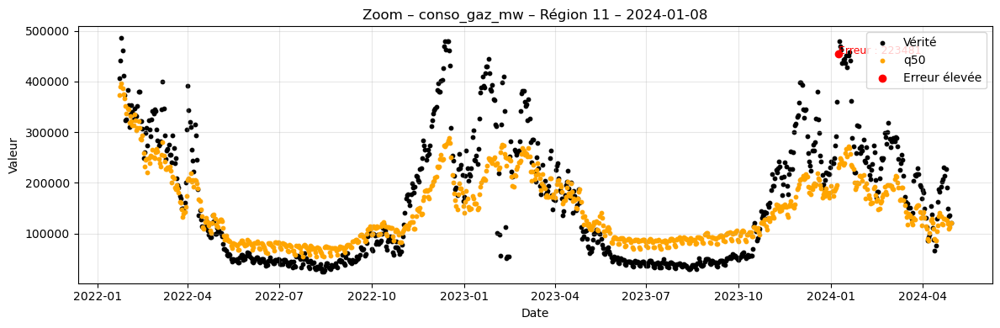

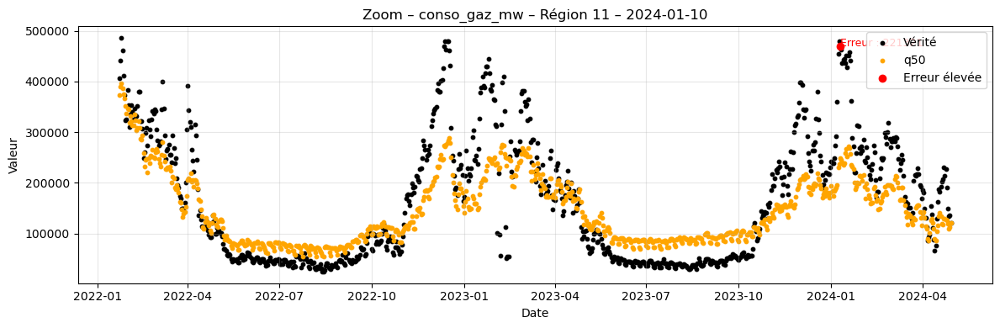

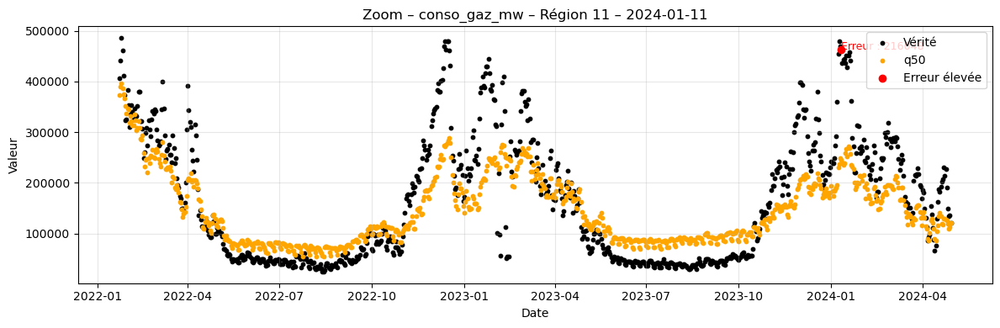

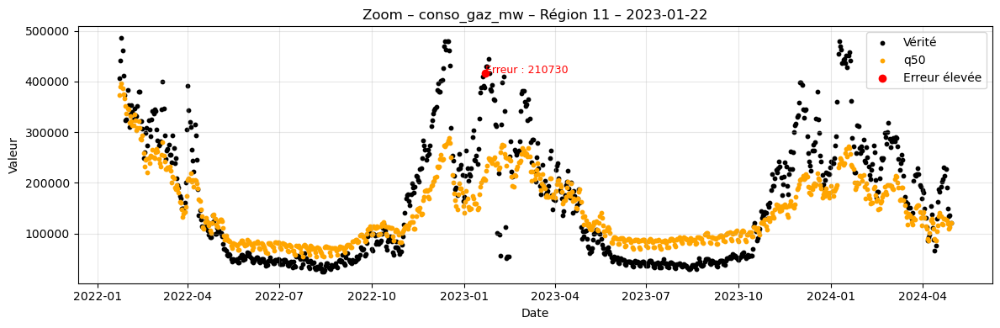


🔥 Top 5 erreurs – conso_gaz_mw – Région 52
           date  conso_gaz_mw            q50         erreur
4642 2023-02-14       25183.0  184851.040874  159668.040874
4630 2023-02-13       29459.0  186416.602375  156957.602375
4546 2023-02-06       25460.0  181308.635922  155848.635922
4618 2023-02-12       24888.0  172422.498649  147534.498649
3994 2022-12-22       56069.0  200578.466466  144509.466466


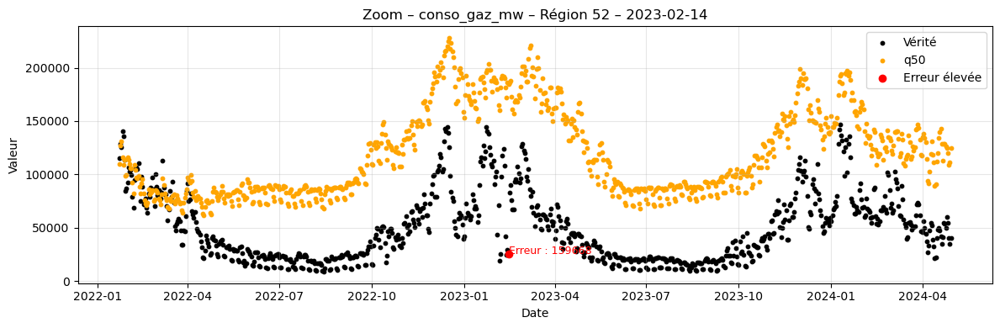

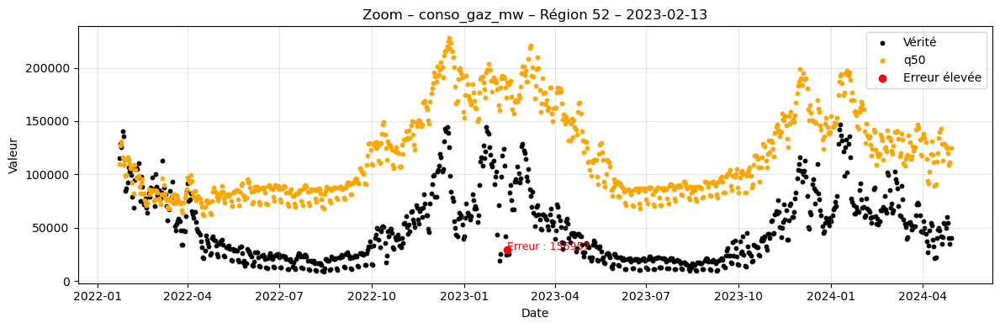

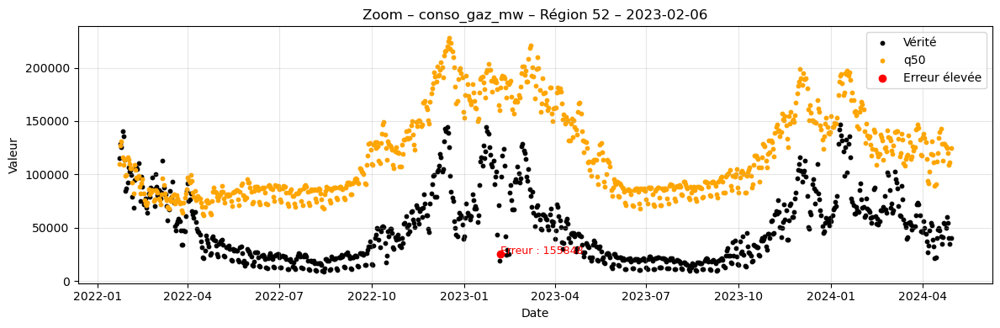

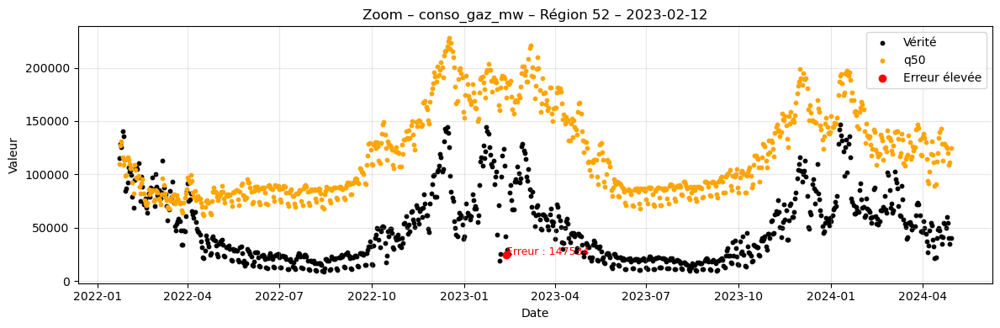

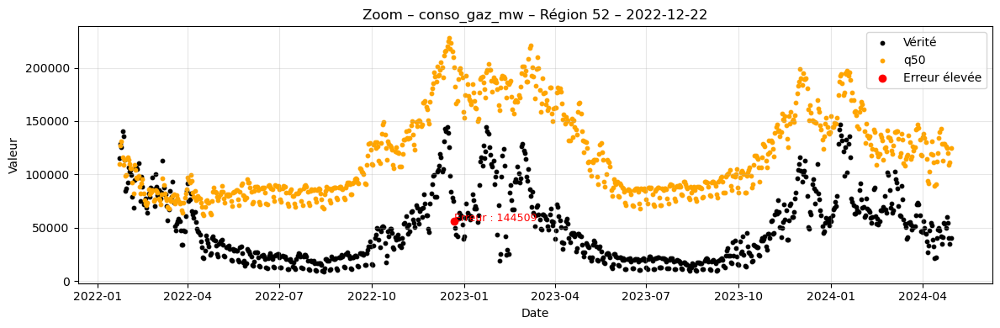


🔥 Top 5 erreurs – conso_gaz_mw – Région 93
           date  conso_gaz_mw            q50        erreur
4445 2023-01-29      192335.0  106274.610806  86060.389194
4436 2023-01-28      194212.0  111985.119428  82226.880572
9294 2024-03-08       95835.0  177410.518329  81575.518329
4422 2023-01-27      205310.0  124770.571443  80539.428557
3857 2022-12-11      197117.0  117158.824325  79958.175675


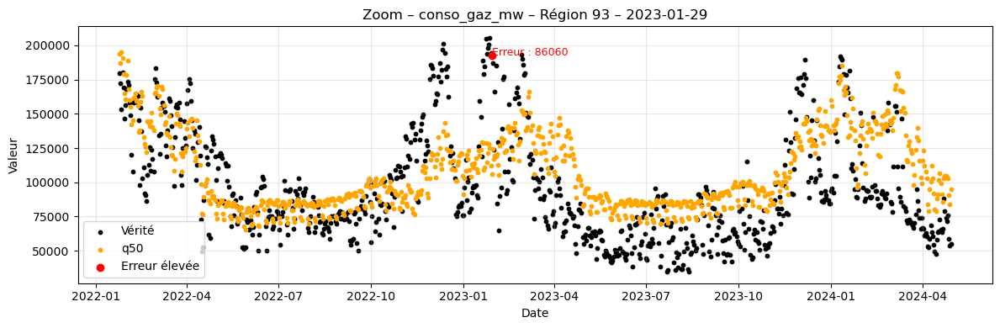

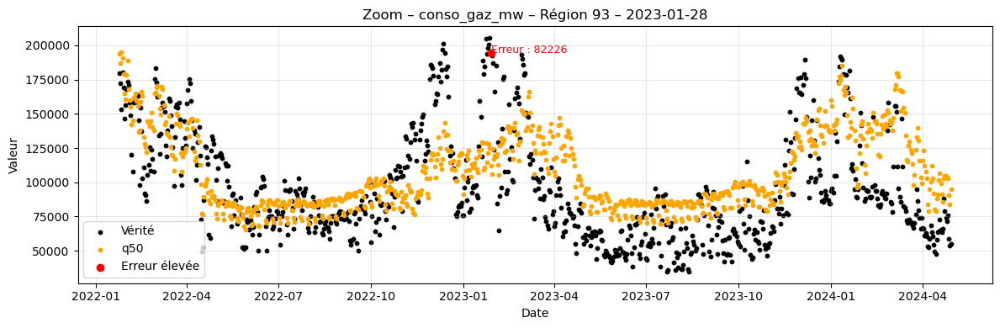

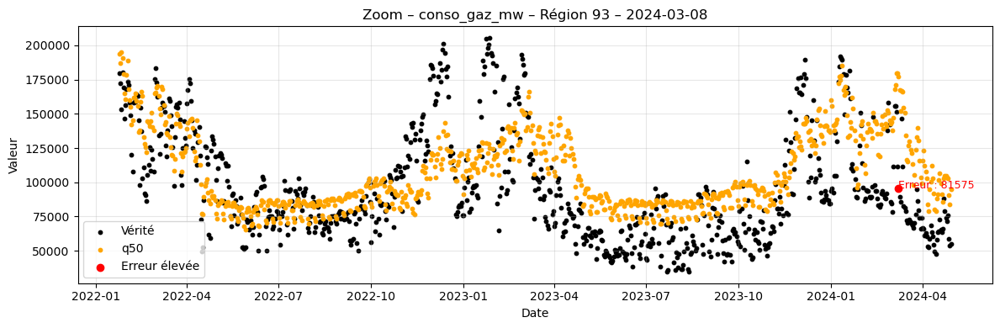

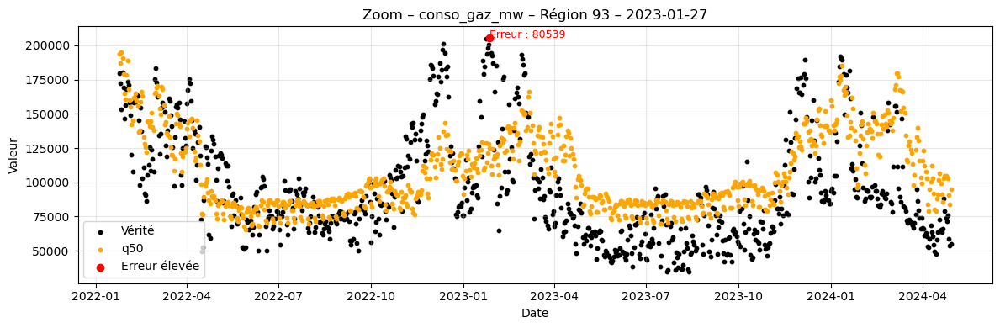

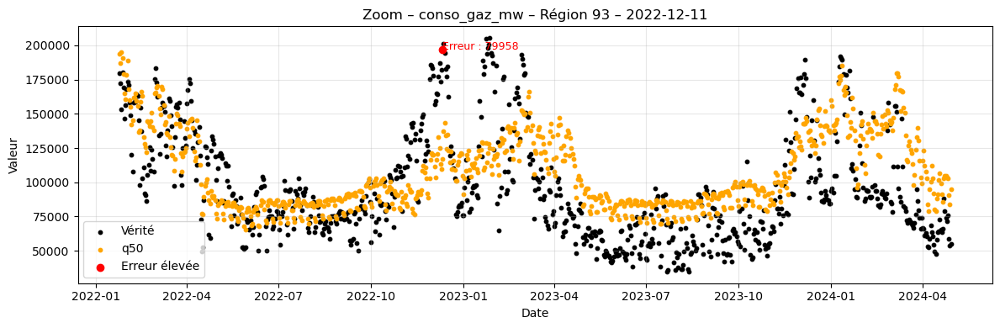


🔥 Top 5 erreurs – conso_gaz_mw – Région 84
           date  conso_gaz_mw            q50         erreur
4614 2023-02-12       40365.0  278060.919979  237695.919979
4542 2023-02-06       53997.0  280593.155855  226596.155855
4626 2023-02-13       53288.0  259582.581439  206294.581439
4603 2023-02-11       93053.0  291234.285466  198181.285466
4638 2023-02-14       52951.0  248900.364751  195949.364751


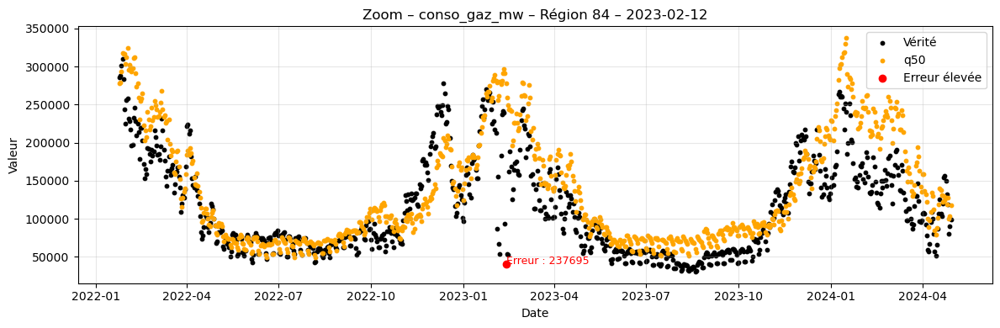

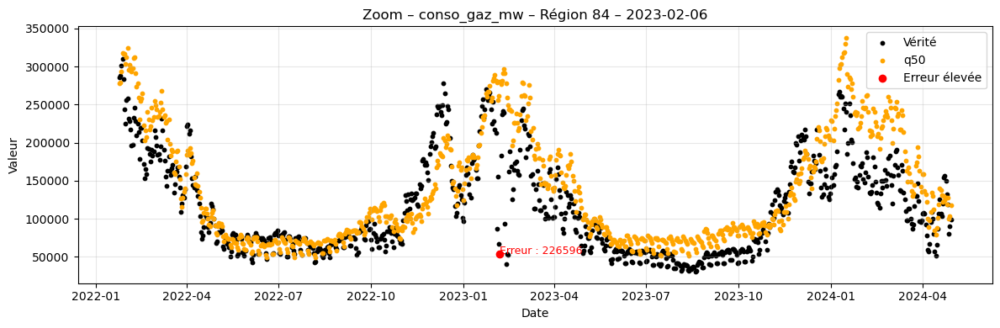

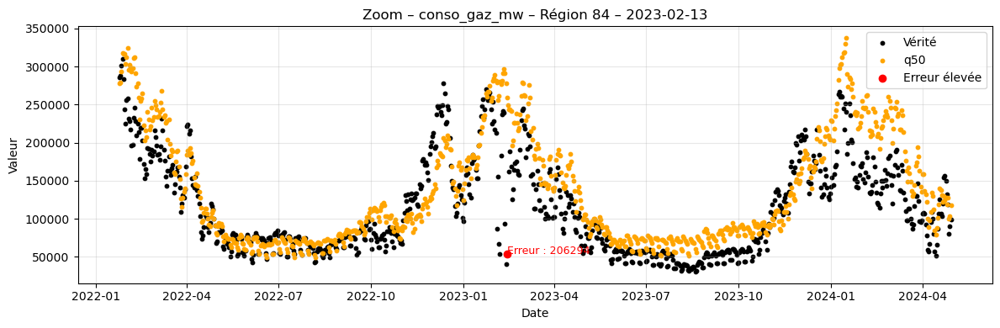

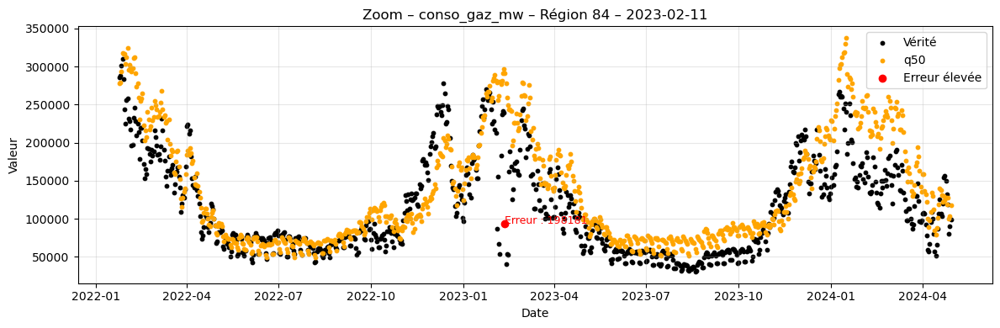

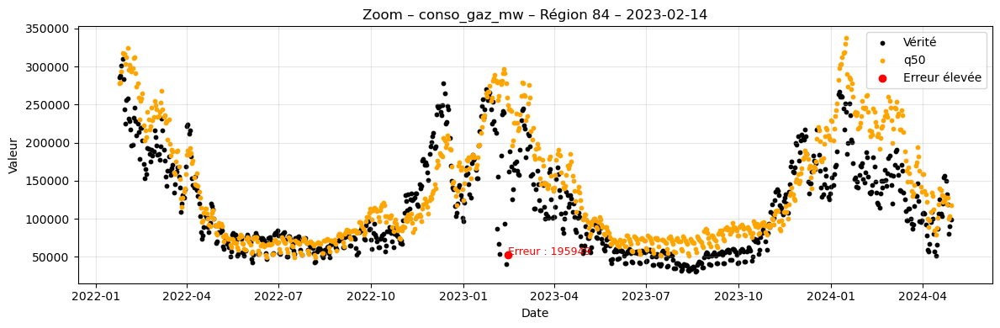


🔥 Top 5 erreurs – conso_gaz_mw – Région 76
          date  conso_gaz_mw            q50         erreur
487 2022-03-05       74754.0  187011.407600  112257.407600
476 2022-03-04       75002.0  185984.995363  110982.995363
511 2022-03-07       90997.0  199572.231922  108575.231922
619 2022-03-16       64464.0  167528.193925  103064.193925
546 2022-03-10       73210.0  176032.105069  102822.105069


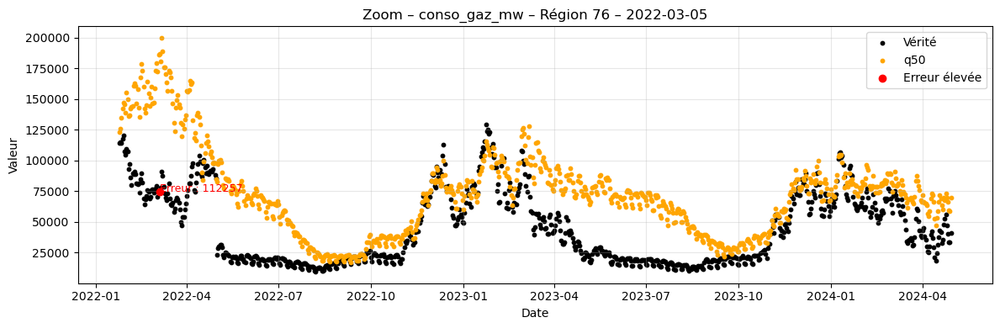

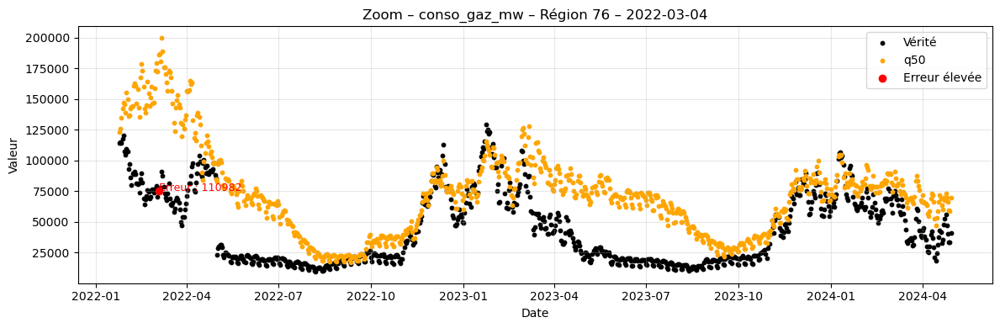

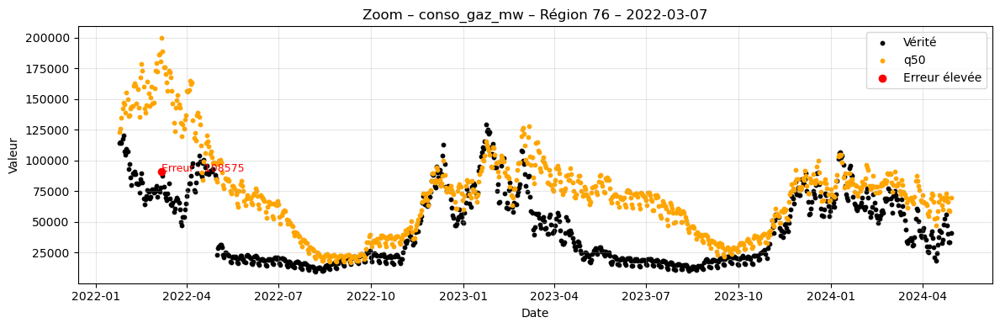

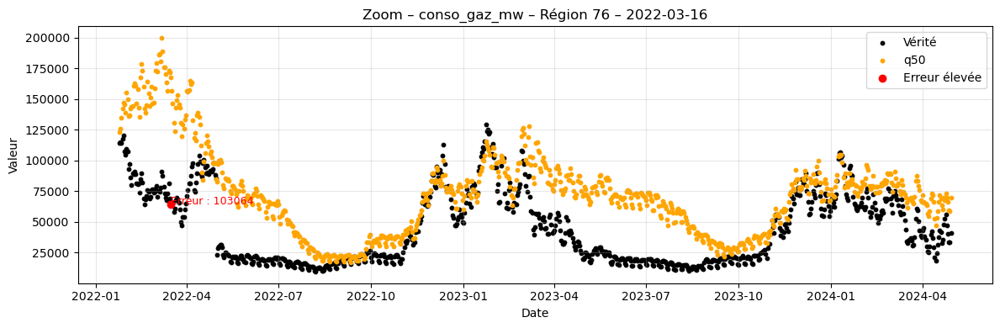

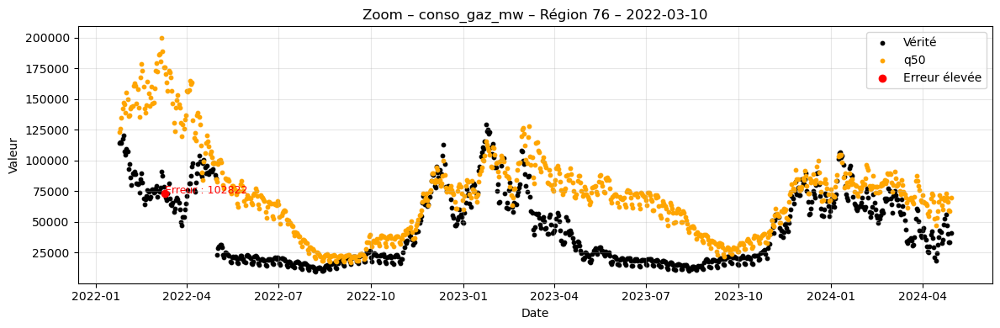


🔥 Top 5 erreurs – conso_gaz_mw – Région 75
          date  conso_gaz_mw            q50        erreur
284 2022-02-16      107677.0  207178.309833  99501.309833
297 2022-02-17       97686.0  195928.297760  98242.297760
524 2022-03-08      123953.0  217392.328922  93439.328922
272 2022-02-15      125527.0  218262.684298  92735.684298
345 2022-02-21      111224.0  201406.153102  90182.153102


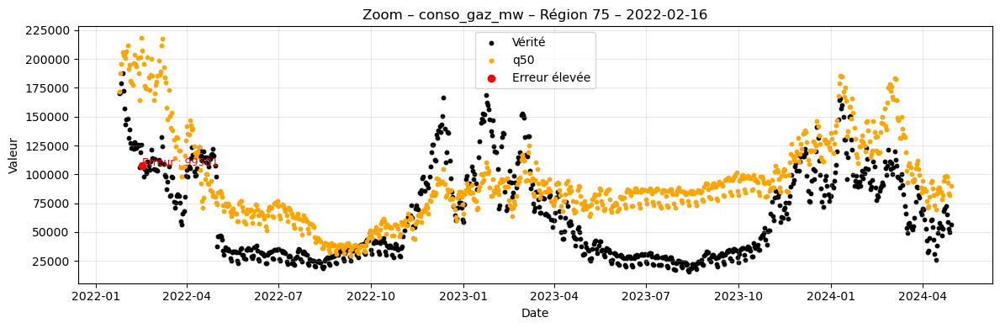

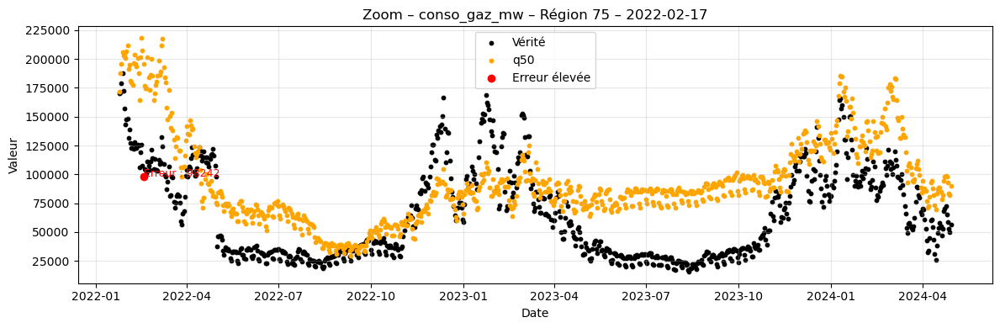

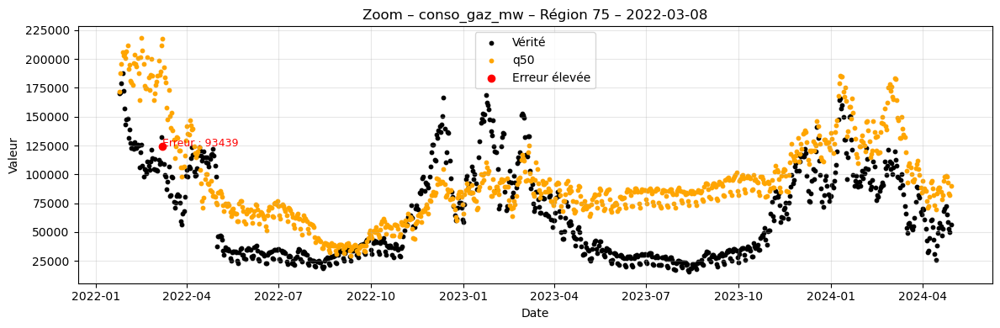

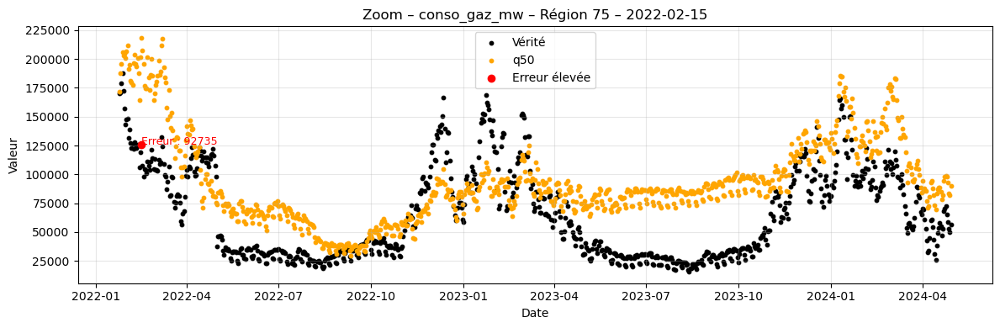

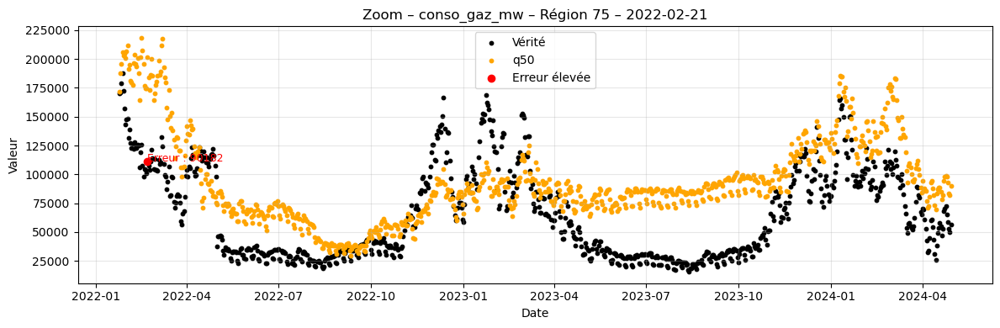


🔥 Top 5 erreurs – conso_gaz_mw – Région 53
           date  conso_gaz_mw           q50        erreur
4545 2023-02-06       24723.0  86093.234473  61370.234473
4629 2023-02-13       24829.0  82663.748334  57834.748334
4641 2023-02-14       24778.0  81240.325008  56462.325008
4617 2023-02-12       19060.0  74406.826455  55346.826455
4529 2023-02-05       20183.0  69511.755875  49328.755875


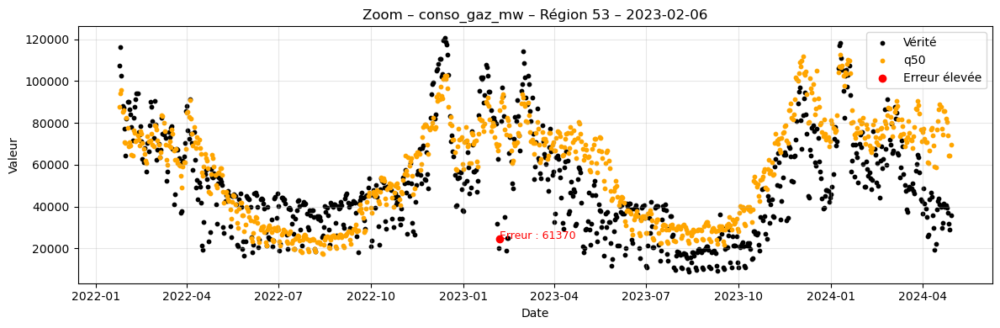

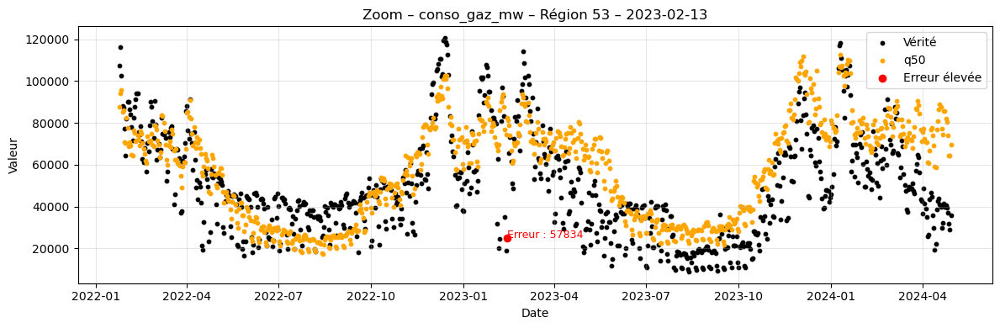

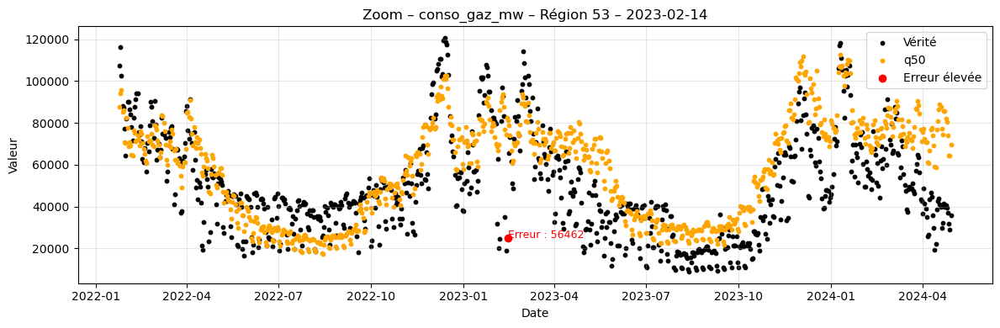

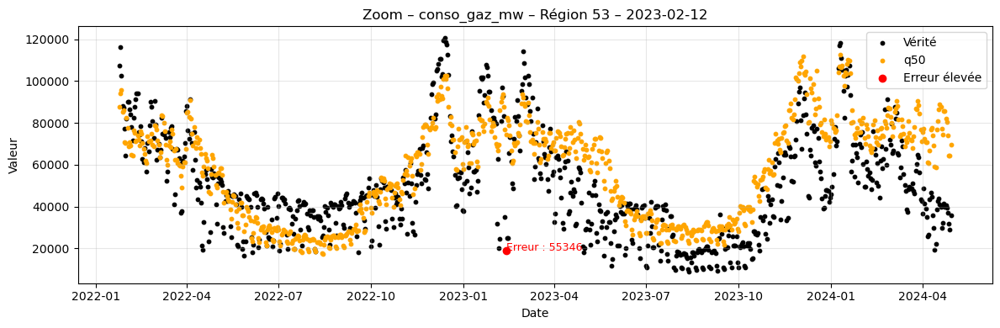

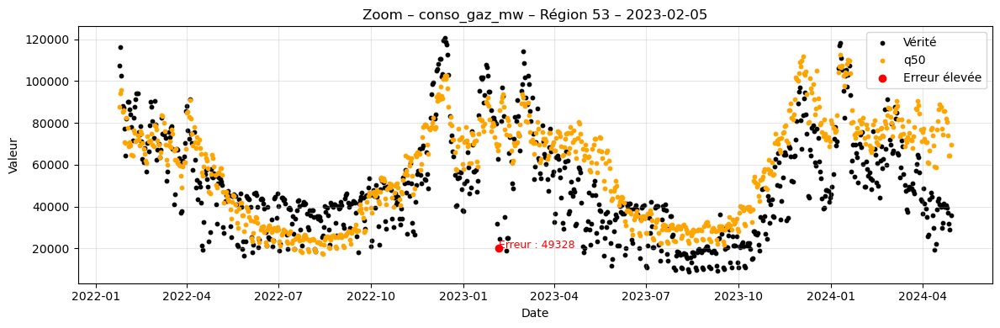


🔥 Top 5 erreurs – conso_gaz_mw – Région 28
           date  conso_gaz_mw            q50         erreur
4633 2023-02-13       69822.0  219921.395462  150099.395462
4645 2023-02-14       69717.0  214815.141608  145098.141608
4621 2023-02-12       68802.0  206880.655448  138078.655448
4549 2023-02-06       72328.0  202499.216955  130171.216955
4609 2023-02-11       85027.0  215005.944242  129978.944242


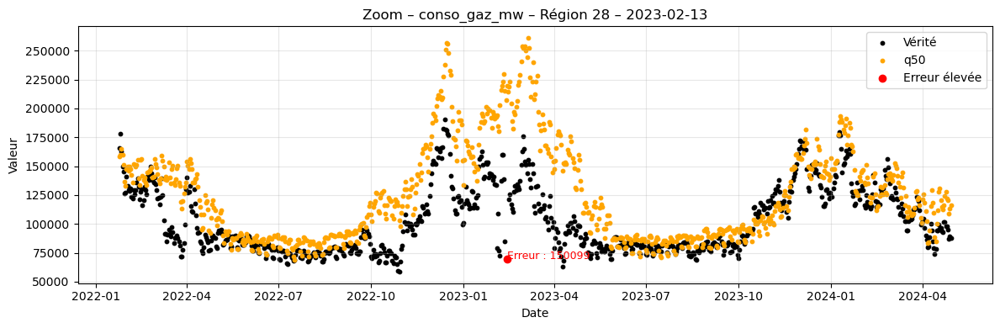

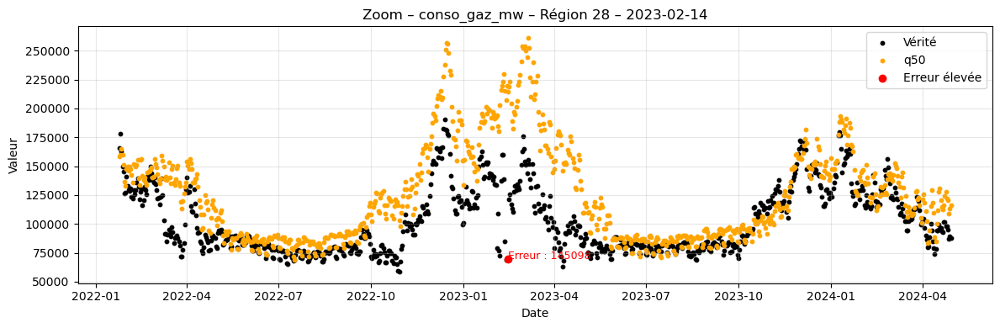

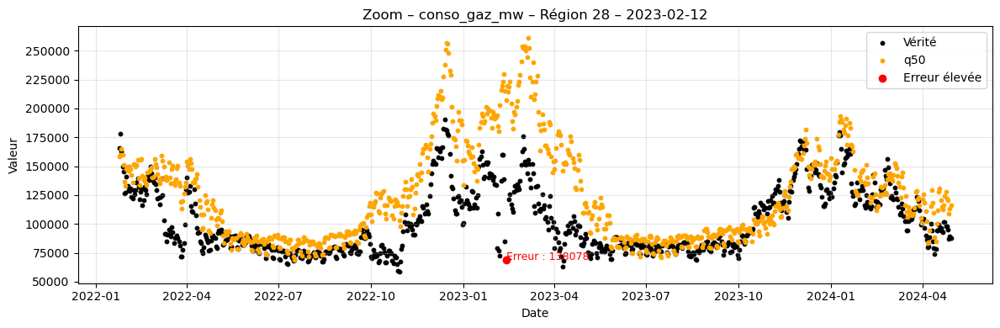

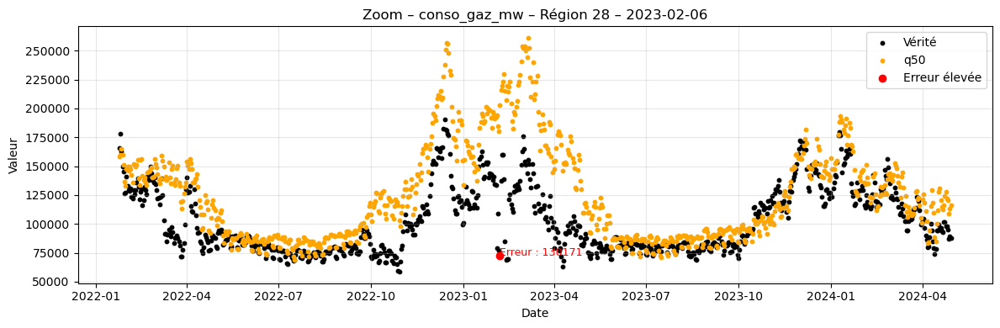

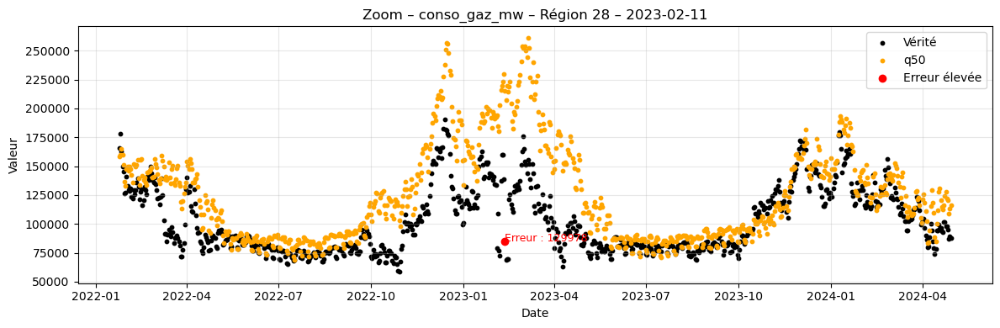


🔥 Top 5 erreurs – conso_gaz_mw – Région 44
           date  conso_gaz_mw            q50         erreur
4643 2023-02-14      144882.0  299582.686324  154700.686324
4547 2023-02-06      139959.0  291983.201940  152024.201940
4619 2023-02-12      128557.0  278670.087537  150113.087537
4535 2023-02-05      112263.0  259737.456354  147474.456354
4631 2023-02-13      143761.0  287371.122790  143610.122790


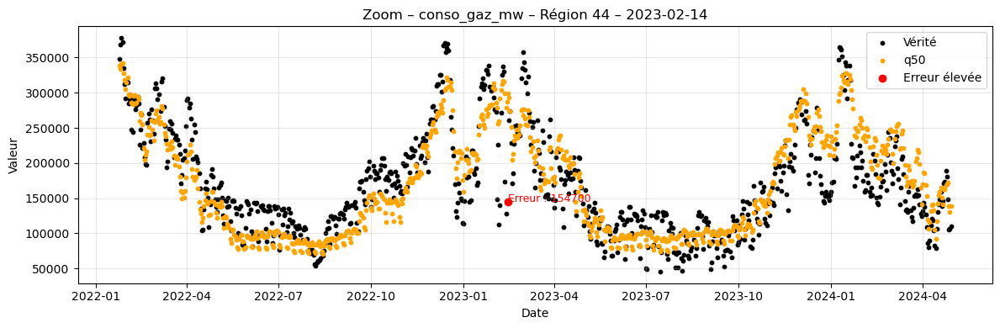

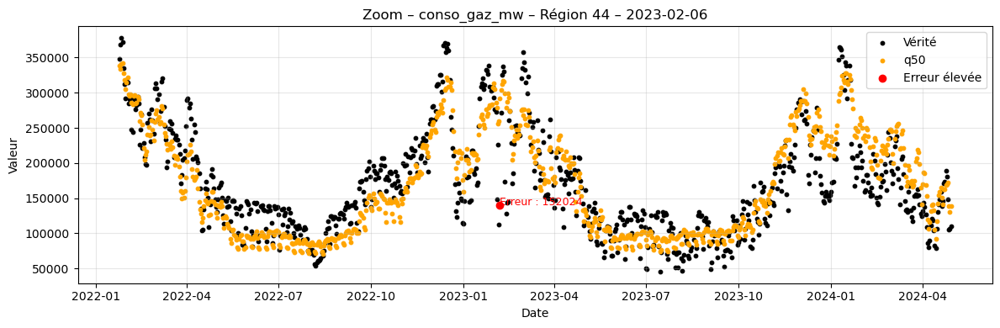

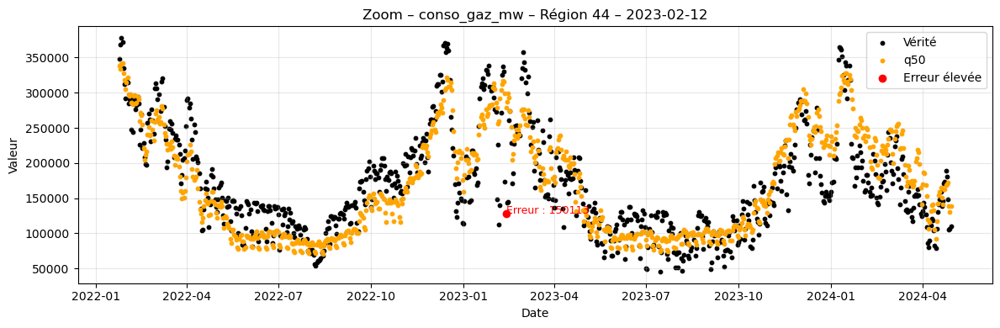

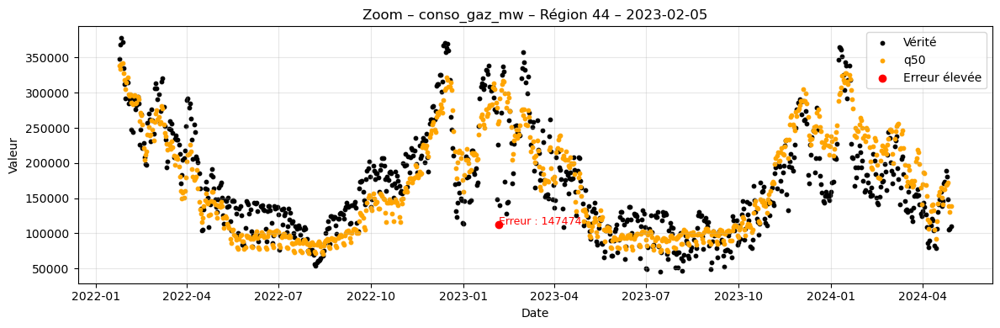

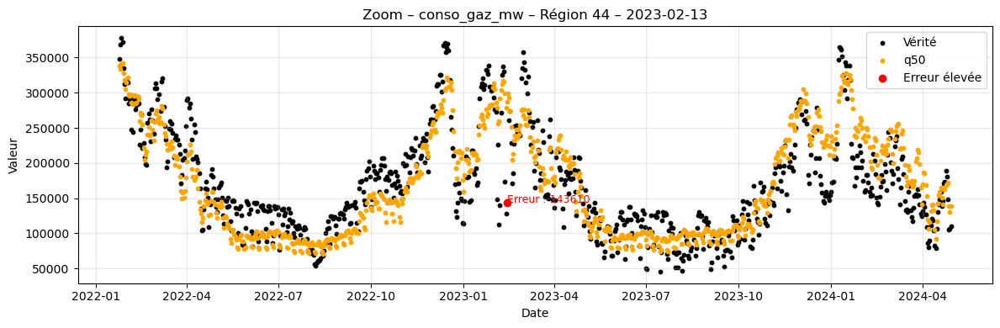

In [ ]:
for target in ["conso_elec_mw", "conso_gaz_mw"]:
    for region in df_visu["insee_region"].unique():
        df_region = df_visu[df_visu["insee_region"] == region].copy()

        try:
            y_true = df_region[target]
            y_pred = df_region[f"{target}_q50"]
            mae = np.abs(y_true - y_pred)

            #  Top 5 erreurs absolues
            top5_idx = mae.nlargest(5).index
            worst_days = df_region.loc[top5_idx, ["date", target]].assign(
                q50=y_pred[top5_idx], erreur=mae[top5_idx]
            )
            print(f"\n🔥 Top 5 erreurs – {target} – Région {region}")
            print(worst_days)

            #  Visualisation avec scatter
            for idx in top5_idx:
                day = df_region.loc[idx, "date"]
                fig, ax = plt.subplots(figsize=(12, 4))

                ax.scatter(df_region["date"], y_true, label="Vérité", color="black", s=10)
                ax.scatter(df_region["date"], y_pred, label="q50", color="orange", s=10)

                ax.scatter(day, y_true.loc[idx], color="red", label="Erreur élevée", zorder=5)
                ax.text(day, y_true.loc[idx], f"Erreur : {int(mae.loc[idx])}", color="red", fontsize=9)

                ax.set_title(f"Zoom – {target} – Région {region} – {day.date()}")
                ax.set_xlabel("Date")
                ax.set_ylabel("Valeur")
                ax.legend()
                ax.grid(alpha=0.3)
                plt.tight_layout()
                plt.show()

        except KeyError as e:
            print(f" Donnée manquante pour {target} dans la région {region} : {e}")